In [1]:
!hostname

gnode014.cluster


In [2]:
!nvidia-smi

Tue Feb  6 11:37:19 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 545.23.08              Driver Version: 545.23.08    CUDA Version: 12.3     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA H100 PCIe               Off | 00000000:A8:00.0 Off |                    0 |
| N/A   32C    P0              49W / 350W |      4MiB / 81559MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [3]:
import itertools as it
import pickle
import torch
import torch.nn as nn
import torch.optim as optim
import torch.fft
import torch.nn.functional as F
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sdeint
from toolbox import (
    make_loss,
    StatLoss,
    SINN,
    FPU
)
import time

In [4]:
torch.cuda.is_available()

True

In [5]:
device = torch.device('cuda')

In [6]:
print(torch.__version__)
print(torch.version.cuda)

2.0.1+cu118
11.8


In [7]:
seed = 1234
torch.set_default_dtype(torch.float)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
np.random.seed(seed)

200.0
(1500, 400) (1500, 400)
(400, 400) (400, 400) (400, 400)
(400, 400, 2)
CPU times: user 1.89 s, sys: 2.77 ms, total: 1.89 s
Wall time: 1.9 s


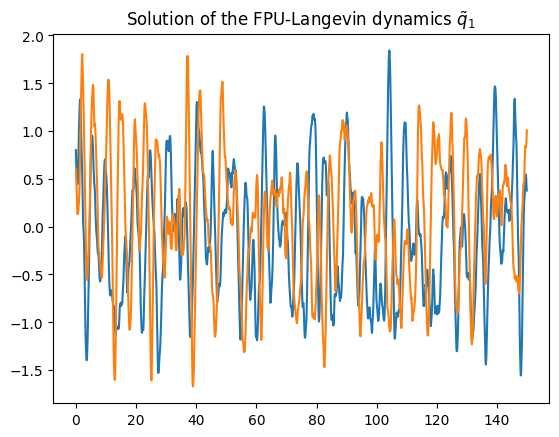

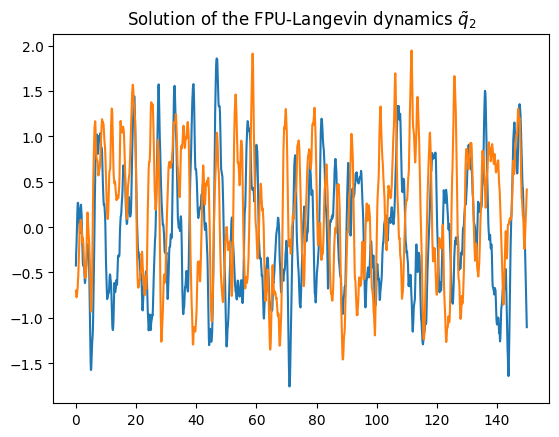

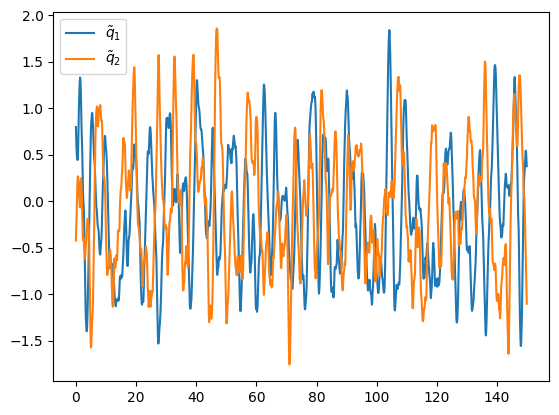

In [8]:
%%time

#### Generating SINN training data by solving SDE (Langevin dynamics)
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from scipy.integrate import quad


def V_FPU(x,U0,x0):
    v=U0/x0**4*x**3+U0/x0**2*x      # FPU potential 
    return v


#### Parameters 
gamma1 = 1                             # coupling constant 
gamma2 = 2                            # coupling constant
beta = 1                               # Inverse temperature, i.e. T=1/beta
dt = 0.01                              # Step-size of the SDE solver 
delta_t = 0.1                          # Step-size of the temporally coarse-grained path
batch = 400                            # Batch size 
sec_length = 400                       # Length of the input sequence 
U0 = 1                                 # FPU parameter, depth of the well 
x0 = 1                                 # FPU parameter, position of the basin 
rho = 0.00                             # Correlation of q1 and q2 

#### SDE solver (EM scheme) 
Time = 5*delta_t*sec_length
print(Time)
length=int(Time/dt)+1
t = np.linspace(0,Time,length) # define time axis
gap=int(delta_t/dt)
t_store=t[0:-1:gap]
q1_store = np.zeros([t_store.size+1,batch])
q2_store = np.zeros([t_store.size+1,batch])
# q_store = np.zeros([t_store.size+1,batch])
p1=np.zeros((2,batch))
p2=np.zeros((2,batch))
q1=np.zeros((2,batch))
q2=np.zeros((2,batch))

# solve SDE
j=1
for i in range(1,length):
     q1[1,:] = q1[0,:] + p1[0,:]*dt
     p1[1,:] = p1[0,:] + (-V_FPU(q1[0,:],U0,x0)-gamma1*p1[0,:])*dt + np.random.randn(1,batch)*np.sqrt(2*dt*gamma1/beta)
     q2[1,:] = q2[0,:] + p2[0,:]*dt
     p2[1,:] = p2[0,:] + (-V_FPU(q2[0,:],U0,x0)-gamma2*p2[0,:])*dt + np.random.randn(1,batch)*np.sqrt(2*dt*gamma2/beta)
     if i % gap ==0:            
            q1_store[j,:]=q1[1,:]
            q2_store[j,:]=rho*q1[1,:]+np.sqrt(1-rho**2)*q2[1,:]
            j=j+1
     p1[0,:]=p1[1,:]
     q1[0,:]=q1[1,:]
     p2[0,:]=p2[1,:]
     q2[0,:]=q2[1,:]

Toss=int(t_store.size/4)         
q1_store=q1_store[Toss:-1,:]         
q2_store=q2_store[Toss:-1,:]    
print(q1_store.shape,q2_store.shape)




plt.figure(0)
for i in range(2):
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,i])
plt.title(r"Solution of the FPU-Langevin dynamics $\tilde{q}_1$")
# plt.savefig("figs/FPU_dt016.pdf", dpi=150)

plt.figure(1)
for i in range(2):
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,i])
plt.title(r"Solution of the FPU-Langevin dynamics $\tilde{q}_2$")

plt.figure(2)
plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0], label=r'$\tilde{q}_1$')
plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0], label=r'$\tilde{q}_2$')
# plt.title("Solution of the FPU-Langevin dynamics")
plt.legend()
# Construct the sample traj for SINN learning 
ini=np.random.randn(sec_length,batch)
Traj_q1=q1_store[0:sec_length,:]
Traj_q2=q2_store[0:sec_length,:]
print(ini.shape, Traj_q1.shape, Traj_q2.shape)

Traj = np.empty((sec_length,batch,2))
Traj[:,:,0] = Traj_q1
Traj[:,:,1] = Traj_q2
T=np.arange(len(Traj_q1[:,1]))*delta_t
x=np.linspace(-5,5,sec_length)
print(Traj.shape)

# 2 input

In [9]:
# Reformulating data into Torch tensors 
# Input of SINN should be of the form (seq_len, batch, input_size)

ini = np.random.randn(2*sec_length,2*batch).astype(np.float32) 
input = torch.from_numpy(ini.reshape(2*sec_length, batch, 2)).to(device)
batch_validation = batch
val_set = torch.normal(0.0, 1.0, (2*sec_length, batch_validation, 2), device=device)


Traj = Traj.astype(np.float32) 
target = torch.from_numpy(Traj.reshape(sec_length, batch, 2)).to(device)
print('The torch input size is', input.size(), input.dtype)
print('The torch validation size is', val_set.size(), val_set.dtype)
print('The torch target size is', target.size(), target.dtype)

The torch input size is torch.Size([800, 400, 2]) torch.float32
The torch validation size is torch.Size([800, 400, 2]) torch.float32
The torch target size is torch.Size([400, 400, 2]) torch.float32


(array([-3., -2., -1.,  0.,  1.,  2.,  3.]),
 [Text(0, -3.0, '−3'),
  Text(0, -2.0, '−2'),
  Text(0, -1.0, '−1'),
  Text(0, 0.0, '0'),
  Text(0, 1.0, '1'),
  Text(0, 2.0, '2'),
  Text(0, 3.0, '3')])

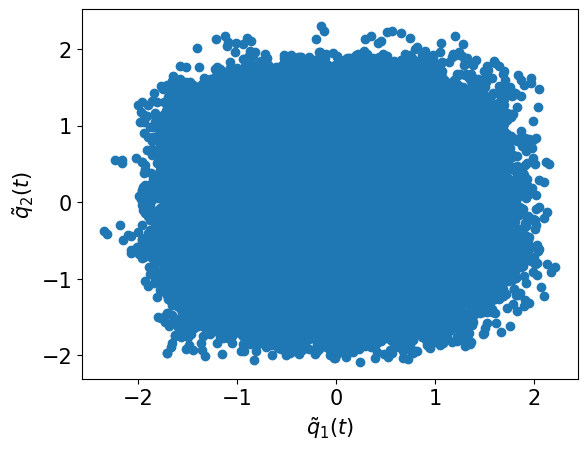

In [10]:
plt.scatter(Traj[:,:,0], Traj[:,:,1])
plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

In [11]:
# Defining Loss functions
LAGS = 400
N = 400
loss_acf_fft = make_loss('acf[fft]', target, lags=LAGS, device=device)
loss_acf_sec_moment = make_loss('acf[fft]', target**2, lags=LAGS, device=device)
loss_acf_bruteforce = make_loss('acf[bruteforce]', target, lags=LAGS, device=device)
loss_acf_randbrute = make_loss('acf[randombrute]', target, lags=LAGS, sample_lags=20, device=device)

loss_ccf_fft = make_loss('ccf[fft]', target, lags=LAGS, device=device)
loss_ccf_sec_moment = make_loss('ccf[fft]', target**2, lags=LAGS, device=device)
loss_ccf_bruteforce = make_loss('ccf[bruteforce]', target, lags=LAGS, device=device)
loss_ccf_randbrute = make_loss('ccf[randombrute]', target, lags=LAGS, sample_lags=20, device=device)

loss_pdf_empirical1 = make_loss('pdf', target, lower=-5, upper=5, n=N, bw=None, device=device)
loss_pdf_empirical2 = make_loss('pdf6', target, lower=-5, upper=5, n=N, bw=None, device=device)
loss_pdf_empirical2D = make_loss('pdf2D', target, lower=-5, upper=5, n=N, bw=None, device=device)

torch.Size([400, 2])


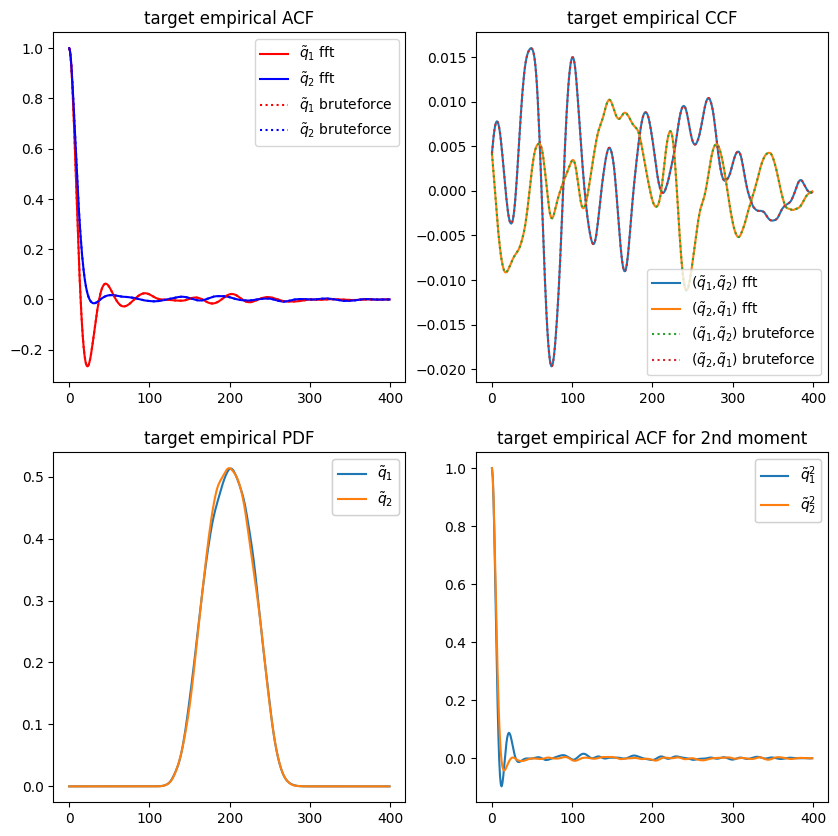

In [12]:
# Plotting target ACFs and PDF
fig, axs = plt.subplots(2, 2, figsize=(10, 10))
axs[0,0].plot(loss_acf_fft._target.cpu()[...,0],'r', label=r'$\tilde{q}_1$ fft')
axs[0,0].plot(loss_acf_fft._target.cpu()[...,-1],'b', label=r'$\tilde{q}_2$ fft')
axs[0,0].plot(loss_acf_bruteforce._target.cpu()[...,0],'r:', label= r'$\tilde{q}_1$ bruteforce')
axs[0,0].plot(loss_acf_bruteforce._target.cpu()[...,1], 'b:', label=r'$\tilde{q}_2$ bruteforce')
axs[0,0].legend()
axs[0,0].set_title('target empirical ACF')

axs[0,1].plot(loss_ccf_fft._target.cpu()[...,0], label=r'($\tilde{q}_1$,$\tilde{q}_2$) fft')
axs[0,1].plot(loss_ccf_fft._target.cpu()[...,1], label=r'($\tilde{q}_2$,$\tilde{q}_1$) fft')
axs[0,1].plot(loss_ccf_bruteforce._target.cpu()[...,0],':',label=r'($\tilde{q}_1$,$\tilde{q}_2$) bruteforce')
axs[0,1].plot(loss_ccf_bruteforce._target.cpu()[...,1],':',label=r'($\tilde{q}_2$,$\tilde{q}_1$) bruteforce')
# legend2 = axs[0,1].legend(iter(bf), ('q bf', 'p bf'), loc=1)
# axs[0,1].add_artist(legend2)
axs[0,1].legend()
axs[0,1].set_title('target empirical CCF')

x_grid=-np.linspace(-5,5,num=sec_length)
pdf = axs[1,0].plot(loss_pdf_empirical1._target.cpu())
legend3 = axs[1,0].legend(iter(pdf), (r'$\tilde{q}_1$', r'$\tilde{q}_2$'), loc=1)
axs[1,0].add_artist(legend3)
axs[1,0].set_title('target empirical PDF')


print(loss_acf_sec_moment._target.cpu().size())
sec_moment = axs[1,1].plot(loss_acf_sec_moment._target.cpu())
legend4 = axs[1,1].legend(iter(sec_moment), (r'$\tilde{q}_1^2$', r'$\tilde{q}_2^2$'),loc=1)
axs[1,1].set_title('target empirical ACF for 2nd moment')
axs[1,1].add_artist(legend4)

plt.show()

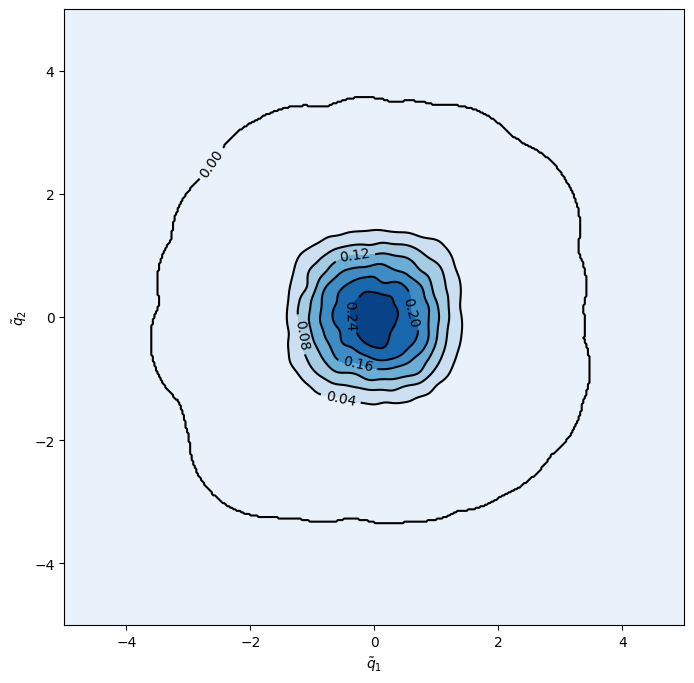

In [13]:
xmin, xmax = -5, 5
ymin, ymax = -5, 5

xx, yy = np.mgrid[xmin:xmax:400j, ymin:ymax:400j]
fig = plt.figure(figsize=(8, 8))
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

# Contourf plot
cfset = ax.contourf(xx, yy, loss_pdf_empirical2D._target.cpu(), cmap='Blues')
## Or kernel density estimate plot instead of the contourf plot

# Contour plot
cset = ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), colors='k')
# Label plot
ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel(r'$\tilde{q}_1$')
ax.set_ylabel(r'$\tilde{q}_2$')

plt.show()

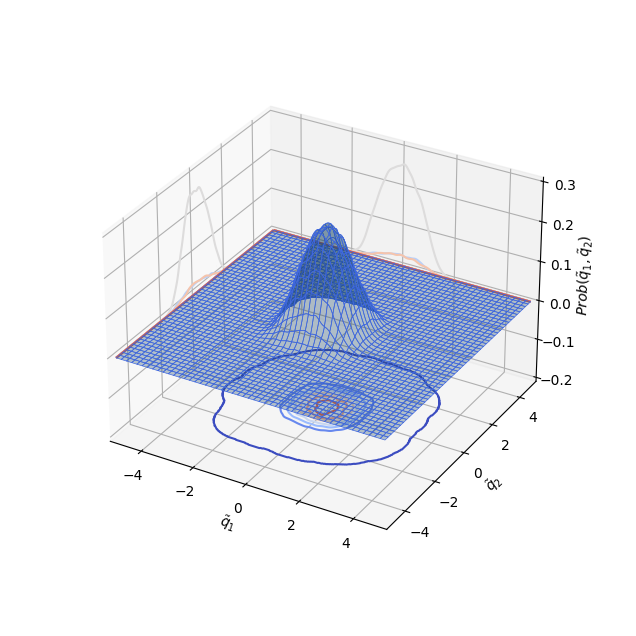

In [14]:
from mpl_toolkits.mplot3d import axes3d

ax = plt.figure(figsize=(8, 8)).add_subplot(projection='3d')
# fig = plt.figure()
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
ax.plot_surface(xx, yy, loss_pdf_empirical2D._target.cpu(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='z', offset=-0.2, cmap='coolwarm')
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='x', offset=-5, cmap='coolwarm')
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='y', offset=5, cmap='coolwarm')

ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'$Prob(\tilde{q}_1,\tilde{q}_2)$')
ax.set_box_aspect(aspect=None, zoom=0.8)
plt.show()

Text(0.5, 1.0, 'target empirical PDF')

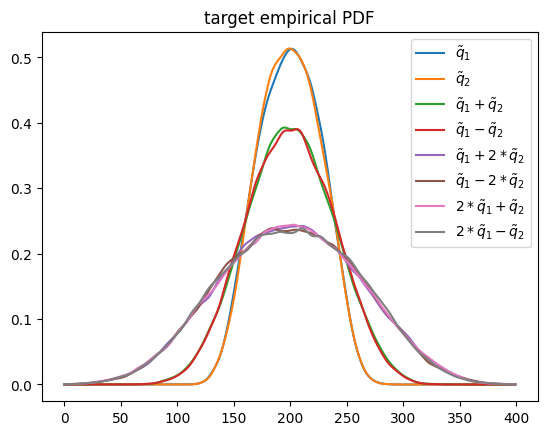

In [15]:
x_grid=-np.linspace(-5,5,num=sec_length)
plt.plot(loss_pdf_empirical1._target.cpu()[...,0],label=r'$\tilde{q}_1$')
plt.plot(loss_pdf_empirical1._target.cpu()[...,1],label=r'$\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,0],label=r'$\tilde{q}_1+\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,1],label=r'$\tilde{q}_1-\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,2],label=r'$\tilde{q}_1+2*\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,3],label=r'$\tilde{q}_1-2*\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,4],label=r'$2*\tilde{q}_1+\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,5],label=r'$2*\tilde{q}_1-\tilde{q}_2$')
plt.legend()
plt.title('target empirical PDF')

## 1.3. Loss function=CCF($\textbf{x}$)+PDF($\textbf{x}$)+ACF($\textbf{x}^2$)

In [16]:
class Model:
    def __init__(self, net):

        self.x_acf_s = None
        self.x_ccf_s = None
        self.x_pdf_s = None
        self.x_pdf2_s = None
        self.x_acf2_s = None
        self.s_collect = []

        self.net = net

        self.T_error=[]
        self.V_error=[]
        self.T_ccf=[]
        self.V_ccf=[]
        self.T_pdf=[]
        self.V_pdf=[]
        self.T_pdf2=[]
        self.V_pdf2=[]
        self.T_acf=[]
        self.V_acf=[]
        self.T_acf2=[]
        self.V_acf2=[]
        self.Step=[]
        self.iter = 0
        self.time = 0

    def train_U(self, x):
        return self.net(x)

    def predict_U(self, x):
        return self.train_U(x)

    def likelihood_loss(self, loss_acf, loss_ccf, loss_pdf, loss_pdf2, loss_acf2):
        loss = torch.reciprocal(2. * self.x_acf_s ** 2) * loss_acf.detach()      \
               + torch.reciprocal(2. * self.x_ccf_s ** 2) * loss_ccf.detach()    \
               + torch.reciprocal(2. * self.x_pdf_s ** 2) * loss_pdf.detach()    \
               + torch.reciprocal(2. * self.x_pdf2_s ** 2) * loss_pdf2.detach()  \
               + torch.reciprocal(2. * self.x_acf2_s ** 2) * loss_acf2.detach()  \
               + torch.log(self.x_acf_s * self.x_ccf_s * self.x_pdf_s * self.x_pdf2_s * self.x_acf2_s)
        return loss

    def true_loss(self, loss_acf, loss_ccf, loss_pdf, loss_pdf2, loss_acf2):
        return torch.reciprocal(2. * self.x_acf_s.detach() ** 2) * loss_acf + torch.reciprocal(2. * self.x_ccf_s.detach() ** 2) * loss_ccf + torch.reciprocal(2. * self.x_pdf_s.detach() ** 2) * loss_pdf + torch.reciprocal(2. * self.x_pdf2_s.detach() ** 2) * loss_pdf2 + torch.reciprocal(2. * self.x_acf2_s.detach() ** 2) * loss_acf2

    def run_baseline(self):
        optimizer_adam = optim.Adam(self.net.parameters(), lr=1e-3)
        for step in range(20000):
            optimizer_adam.zero_grad()
            ini = np.random.randn(2*sec_length, batch*self.net.lstm.input_size).astype(np.float32) 
            input = torch.from_numpy(ini.reshape(2*sec_length, batch, self.net.lstm.input_size)).to(device)
            prediction, _ = self.train_U(input)
            prediction = prediction[-LAGS:,:,:]
            loss = loss_acf_fft(prediction)+ loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
            loss.backward()
            optimizer_adam.step()
            self.iter += 1
            if step % 50 == 0: 
                with torch.no_grad():
                    loss = loss_acf_fft(prediction)+loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
                    pred_val, _ = self.predict_U(val_set)
                    pred_val = pred_val[-LAGS:,:,:]
                    loss_val = loss_acf_bruteforce(pred_val)+loss_ccf_bruteforce(pred_val)+ loss_pdf_empirical1(pred_val)+ loss_pdf_empirical2(pred_val) + loss_acf_sec_moment(pred_val**2)
                    acf = loss_acf_bruteforce(pred_val)
                    ccf = loss_ccf_bruteforce(pred_val)
                    pdf = loss_pdf_empirical1(pred_val)
                    pdf2 = loss_pdf_empirical2(pred_val)
                    acf_sec_moment = loss_acf_sec_moment(pred_val**2)
                    print('[%d]-th step loss: %.4f, %.4f, acf: %.5f, ccf: %.5f, pdf: %.5f, pdf2: %.5f, acf2: %.5f' % (step, loss, loss_val, acf, ccf, pdf, pdf2, acf_sec_moment))
                    self.T_acf.append(loss_acf_fft(prediction).detach().cpu().numpy())
                    self.V_acf.append(loss_acf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_ccf.append(loss_ccf_fft(prediction).detach().cpu().numpy())
                    self.V_ccf.append(loss_ccf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_pdf.append(loss_pdf_empirical1(prediction).detach().cpu().numpy())
                    self.V_pdf.append(loss_pdf_empirical1(pred_val).detach().cpu().numpy())
                    self.T_pdf2.append(loss_pdf_empirical2(prediction).detach().cpu().numpy())
                    self.V_pdf2.append(loss_pdf_empirical2(pred_val).detach().cpu().numpy())
                    self.T_acf2.append(loss_acf_sec_moment(prediction**2).detach().cpu().numpy())
                    self.V_acf2.append(loss_acf_sec_moment(pred_val**2).detach().cpu().numpy())
                    self.T_error.append(loss.detach().cpu().numpy())
                    self.V_error.append(loss_val.detach().cpu().numpy())
                    self.Step.append(step)
            if loss <=0.0003 and loss_val <=0.0003:
                break

        if loss > 0.0003 and loss_val > 0.0003:
            print ('Training failed')
        print('Training finished')



    def run_AW(self):
        self.x_acf_s = nn.Parameter(self.x_acf_s, requires_grad=True)
        self.x_ccf_s = nn.Parameter(self.x_ccf_s, requires_grad=True)
        self.x_pdf_s = nn.Parameter(self.x_pdf_s, requires_grad=True)
        self.x_pdf2_s = nn.Parameter(self.x_pdf2_s, requires_grad=True)
        self.x_acf2_s = nn.Parameter(self.x_acf2_s, requires_grad=True)


        optimizer_adam = optim.Adam(self.net.parameters(), lr=1e-3)
        optimizer_adam_weight = optim.Adam([self.x_acf_s] + [self.x_ccf_s] + [self.x_pdf_s] + [self.x_pdf2_s] + [self.x_acf2_s],
                                                     lr=1e-3)

        for step in range(20000):
            self.s_collect.append([self.iter, self.x_acf_s.item(), self.x_ccf_s.item(), self.x_pdf_s.item(), self.x_pdf2_s.item(), self.x_acf2_s.item()])

            optimizer_adam.zero_grad()
            ini = np.random.randn(2*sec_length, batch*self.net.lstm.input_size).astype(np.float32) 
            input = torch.from_numpy(ini.reshape(2*sec_length, batch, self.net.lstm.input_size)).to(device)
            prediction, _ = self.train_U(input)
            prediction = prediction[-LAGS:,:,:]
            loss = self.true_loss(loss_acf_fft(prediction), loss_ccf_fft(prediction),loss_pdf_empirical1(prediction),loss_pdf_empirical2(prediction),loss_acf_sec_moment(prediction**2))
            loss.backward()
            optimizer_adam.step()
            self.iter += 1
            if step % 50 == 0: 
                with torch.no_grad():
                    loss = loss_acf_fft(prediction)+loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
                    pred_val, _ = self.predict_U(val_set)
                    pred_val = pred_val[-LAGS:,:,:]
                    loss_val = loss_acf_bruteforce(pred_val)+loss_ccf_bruteforce(pred_val)+ loss_pdf_empirical1(pred_val) + loss_pdf_empirical2(pred_val) + loss_acf_sec_moment(pred_val**2)
                    acf = loss_acf_bruteforce(pred_val)
                    ccf = loss_ccf_bruteforce(pred_val)
                    pdf = loss_pdf_empirical1(pred_val)
                    pdf2 = loss_pdf_empirical2(pred_val)
                    acf_sec_moment = loss_acf_sec_moment(pred_val**2)
                    print('[%d]-th step loss: %.4f, %.4f, acf: %.5f, ccf: %.5f, pdf: %.5f, pdf2: %.5f, acf2: %.5f' % (step, loss, loss_val, acf, ccf, pdf, pdf2, acf_sec_moment))
                    self.T_acf.append(loss_acf_fft(prediction).detach().cpu().numpy())
                    self.V_acf.append(loss_acf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_ccf.append(loss_ccf_fft(prediction).detach().cpu().numpy())
                    self.V_ccf.append(loss_ccf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_pdf.append(loss_pdf_empirical1(prediction).detach().cpu().numpy())
                    self.V_pdf.append(loss_pdf_empirical1(pred_val).detach().cpu().numpy())
                    self.T_pdf2.append(loss_pdf_empirical2(prediction).detach().cpu().numpy())
                    self.V_pdf2.append(loss_pdf_empirical2(pred_val).detach().cpu().numpy())
                    self.T_acf2.append(loss_acf_sec_moment(prediction**2).detach().cpu().numpy())
                    self.V_acf2.append(loss_acf_sec_moment(pred_val**2).detach().cpu().numpy())
                    self.T_error.append(loss.detach().cpu().numpy())
                    self.V_error.append(loss_val.detach().cpu().numpy())
                    self.Step.append(step)
            if loss <=0.0003 and loss_val <=0.0003:
                break
            optimizer_adam_weight.zero_grad()
            loss = self.likelihood_loss(loss_acf_fft(prediction), loss_ccf_fft(prediction),loss_pdf_empirical1(prediction),loss_pdf_empirical2(prediction),loss_acf_sec_moment(prediction**2))
            loss.backward()
            optimizer_adam_weight.step()
            
        if loss > 0.0003 and loss_val > 0.0003:
            print ('Training failed')
        print('Training finished')


    def train(self):
        self.x_acf_s = torch.tensor(2.).float()
        self.x_ccf_s = torch.tensor(2.).float()
        self.x_pdf_s = torch.tensor(2.).float()
        self.x_pdf2_s = torch.tensor(2.).float()
        self.x_acf2_s = torch.tensor(2.).float()
        start_time = time.time()
        if model_type == 0:
            self.run_baseline()
        elif model_type == 1:
            self.run_AW()
        elapsed = time.time() - start_time
        self.time = elapsed
        print('Training time: %.2f' % elapsed)
        avg_time = elapsed/self.iter
        print('Training time per iteration: %.2f' % avg_time)
        print('Number of Iterations:%d' %self.iter)

In [17]:
def draw_loss(model):
    ### Plotting the training and the generalization error
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Error plot",fontsize=15) 
    plt.yscale('log')
    plt.plot(model.Step, model.T_error,'r',label='Training error')
    plt.plot(model.Step, model.V_error,'b--',label='Validation error')
#     plt.loglog(model.Step, model.T_error,'r',label='Training error')
#     plt.loglog(model.Step, model.V_error,'b--',label='Validation error')
    plt.xlabel(r'Training times $n$',fontsize=15)
    plt.ylabel(r'$l_1+l_2$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)

In [18]:
def draw_errors(model):
    ### Plotting the training and the generalization error
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Error plot for loss functions w/o coeff",fontsize=15)
    plt.yscale('log')
    plt.plot(model.Step, model.T_error,'k',label='Training error')
    plt.plot(model.Step, model.V_error,'k--')
    plt.plot(model.Step, model.T_acf,'r',label='acf error')
    plt.plot(model.Step, model.V_acf,'r--')
    plt.plot(model.Step, model.T_ccf,'b',label='ccf error')
    plt.plot(model.Step, model.V_ccf,'b--')
    plt.plot(model.Step, model.T_pdf,'y',label='pdf error')
    plt.plot(model.Step, model.V_pdf,'y--')
    plt.plot(model.Step, model.T_pdf2,'m',label=r'$pdf_{combo}$ error')
    plt.plot(model.Step, model.V_pdf2,'m--')
    plt.plot(model.Step, model.T_acf2,'g',label=r'$acf(\tilde{q}^2)$ error')
    plt.plot(model.Step, model.V_acf2,'g--')
    
#     plt.loglog(model.Step, model.T_error,'k',label='Training error')
#     plt.loglog(model.Step, model.V_error,'k--')
#     plt.loglog(model.Step, model.T_acf,'r',label='acf error')
#     plt.loglog(model.Step, model.V_acf,'r--')
#     plt.loglog(model.Step, model.T_ccf,'b',label='ccf error')
#     plt.loglog(model.Step, model.V_ccf,'b--')
#     plt.loglog(model.Step, model.T_pdf,'y',label='pdf error')
#     plt.loglog(model.Step, model.V_pdf,'y--')
#     plt.loglog(model.Step, model.T_pdf2,'m',label='pdf2 error')
#     plt.loglog(model.Step, model.V_pdf2,'m--')
#     plt.loglog(model.Step, model.T_acf2,'g',label='acf2 error')
#     plt.loglog(model.Step, model.V_acf2,'g--')
    plt.xlabel(r'Training times $n$',fontsize=15)
    plt.ylabel(r'$l_1+l_2$',fontsize=15)
    plt.legend(frameon=False,fontsize=15, bbox_to_anchor=(1.1, 1.05))

In [19]:
def draw_adaptive_w(model):
    s_collect = np.array(model.s_collect)
    np.savetxt('s_RAM-AW.npy', s_collect)
    plt.plot(s_collect[:, 0], s_collect[:, 1], 'r-', label=r'$\epsilon_{acf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 2], 'b-', label='$\epsilon_{ccf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 3], 'y-', label='$\epsilon_{pdf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 4], 'g-', label='$\epsilon_{acf2}$')
    plt.plot(s_collect[:, 0], s_collect[:, 5], 'c-', label='$\epsilon_{ccf2}$')
    plt.xlabel('$Iters$')
    plt.ylabel('$s$')
    plt.legend()
    plt.show()

In [20]:
def draw_epoch_w(model):
    s_collect = np.array(model.s_collect)
    np.savetxt('s_RAM-AW.npy', s_collect)
    plt.yscale('log')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 1]**2), 'r-', label=r'$\frac{1}{2\epsilon_{acf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 2]**2), 'b-', label=r'$\frac{1}{2\epsilon_{ccf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 3]**2), 'y-', label=r'$\frac{1}{2\epsilon_{pdf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 4]**2), 'g-', label=r'$\frac{1}{2\epsilon_{acf2}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 5]**2), 'c-', label=r'$\frac{1}{2\epsilon_{ccf2}^2}$')
    plt.xlabel('$Iters$')
    plt.ylabel('$\omega$')
    plt.legend()
#     plt.savefig('2dpossion_S_RAM-AW.pdf')
    plt.show()

In [21]:
def test1(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    # Test 1: plot the sample path generated by SINN and the exact sample path 
    skip = 0

    fig = plt.figure(0)
    plt.title("MD trajectories",fontsize=15) 
    plt.plot(T[skip:]-T[skip], Traj[skip:, 0])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$ and $\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15) 


    fig = plt.figure(1)
    plt.title("SINN trajectories",fontsize=15)    
    plt.plot(T[skip:]-T[skip], prediction[skip:, 0])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$q_1(t)$ and $q_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [22]:
def test2(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    
    # Test 2: plot the CCF of the sample path generated by the SINN and the exact CCF  
    acf_p=StatLoss.acf(Pred[-sec_length:,:,:])
    acf_t=StatLoss.acf(target)
    corr_p1=acf_p.detach().cpu().numpy()
    corr_t1=acf_t.detach().cpu().numpy()
    ccf_p=StatLoss.ccf(Pred[-sec_length:,:,:])
    ccf_t=StatLoss.ccf(target)
    corr_p2=ccf_p.detach().cpu().numpy()
    corr_t2=ccf_t.detach().cpu().numpy()
    
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_1$',fontsize=15)    
    plt.plot(T, corr_t1[...,0],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, corr_p1[...,0], 'b--',label='SINN')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_2$',fontsize=15)          
    plt.plot(T, corr_t1[...,-1],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, corr_p1[...,-1], 'b--',label='SINN')     # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized CCF',fontsize=15)    
    plt.plot(T, corr_t2[:,:],'r')        # correlation function of the target 
    plt.plot(T, corr_p2[:,:], 'b--')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.ylim(-0.05,0.05)

In [23]:
def test3(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    
    # Test 3: plot the PDF of the sample path generated by SINN and the exact PDF  
    rho_data =  StatLoss.gauss_kde(target, -5, 5, 400, None).cpu()
    rho_input = StatLoss.gauss_kde(ran_input, -5, 5, 400, None).cpu()
    rho_prediction = StatLoss.gauss_kde(Pred[-sec_length:,:,:].detach(), -5, 5, 400,None).cpu()
    
    rho_data2 =  StatLoss.gauss_kde6(target, -5, 5, 400, None).cpu()
    rho_prediction2 = StatLoss.gauss_kde6(Pred[-sec_length:,:,:].detach(), -5, 5, 400,None).cpu()


    x=np.linspace(-5, 5, 400)
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function",fontsize=15)    
    plt.plot(x, rho_data.numpy()[...,0],label=r'Exact PDF of $\tilde{q}_1$')    # target PDF
    plt.plot(x, rho_data.numpy()[...,1],label=r'Exact PDF of $\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction.numpy()[...,0], ':',label=r'PDF of the output $\tilde{q}_1$')  # PDF after the training 
    plt.plot(x, rho_prediction.numpy()[...,1], ':',label=r'PDF of the output $\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,0],label=r'Exact PDF of $\tilde{q}_1+\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,1],label=r'Exact PDF of $\tilde{q}_2-\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,0], ':',label=r'PDF of the output $\tilde{q}_1+\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,1], ':',label=r'PDF of the output $\tilde{q}_1-\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,2],label=r'Exact PDF of $\tilde{q}_1+2\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,3],label=r'Exact PDF of $\tilde{q}_2-2\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,2], ':',label=r'PDF of the output $\tilde{q}_1+2\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,3], ':',label=r'PDF of the output $\tilde{q}_1-2\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    fig = plt.figure(3)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,4],label=r'Exact PDF of $2\tilde{q}_1+\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,5],label=r'Exact PDF of $2\tilde{q}_2-\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,4], ':',label=r'PDF of the output $2\tilde{q}_1+\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,5], ':',label=r'PDF of the output $2\tilde{q}_1-\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [24]:
def test4(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    # Test 4: Comparing the higher-order ACF
    acf2=StatLoss.acf(target**2)
    pred_norm=torch.from_numpy((prediction).reshape(sec_length, batch,2))
    acf2_app=StatLoss.acf(pred_norm**2)

    
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_1^2$',fontsize=15)    
    plt.plot(T, acf2.detach().cpu().numpy()[...,0],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, acf2_app.detach().cpu().numpy()[...,0], 'b--',label='SINN')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_2^2$',fontsize=15)          
    plt.plot(T, acf2.detach().cpu().numpy()[...,1],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, acf2_app.detach().cpu().numpy()[...,1], 'b--',label='SINN')     # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()    

In [25]:
def test5(model):
    # Test 5: plot the expolation result, i.e. Prediction of the FPU-Langevin dynamics for longer time 
    [a,b,c]=input.size()
    skip=20
    scale=10
    burnin=3
    fold=800
    batch_new=50
    ran_input=torch.randn(((scale-burnin)*a,batch_new,c),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred_L, _= model.predict_U(ran_input)
    prediction_ext=Pred_L.detach().cpu().numpy().reshape((scale-burnin)*a, batch_new,2)
    ccf_p=StatLoss.ccf(Pred_L,method='bruteforce')

    LT=np.linspace(0,(scale-burnin)*a*delta_t,num=(scale-burnin)*a+1)
    LT=LT[0:-1]


    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Short-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 0],'--',label='SINN simulation')
    plt.xlim([0,80])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)



    fig = plt.figure(figsize=(16, 4))
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Long-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 0],'--',label='SINN simulation')
    plt.xlim([0,500])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)

    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Short-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 1],'--',label='SINN simulation')
    plt.xlim([0,80])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)



    fig = plt.figure(figsize=(16, 4))
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Long-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 1],'--',label='SINN simulation')
    plt.xlim([0,500])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)

In [26]:
def test6(model):
    # Test 6: scatter plot of SINN
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    fig = plt.figure(0)
    plt.title("MD trajectories",fontsize=15) 
    plt.scatter(Traj[:,:,0], Traj[:,:,1])
    plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15) 


    fig = plt.figure(1)
    plt.title("SINN trajectories",fontsize=15)    
    plt.scatter(prediction[:,:,0],prediction[:,:,1])
    plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [27]:
def test7(model):
    # Test 5: scatter plot of SINN
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    rho_data =  StatLoss.gauss_kde2D(target, -5, 5, 400, None).cpu()
    rho_prediction = StatLoss.gauss_kde2D(Pred[-sec_length:,:,:].detach(), -5, 5, 400, None).cpu()
    
    fig = plt.figure(0, figsize=(5, 5))
    plt.title("PDF Contours",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

    xx, yy = np.mgrid[xmin:xmax:400j, ymin:ymax:400j]
    axs[0]  = fig.gca()
    plt.xlim(xmin, xmax)
    plt.ylim(ymin, ymax)
    
    plt.contour(xx,yy,rho_data.numpy(),colors='r')
    plt.contour(xx,yy,rho_prediction.numpy(),colors='b',linestyles='dashed')

    plt.xlabel(r'$\tilde{q}_1$')
    plt.ylabel(r'$\tilde{q}_2$')

    
    
    fig = plt.figure(1,figsize=(5, 5))
    plt.title("MD trajectories",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

    ax  = fig.gca()
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    cfset = ax.contourf(xx, yy, rho_data.numpy(), cmap='Blues')
    cset = ax.contour(xx, yy, rho_data.numpy(), colors='k')

    ax.clabel(cset, inline=1, fontsize=10)
    ax.set_xlabel(r'$\tilde{q}_1$')
    ax.set_ylabel(r'$\tilde{q}_2$')
    
    fig = plt.figure(2,figsize=(5, 5))
    plt.title("SINN output",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

#     xx, yy = np.mgrid[xmin:xmax:20j, ymin:ymax:20j]
    ax  = fig.gca()
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    cfset = ax.contourf(xx, yy, rho_prediction.numpy(), cmap='Blues')
    cset = ax.contour(xx, yy, rho_prediction.numpy(), colors='k')

    ax.clabel(cset, inline=1, fontsize=10)
    ax.set_xlabel(r'$\tilde{q}_1$')
    ax.set_ylabel(r'$\tilde{q}_2$')

    
    
    fig = plt.figure(3,figsize=(5, 5))
    ax = plt.figure().add_subplot(projection='3d')
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
    ax.plot_surface(xx, yy, rho_data.numpy(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
    ax.contour(xx, yy, rho_data.numpy(), zdir='z', offset=-0.2, cmap='coolwarm')
    ax.contour(xx, yy, rho_data.numpy(), zdir='x', offset=-5, cmap='coolwarm')
    ax.contour(xx, yy, rho_data.numpy(), zdir='y', offset=5, cmap='coolwarm')

    ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'Prob($\tilde{q}_1$,$\tilde{q}_2$)')
    ax.set_box_aspect(aspect=None, zoom=0.8)

    
    
    
    

    
    
    
    fig = plt.figure(4,figsize=(5, 5))
    ax = plt.figure().add_subplot(projection='3d')
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
    ax.plot_surface(xx, yy, rho_prediction.numpy(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='z', offset=-0.2, cmap='coolwarm')
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='x', offset=-5, cmap='coolwarm')
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='y', offset=5, cmap='coolwarm')

    ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'Prob($\tilde{q}_1$,$\tilde{q}_2$)')
    ax.set_box_aspect(aspect=None, zoom=0.8)

# baseline SINN

In [28]:
model_type = 0

In [29]:
### Defining SINN model
net = SINN(2, 10, 2, 2).to(device)

In [30]:
model = Model(net=net)

In [31]:
model.train()

[0]-th step loss: 0.5350, 0.5326, acf: 0.01067, ccf: 0.00142, pdf: 0.24759, pdf2: 0.26982, acf2: 0.00308
[50]-th step loss: 0.2346, 0.2266, acf: 0.00441, ccf: 0.00015, pdf: 0.15316, pdf2: 0.06806, acf2: 0.00084
[100]-th step loss: 0.0631, 0.0616, acf: 0.00739, ccf: 0.00030, pdf: 0.03101, pdf2: 0.01869, acf2: 0.00423
[150]-th step loss: 0.0234, 0.0238, acf: 0.00397, ccf: 0.00129, pdf: 0.00711, pdf2: 0.00989, acf2: 0.00152
[200]-th step loss: 0.0100, 0.0104, acf: 0.00192, ccf: 0.00108, pdf: 0.00280, pdf2: 0.00421, acf2: 0.00037
[250]-th step loss: 0.0064, 0.0064, acf: 0.00145, ccf: 0.00041, pdf: 0.00156, pdf2: 0.00272, acf2: 0.00027
[300]-th step loss: 0.0050, 0.0049, acf: 0.00127, ccf: 0.00023, pdf: 0.00102, pdf2: 0.00208, acf2: 0.00029
[350]-th step loss: 0.0040, 0.0039, acf: 0.00116, ccf: 0.00016, pdf: 0.00068, pdf2: 0.00163, acf2: 0.00030
[400]-th step loss: 0.0033, 0.0033, acf: 0.00104, ccf: 0.00014, pdf: 0.00047, pdf2: 0.00127, acf2: 0.00033
[450]-th step loss: 0.0027, 0.0028, acf:

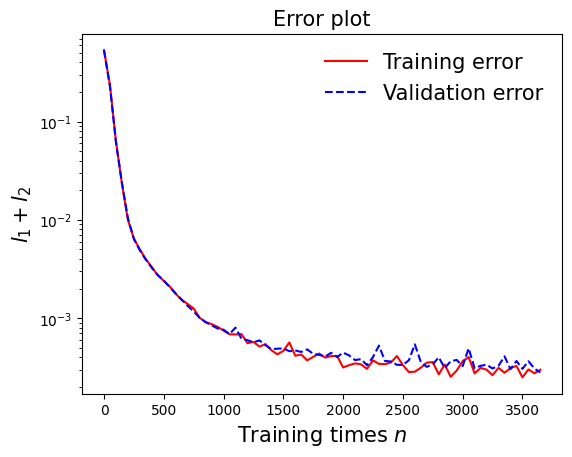

In [32]:
draw_loss(model)

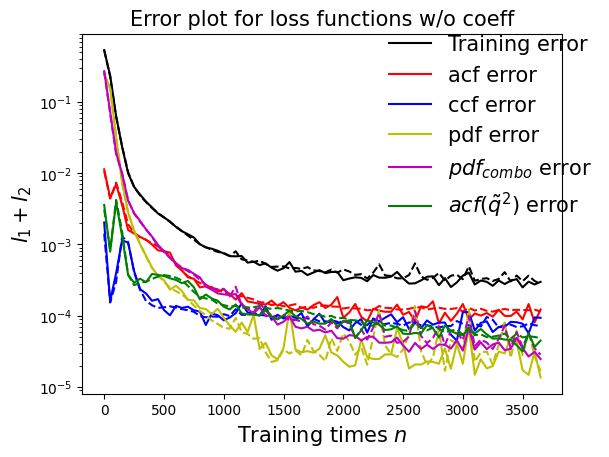

In [33]:
draw_errors(model)

## Test 1: plot the sample path generated by SINN and the exact sample path 

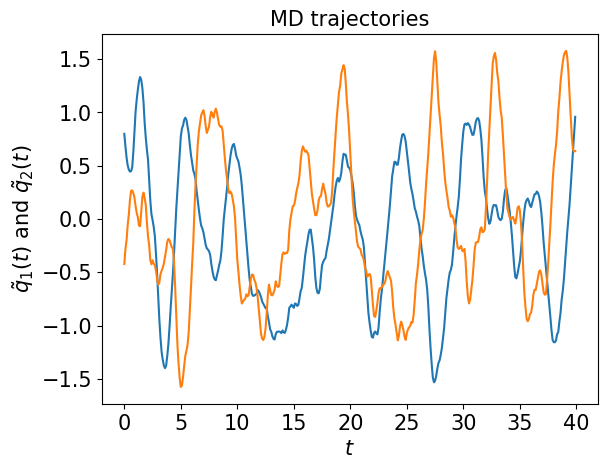

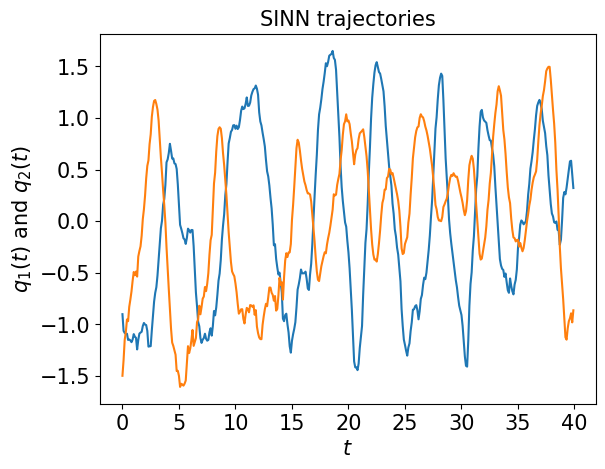

In [34]:
test1(model)

## Test 2: plot the CCF of the sample path generated by the SINN and the exact CCF

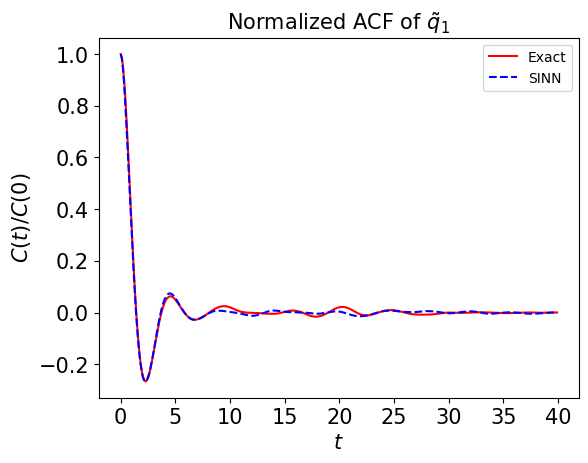

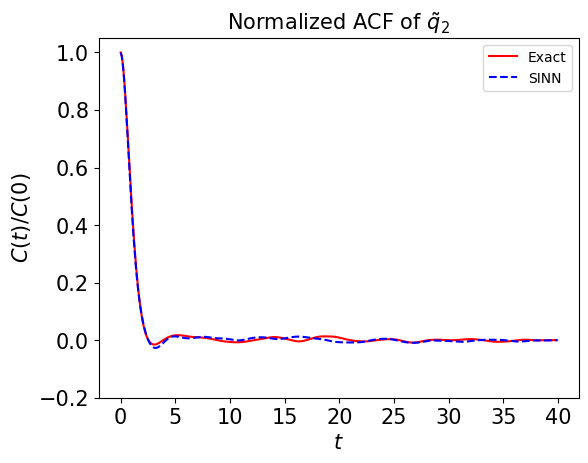

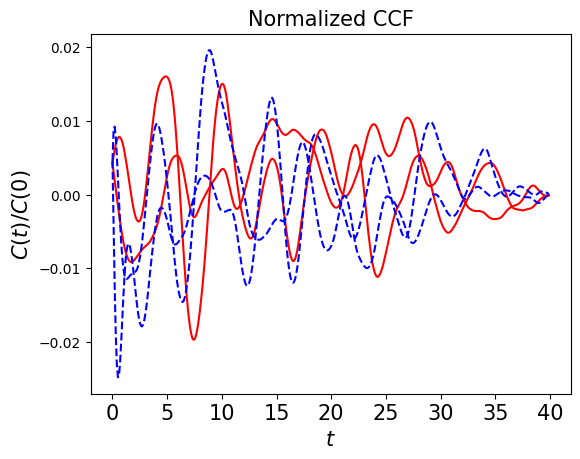

In [35]:
test2(model)

## Test 3: plot the PDF of the sample path generated by SINN and the exact PDF  

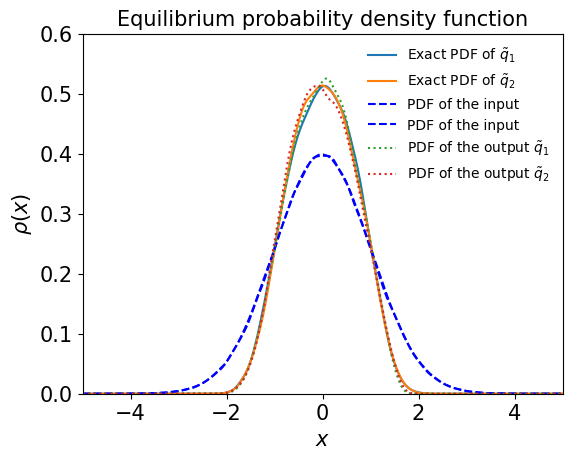

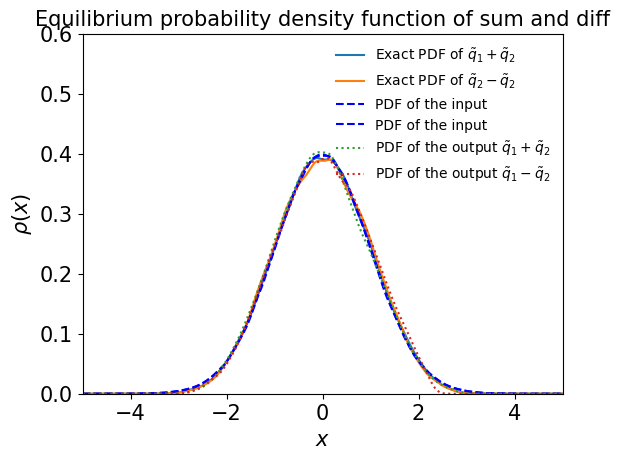

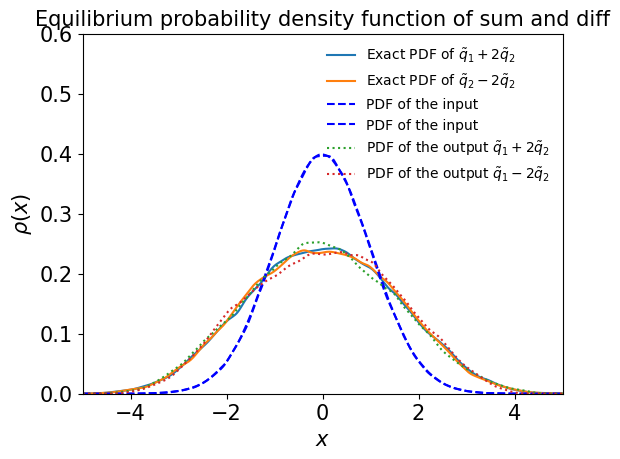

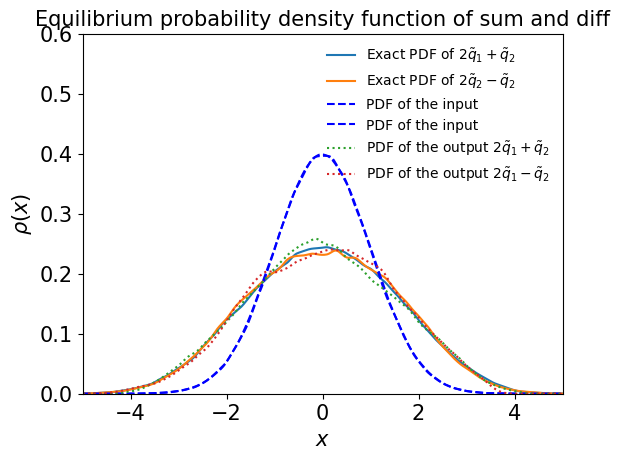

In [36]:
test3(model)

## Test 4: Comparing the higher-order ACF

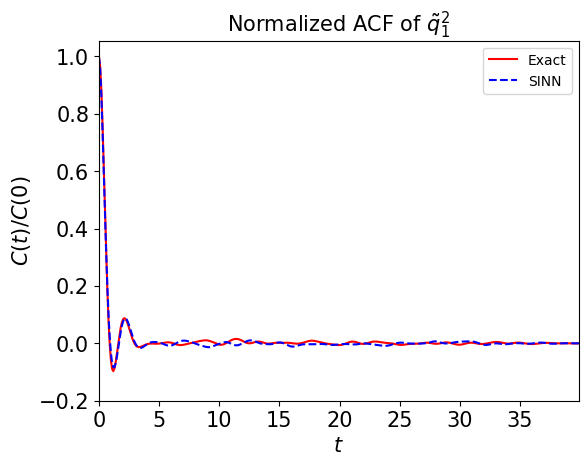

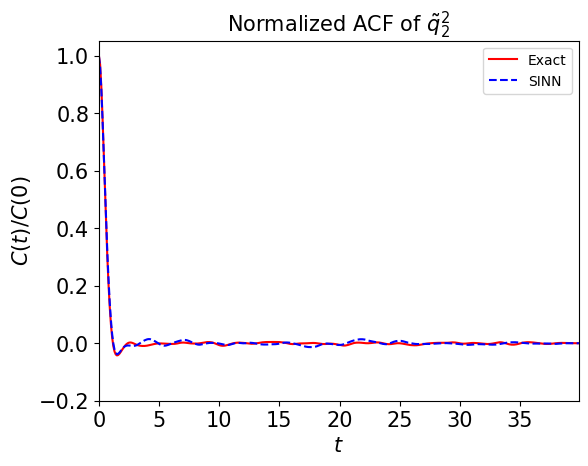

In [37]:
test4(model)

## Test 5: plot the expolation result, i.e. Prediction of the FPU-Langevin dynamics for longer time 

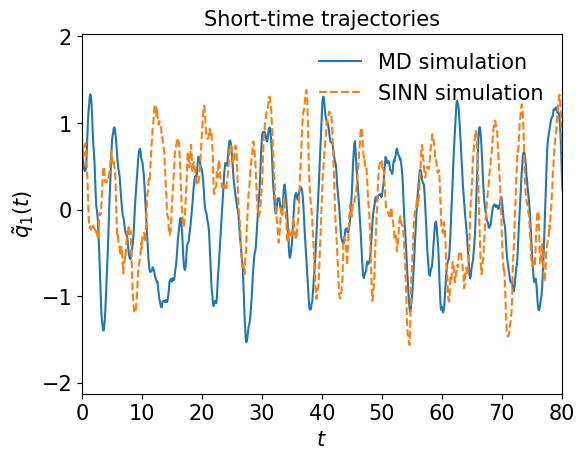

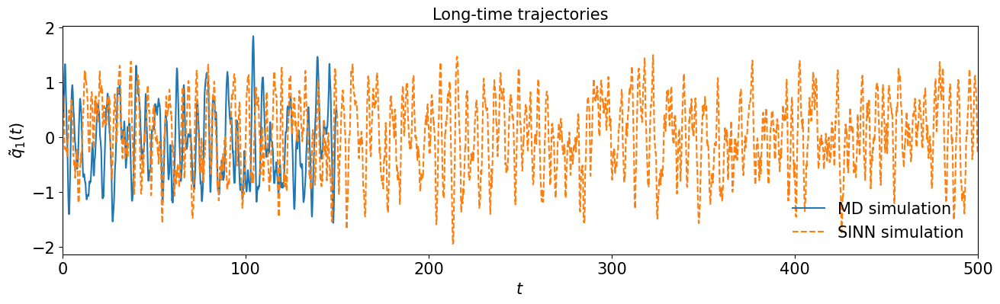

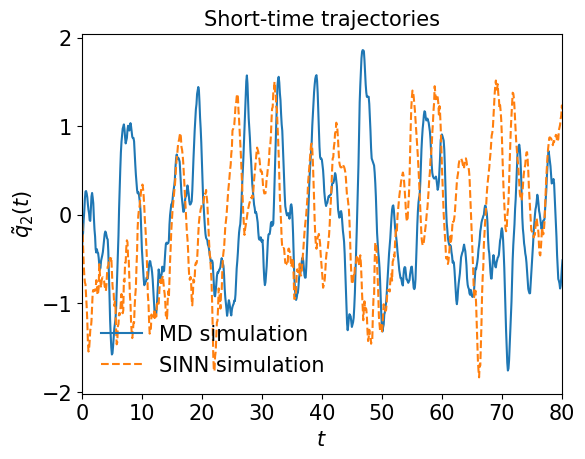

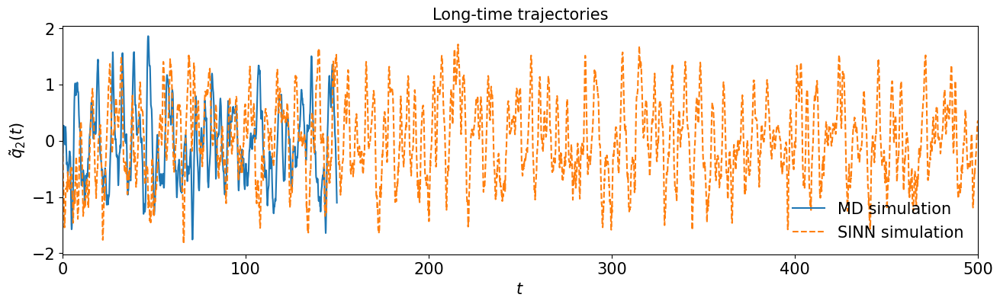

In [38]:
test5(model)

# Test 6: comparing scatter plots

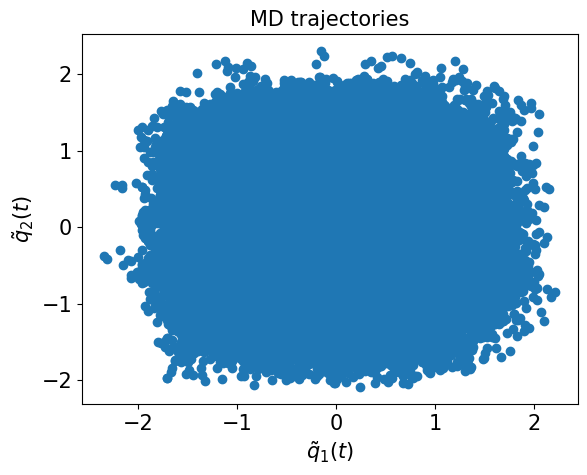

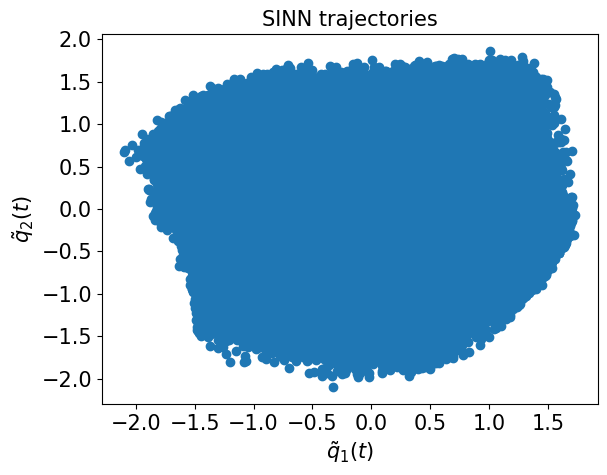

In [39]:
test6(model)

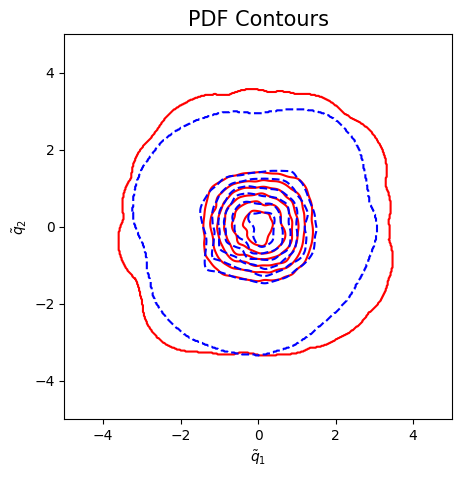

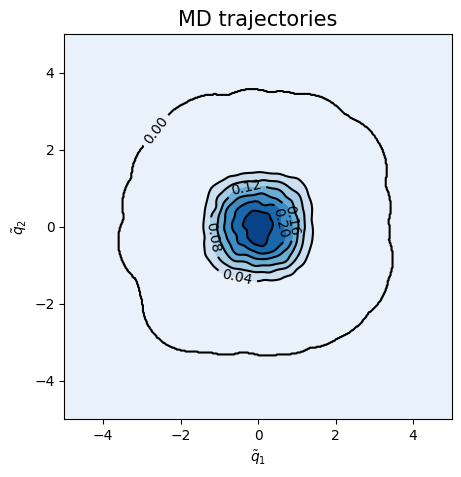

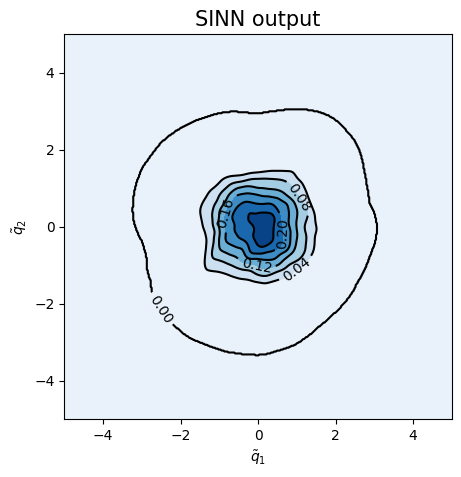

<Figure size 500x500 with 0 Axes>

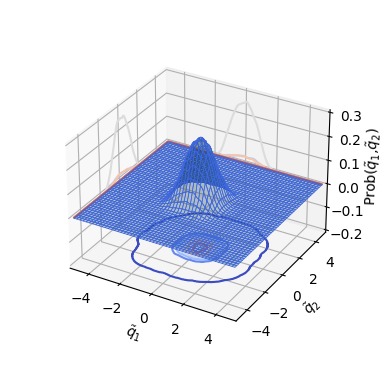

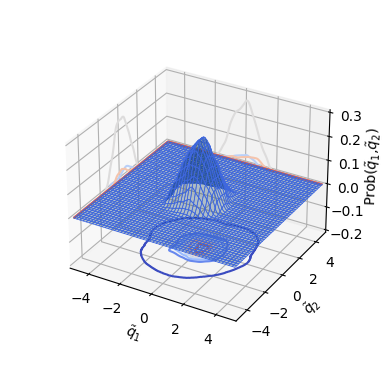

In [40]:
test7(model)

In [41]:
### Defining SINN model
net1 = SINN(2, 10, 2, 2).to(device)

In [42]:
model1 = Model(net=net1)

In [43]:
model1.train()

[0]-th step loss: 0.5284, 0.5272, acf: 0.00672, ccf: 0.00576, pdf: 0.24704, pdf2: 0.26669, acf2: 0.00102
[50]-th step loss: 0.1979, 0.1890, acf: 0.00246, ccf: 0.01220, pdf: 0.08236, pdf2: 0.09157, acf2: 0.00044
[100]-th step loss: 0.0609, 0.0608, acf: 0.00255, ccf: 0.01782, pdf: 0.00906, pdf2: 0.03093, acf2: 0.00047
[150]-th step loss: 0.0469, 0.0465, acf: 0.00199, ccf: 0.01486, pdf: 0.00442, pdf2: 0.02489, acf2: 0.00037
[200]-th step loss: 0.0386, 0.0384, acf: 0.00232, ccf: 0.01285, pdf: 0.00280, pdf2: 0.01994, acf2: 0.00048
[250]-th step loss: 0.0295, 0.0293, acf: 0.00332, ccf: 0.01130, pdf: 0.00223, pdf2: 0.01191, acf2: 0.00056
[300]-th step loss: 0.0204, 0.0202, acf: 0.00518, ccf: 0.00837, pdf: 0.00199, pdf2: 0.00395, acf2: 0.00070
[350]-th step loss: 0.0115, 0.0113, acf: 0.00334, ccf: 0.00402, pdf: 0.00192, pdf2: 0.00148, acf2: 0.00055
[400]-th step loss: 0.0053, 0.0052, acf: 0.00125, ccf: 0.00150, pdf: 0.00111, pdf2: 0.00098, acf2: 0.00031
[450]-th step loss: 0.0030, 0.0030, acf:

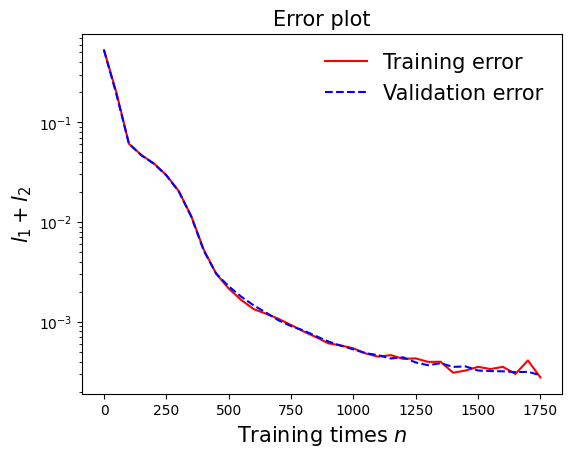

In [44]:
draw_loss(model1)

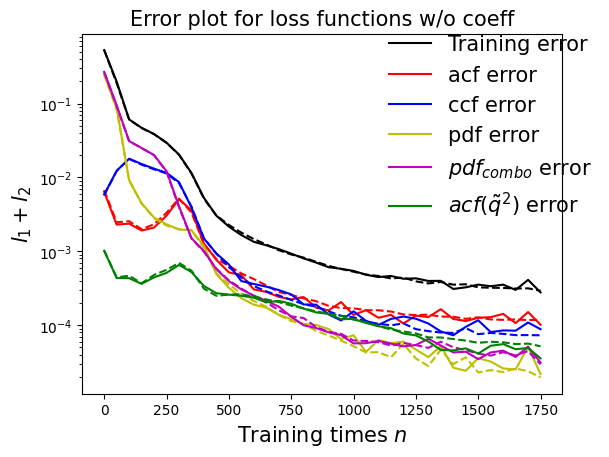

In [45]:
draw_errors(model1)

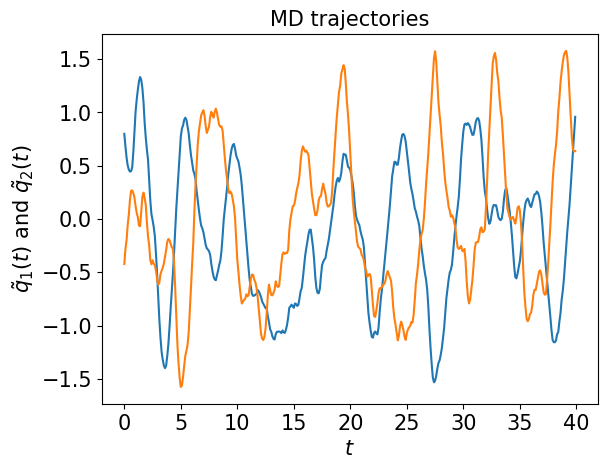

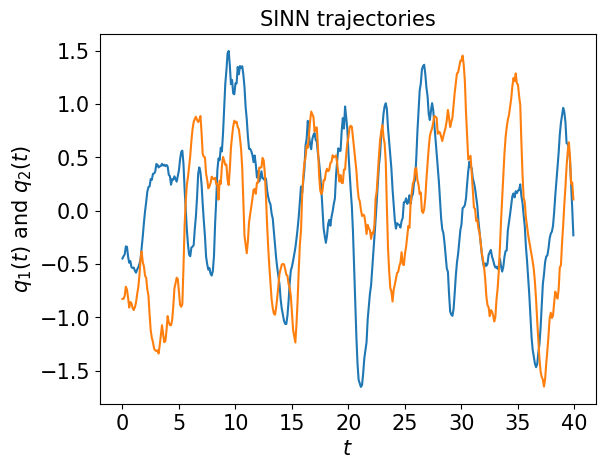

In [46]:
test1(model1)

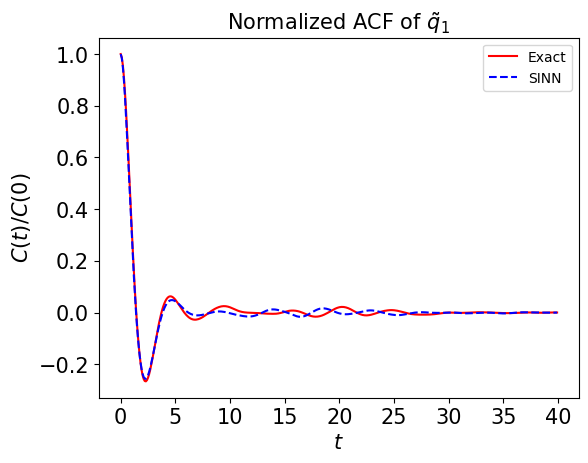

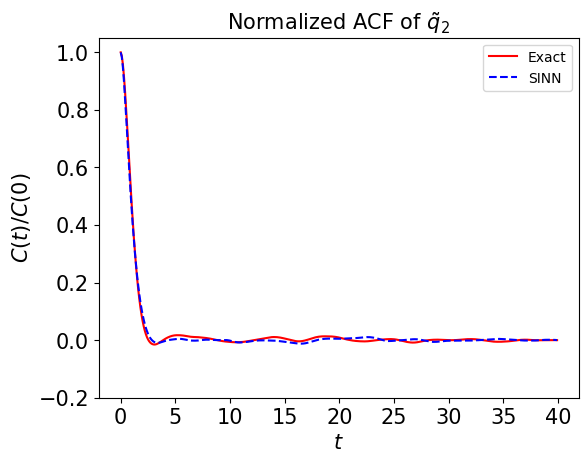

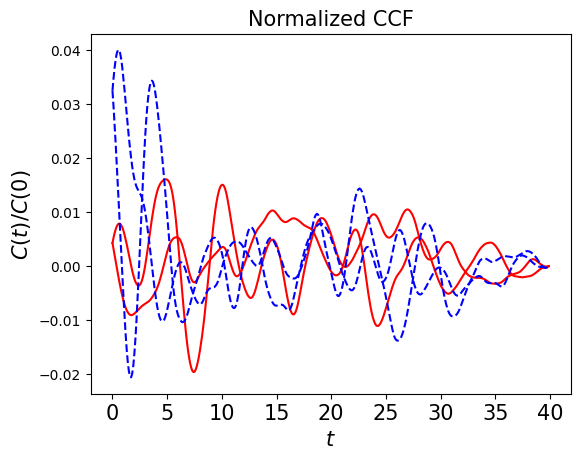

In [47]:
test2(model1)

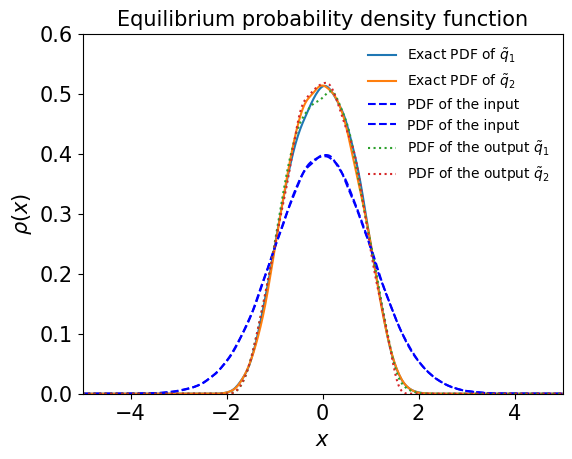

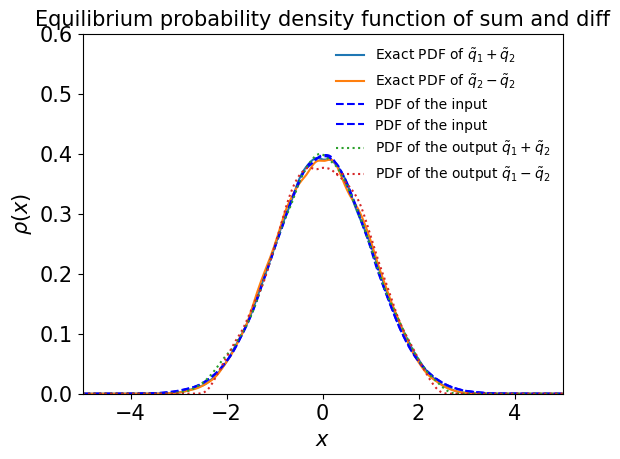

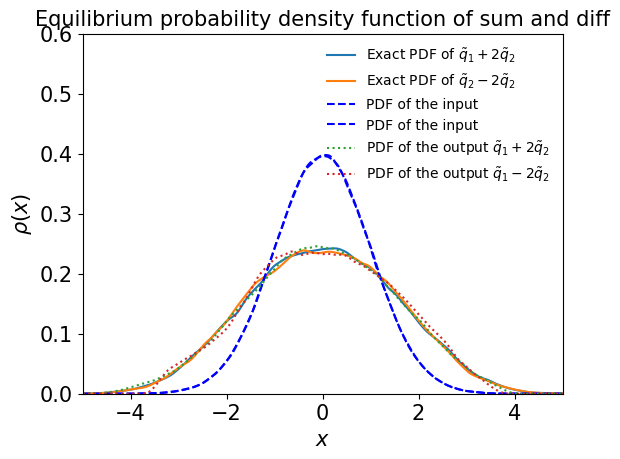

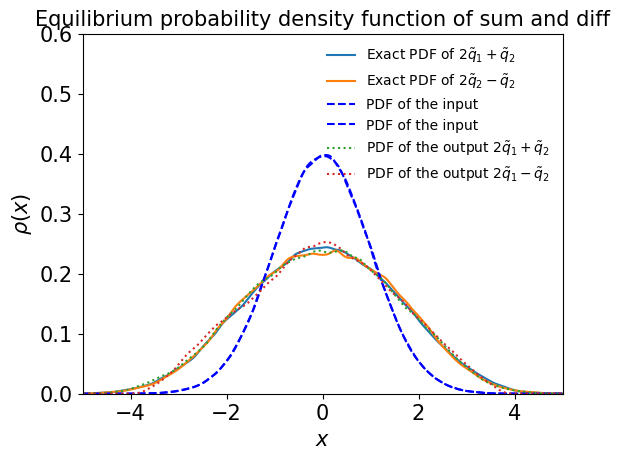

In [48]:
test3(model1)

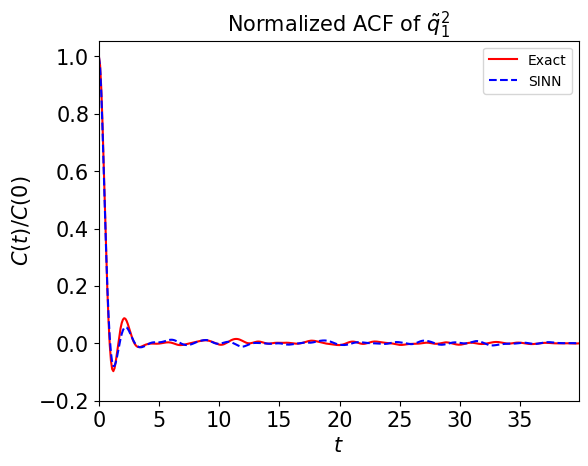

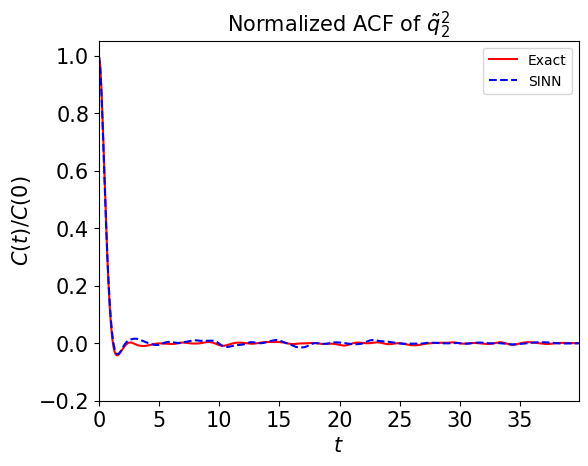

In [49]:
test4(model1)

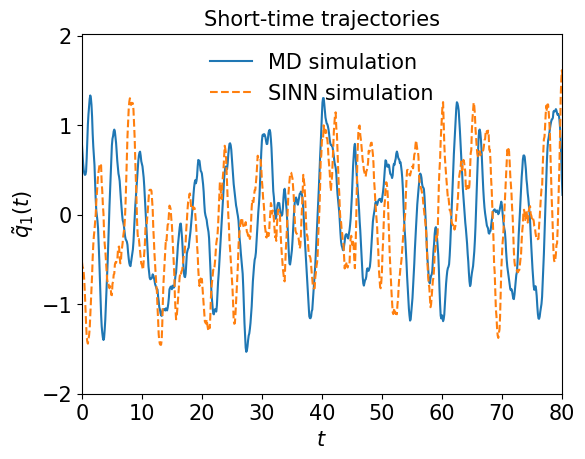

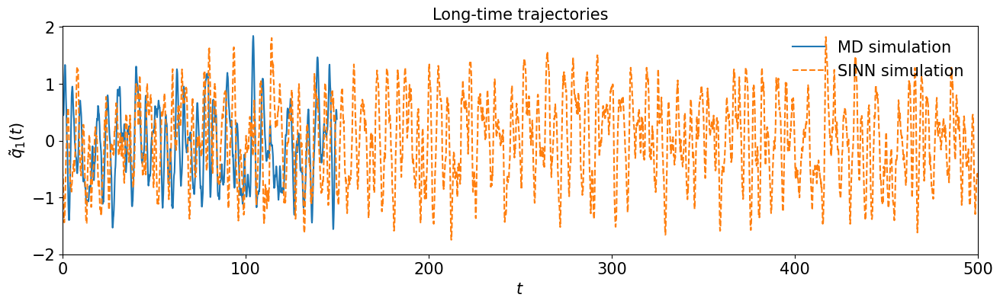

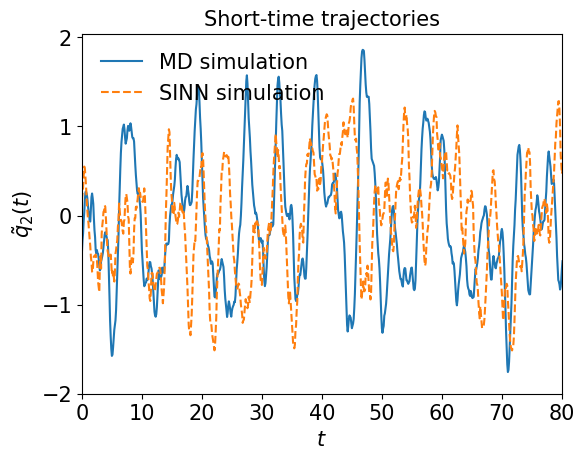

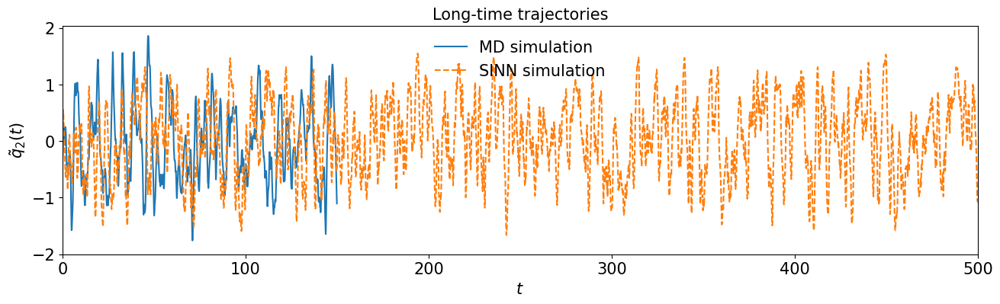

In [50]:
test5(model1)

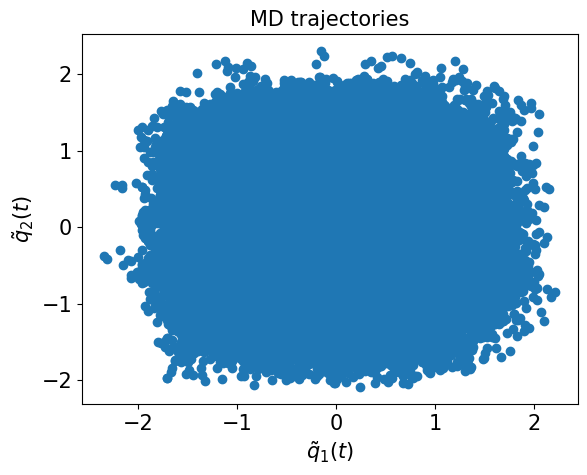

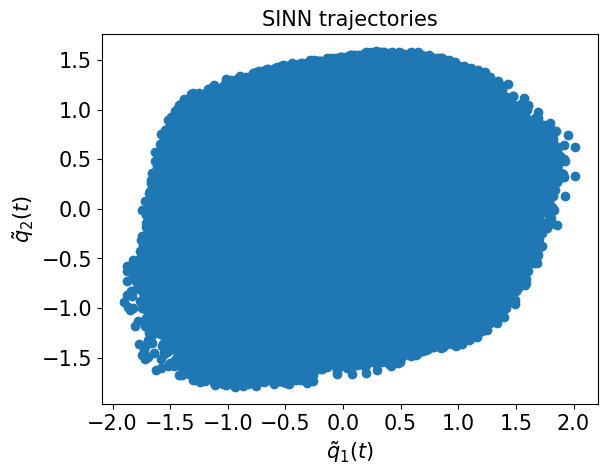

In [51]:
test6(model1)

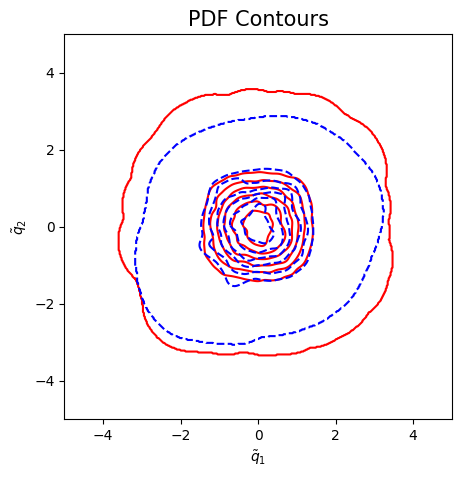

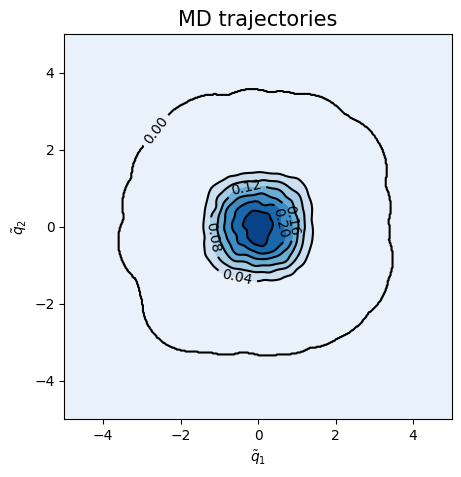

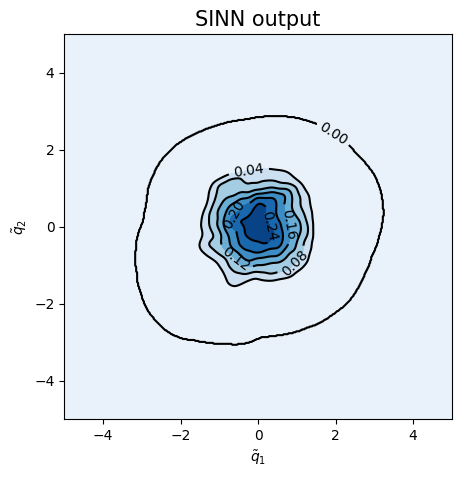

<Figure size 500x500 with 0 Axes>

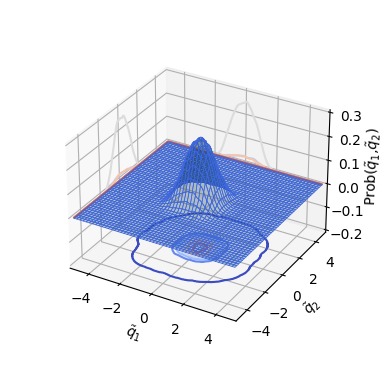

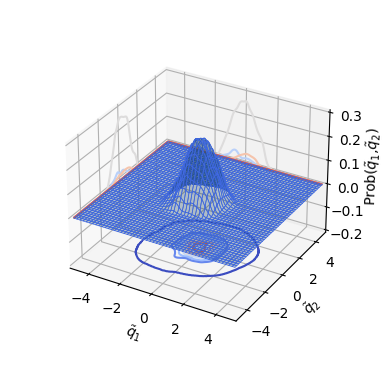

In [52]:
test7(model1)

In [53]:
### Defining SINN model
net2 = SINN(2, 10, 2, 2).to(device)

In [54]:
model2 = Model(net=net2)

In [55]:
model2.train()

[0]-th step loss: 0.5313, 0.5307, acf: 0.00902, ccf: 0.00378, pdf: 0.24624, pdf2: 0.26949, acf2: 0.00219
[50]-th step loss: 0.2434, 0.2315, acf: 0.00236, ccf: 0.01263, pdf: 0.11106, pdf2: 0.10432, acf2: 0.00117
[100]-th step loss: 0.0601, 0.0593, acf: 0.00195, ccf: 0.01463, pdf: 0.01583, pdf2: 0.02568, acf2: 0.00119
[150]-th step loss: 0.0301, 0.0297, acf: 0.00358, ccf: 0.00900, pdf: 0.00829, pdf2: 0.00833, acf2: 0.00053
[200]-th step loss: 0.0165, 0.0162, acf: 0.00342, ccf: 0.00544, pdf: 0.00315, pdf2: 0.00286, acf2: 0.00135
[250]-th step loss: 0.0104, 0.0104, acf: 0.00203, ccf: 0.00303, pdf: 0.00232, pdf2: 0.00208, acf2: 0.00094
[300]-th step loss: 0.0068, 0.0066, acf: 0.00126, ccf: 0.00182, pdf: 0.00136, pdf2: 0.00154, acf2: 0.00063
[350]-th step loss: 0.0042, 0.0043, acf: 0.00070, ccf: 0.00086, pdf: 0.00089, pdf2: 0.00140, acf2: 0.00045
[400]-th step loss: 0.0293, 0.0330, acf: 0.00219, ccf: 0.00319, pdf: 0.01486, pdf2: 0.01229, acf2: 0.00043
[450]-th step loss: 0.0144, 0.0148, acf:

[3850]-th step loss: 0.0086, 0.0086, acf: 0.00330, ccf: 0.00302, pdf: 0.00031, pdf2: 0.00106, acf2: 0.00092
[3900]-th step loss: 0.0078, 0.0080, acf: 0.00299, ccf: 0.00281, pdf: 0.00028, pdf2: 0.00103, acf2: 0.00087
[3950]-th step loss: 0.0076, 0.0077, acf: 0.00295, ccf: 0.00264, pdf: 0.00027, pdf2: 0.00098, acf2: 0.00084
[4000]-th step loss: 0.0072, 0.0073, acf: 0.00283, ccf: 0.00250, pdf: 0.00024, pdf2: 0.00094, acf2: 0.00081
[4050]-th step loss: 0.0069, 0.0070, acf: 0.00268, ccf: 0.00239, pdf: 0.00022, pdf2: 0.00090, acf2: 0.00080
[4100]-th step loss: 0.0060, 0.0060, acf: 0.00228, ccf: 0.00177, pdf: 0.00018, pdf2: 0.00090, acf2: 0.00083
[4150]-th step loss: 0.0057, 0.0059, acf: 0.00239, ccf: 0.00152, pdf: 0.00023, pdf2: 0.00090, acf2: 0.00086
[4200]-th step loss: 0.0064, 0.0064, acf: 0.00280, ccf: 0.00177, pdf: 0.00025, pdf2: 0.00076, acf2: 0.00079
[4250]-th step loss: 0.0065, 0.0066, acf: 0.00297, ccf: 0.00182, pdf: 0.00029, pdf2: 0.00072, acf2: 0.00076
[4300]-th step loss: 0.0065,

[7650]-th step loss: 0.0025, 0.0026, acf: 0.00057, ccf: 0.00084, pdf: 0.00039, pdf2: 0.00046, acf2: 0.00034
[7700]-th step loss: 0.0026, 0.0026, acf: 0.00059, ccf: 0.00087, pdf: 0.00014, pdf2: 0.00059, acf2: 0.00039
[7750]-th step loss: 0.0024, 0.0024, acf: 0.00056, ccf: 0.00082, pdf: 0.00012, pdf2: 0.00053, acf2: 0.00037
[7800]-th step loss: 0.0023, 0.0023, acf: 0.00053, ccf: 0.00072, pdf: 0.00014, pdf2: 0.00051, acf2: 0.00039
[7850]-th step loss: 0.0022, 0.0022, acf: 0.00053, ccf: 0.00068, pdf: 0.00013, pdf2: 0.00049, acf2: 0.00040
[7900]-th step loss: 0.0022, 0.0022, acf: 0.00051, ccf: 0.00073, pdf: 0.00013, pdf2: 0.00043, acf2: 0.00037
[7950]-th step loss: 0.0047, 0.0048, acf: 0.00060, ccf: 0.00163, pdf: 0.00105, pdf2: 0.00109, acf2: 0.00046
[8000]-th step loss: 0.0029, 0.0029, acf: 0.00084, ccf: 0.00107, pdf: 0.00028, pdf2: 0.00033, acf2: 0.00036
[8050]-th step loss: 0.0027, 0.0027, acf: 0.00069, ccf: 0.00094, pdf: 0.00030, pdf2: 0.00033, acf2: 0.00039
[8100]-th step loss: 0.0024,

[11450]-th step loss: 0.0044, 0.0045, acf: 0.00183, ccf: 0.00126, pdf: 0.00018, pdf2: 0.00066, acf2: 0.00056
[11500]-th step loss: 0.0042, 0.0043, acf: 0.00179, ccf: 0.00113, pdf: 0.00019, pdf2: 0.00062, acf2: 0.00055
[11550]-th step loss: 0.0041, 0.0041, acf: 0.00176, ccf: 0.00102, pdf: 0.00020, pdf2: 0.00057, acf2: 0.00056
[11600]-th step loss: 0.0040, 0.0039, acf: 0.00172, ccf: 0.00091, pdf: 0.00022, pdf2: 0.00051, acf2: 0.00058
[11650]-th step loss: 0.0037, 0.0037, acf: 0.00166, ccf: 0.00076, pdf: 0.00022, pdf2: 0.00046, acf2: 0.00059
[11700]-th step loss: 0.0035, 0.0034, acf: 0.00155, ccf: 0.00064, pdf: 0.00023, pdf2: 0.00040, acf2: 0.00061
[11750]-th step loss: 0.0033, 0.0032, acf: 0.00147, ccf: 0.00055, pdf: 0.00024, pdf2: 0.00035, acf2: 0.00062
[11800]-th step loss: 0.0031, 0.0030, acf: 0.00140, ccf: 0.00048, pdf: 0.00024, pdf2: 0.00032, acf2: 0.00061
[11850]-th step loss: 0.0030, 0.0029, acf: 0.00136, ccf: 0.00044, pdf: 0.00023, pdf2: 0.00029, acf2: 0.00060
[11900]-th step los

[15250]-th step loss: 0.0003, 0.0003, acf: 0.00016, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00008
[15300]-th step loss: 0.0003, 0.0003, acf: 0.00015, ccf: 0.00007, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00007
[15350]-th step loss: 0.0003, 0.0003, acf: 0.00016, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00008
[15400]-th step loss: 0.0003, 0.0003, acf: 0.00014, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00007
[15450]-th step loss: 0.0005, 0.0004, acf: 0.00015, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00008
[15500]-th step loss: 0.0003, 0.0004, acf: 0.00015, ccf: 0.00007, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00009
[15550]-th step loss: 0.0004, 0.0003, acf: 0.00013, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00003, acf2: 0.00008
[15600]-th step loss: 0.0003, 0.0003, acf: 0.00013, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00007
Training finished
Training time: 935.01
Training time per iteration: 0.06
Number of Iterations:15606


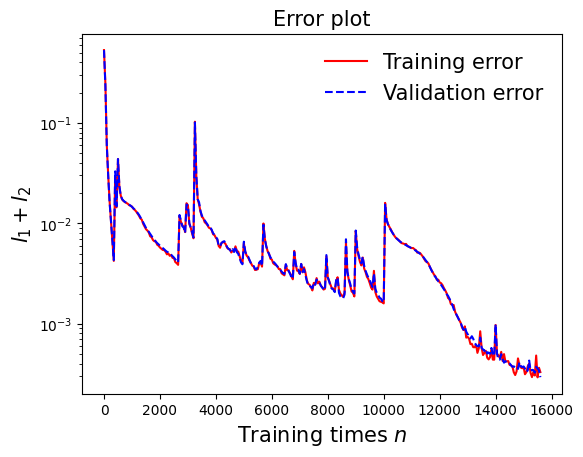

In [56]:
draw_loss(model2)

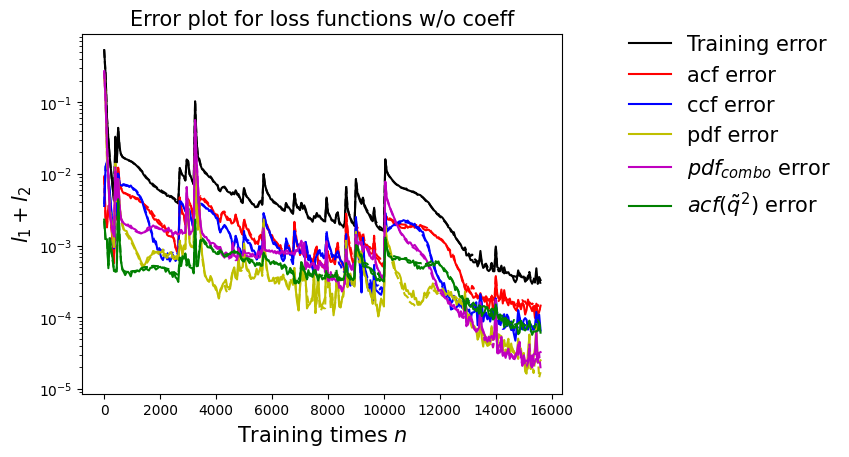

In [57]:
draw_errors(model2)

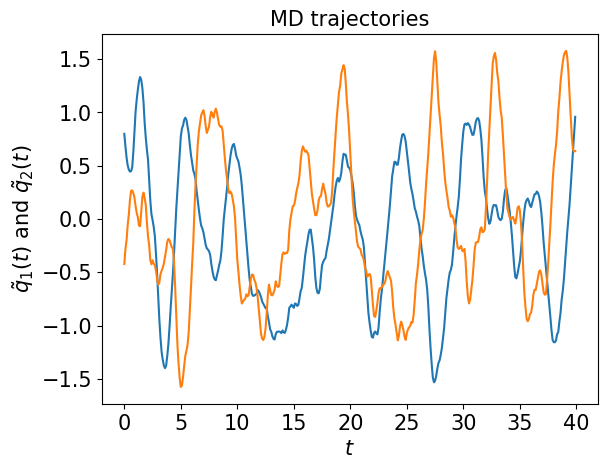

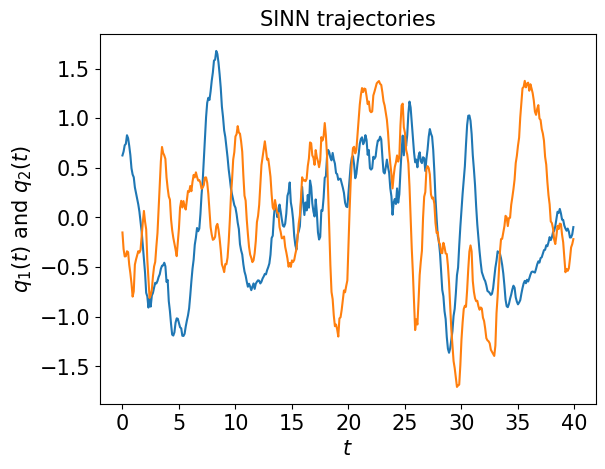

In [58]:
test1(model2)

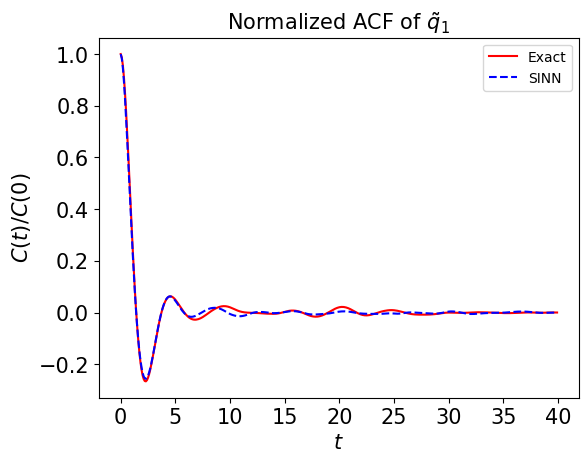

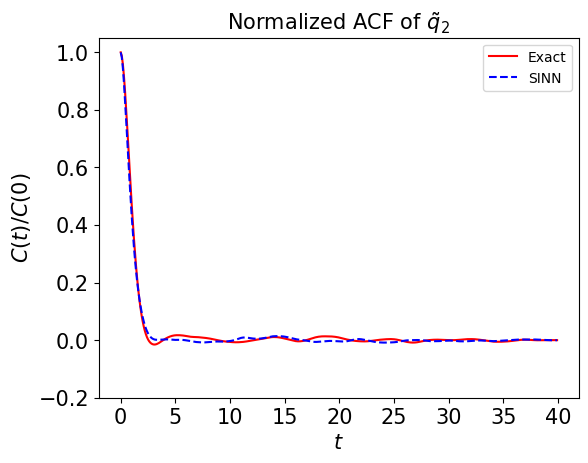

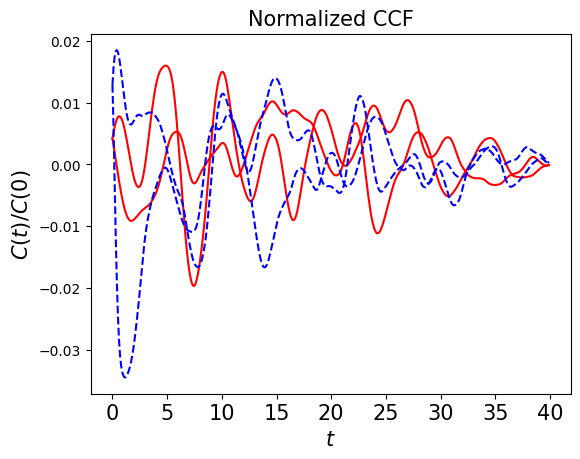

In [59]:
test2(model2)

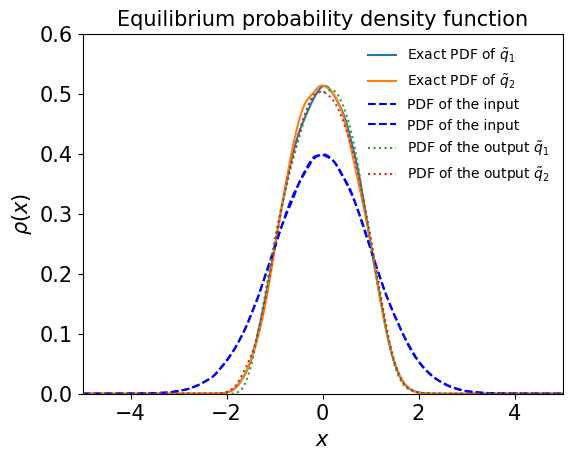

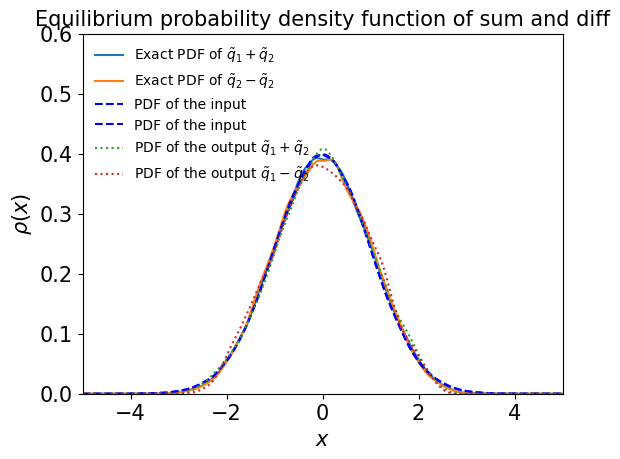

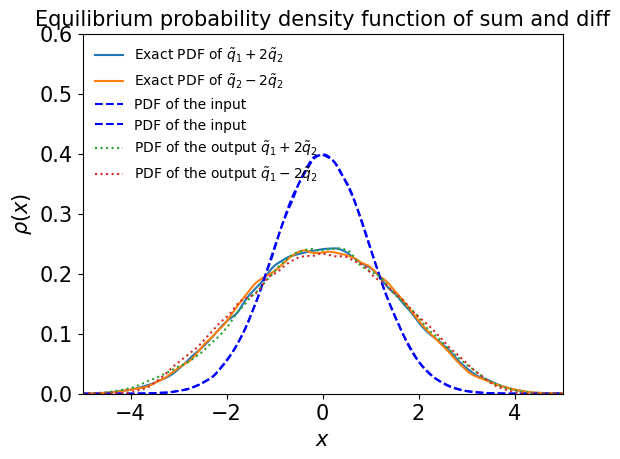

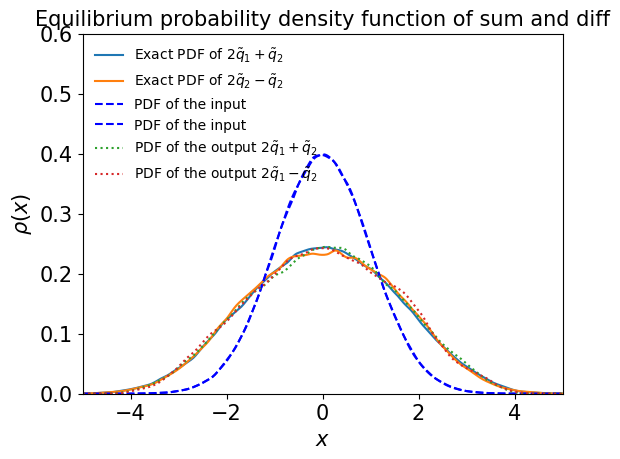

In [60]:
test3(model2)

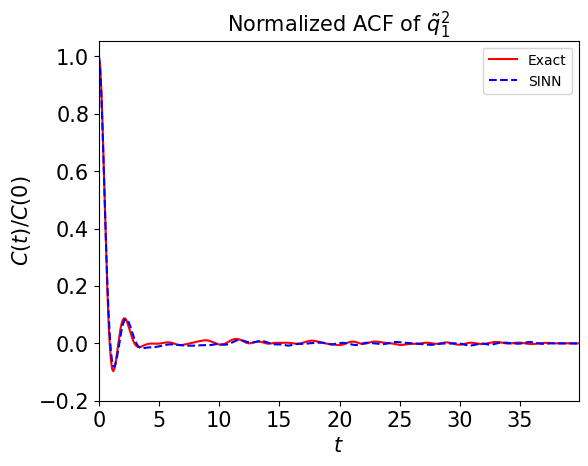

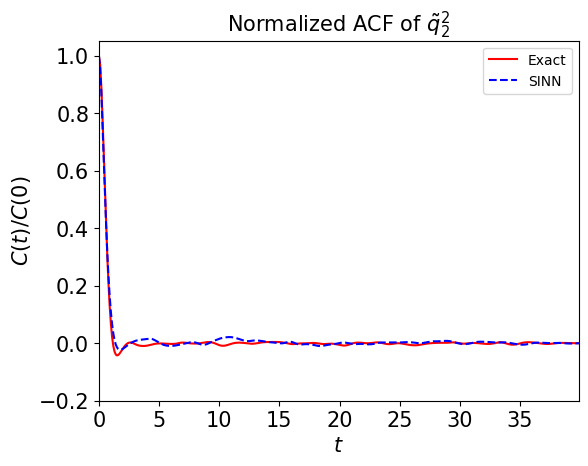

In [61]:
test4(model2)

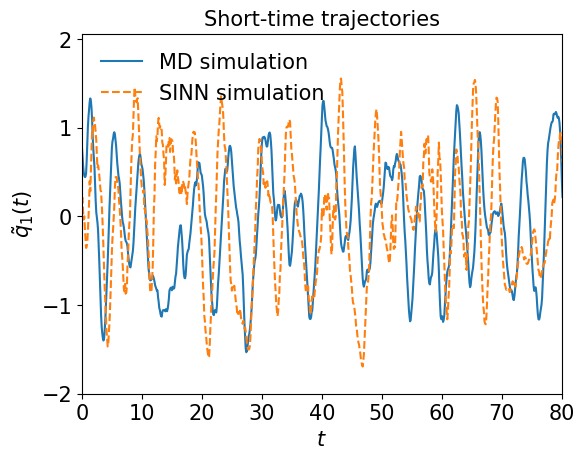

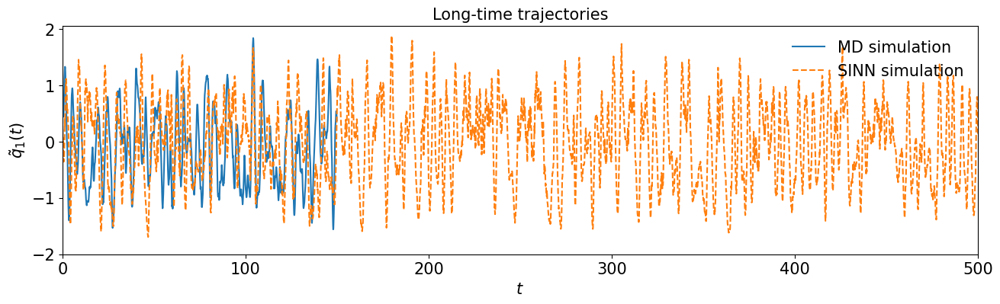

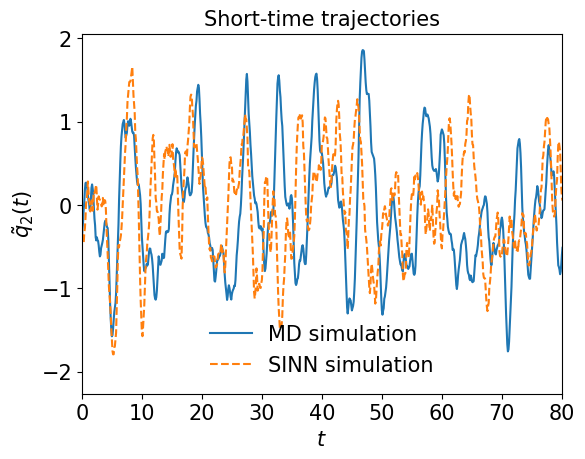

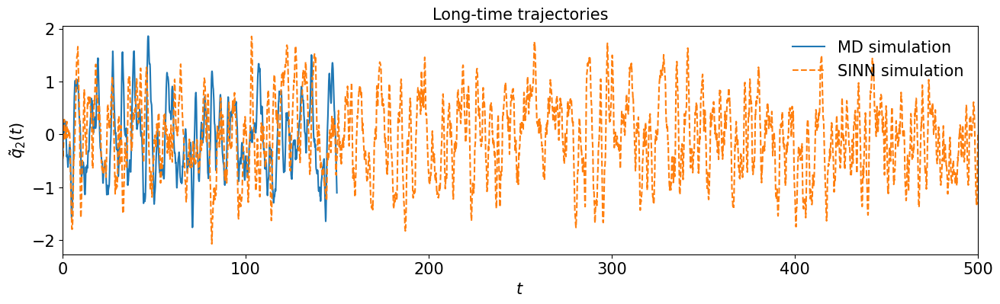

In [62]:
test5(model2)

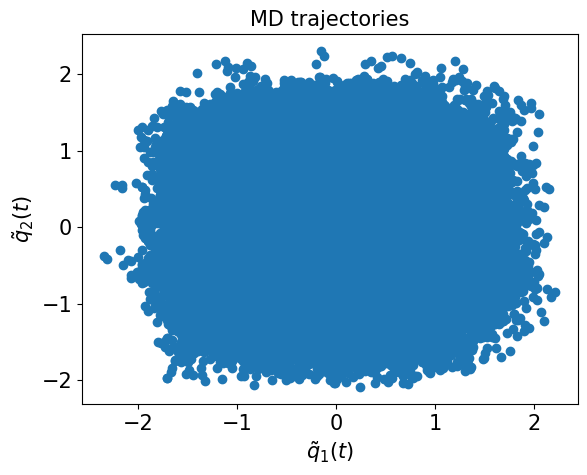

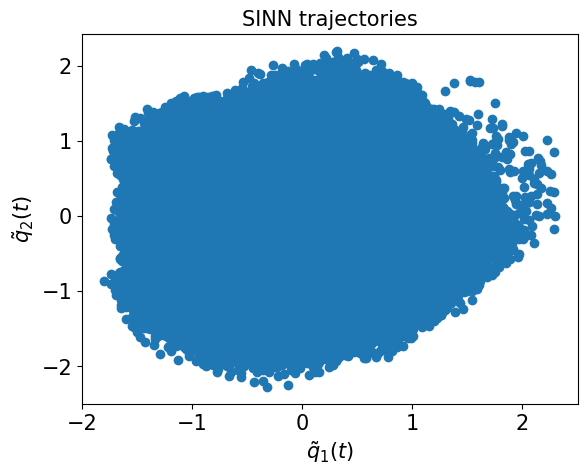

In [63]:
test6(model2)

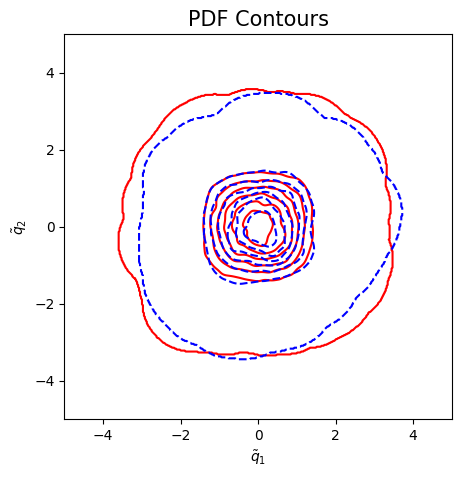

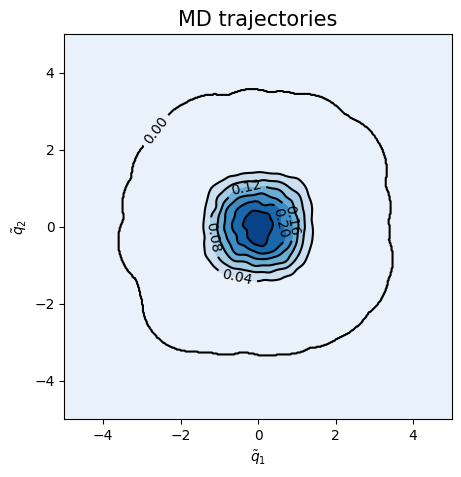

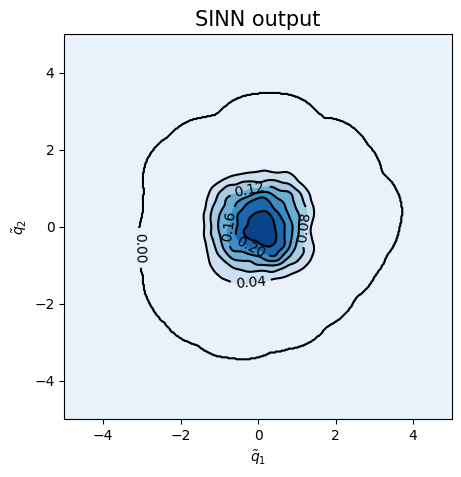

<Figure size 500x500 with 0 Axes>

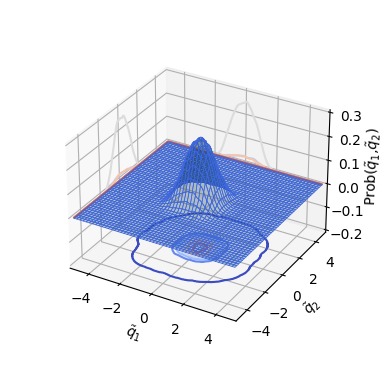

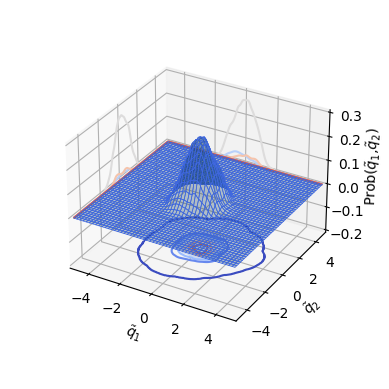

In [64]:
test7(model2)

In [65]:
### Defining SINN model
net3 = SINN(2, 10, 2, 2).to(device)

In [66]:
model3 = Model(net=net3)

In [67]:
model3.train()

[0]-th step loss: 0.5309, 0.5297, acf: 0.00965, ccf: 0.00190, pdf: 0.24723, pdf2: 0.26843, acf2: 0.00249
[50]-th step loss: 0.2402, 0.2306, acf: 0.00418, ccf: 0.00256, pdf: 0.14424, pdf2: 0.07856, acf2: 0.00105
[100]-th step loss: 0.0537, 0.0525, acf: 0.00211, ccf: 0.01476, pdf: 0.02033, pdf2: 0.01458, acf2: 0.00074
[150]-th step loss: 0.0254, 0.0250, acf: 0.00233, ccf: 0.00971, pdf: 0.00595, pdf2: 0.00583, acf2: 0.00121
[200]-th step loss: 0.0122, 0.0123, acf: 0.00173, ccf: 0.00609, pdf: 0.00193, pdf2: 0.00191, acf2: 0.00068
[250]-th step loss: 0.0072, 0.0073, acf: 0.00183, ccf: 0.00254, pdf: 0.00090, pdf2: 0.00163, acf2: 0.00038
[300]-th step loss: 0.0060, 0.0057, acf: 0.00200, ccf: 0.00139, pdf: 0.00058, pdf2: 0.00137, acf2: 0.00037
[350]-th step loss: 0.0045, 0.0045, acf: 0.00183, ccf: 0.00082, pdf: 0.00039, pdf2: 0.00110, acf2: 0.00035
[400]-th step loss: 0.0034, 0.0034, acf: 0.00157, ccf: 0.00035, pdf: 0.00028, pdf2: 0.00083, acf2: 0.00034
[450]-th step loss: 0.0024, 0.0024, acf:

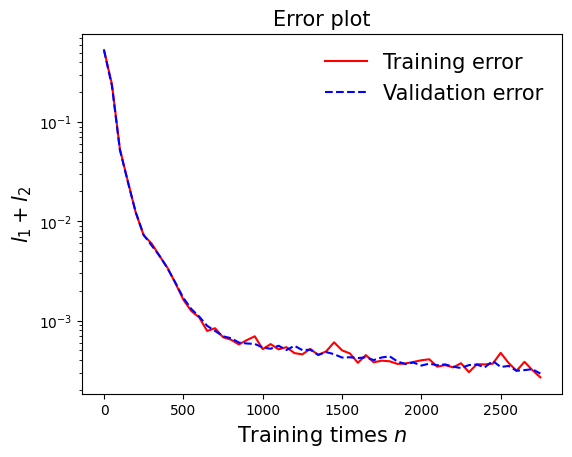

In [68]:
draw_loss(model3)

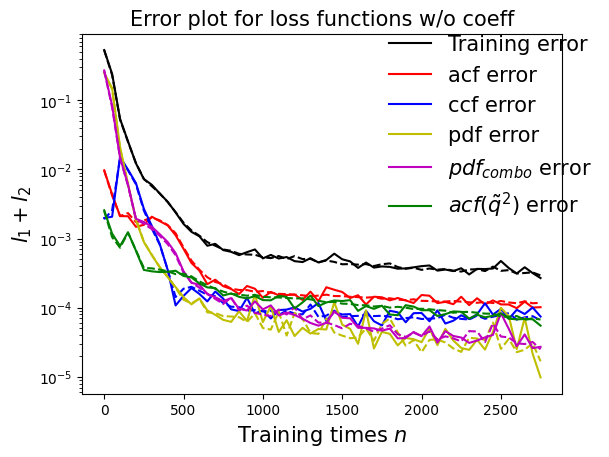

In [69]:
draw_errors(model3)

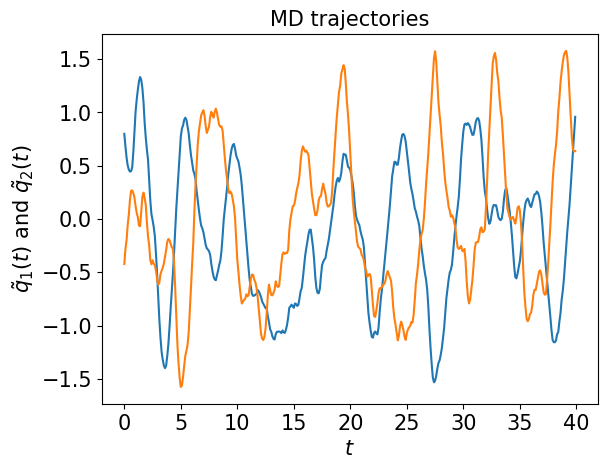

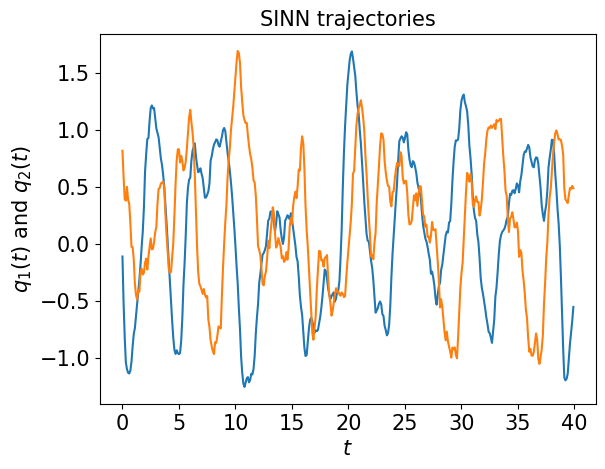

In [70]:
test1(model3)

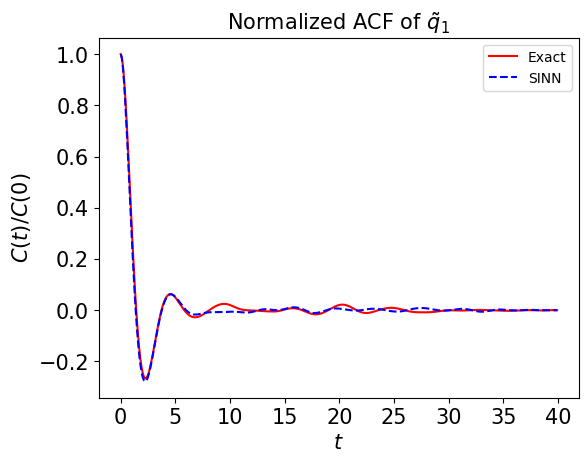

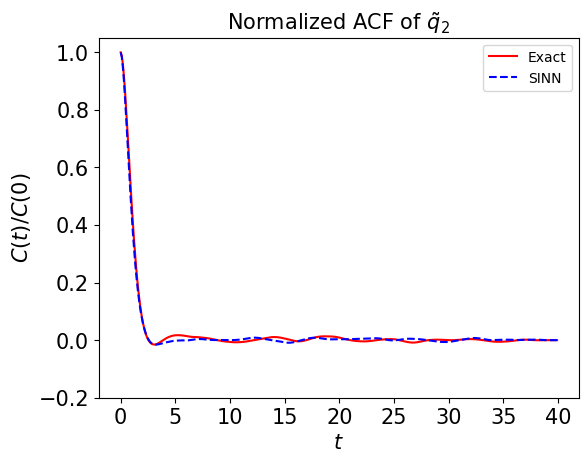

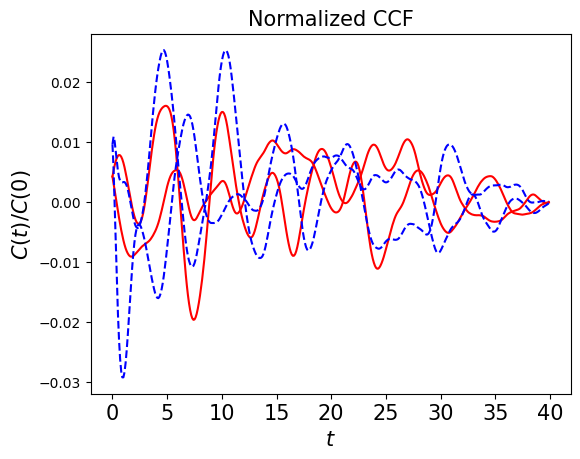

In [71]:
test2(model3)

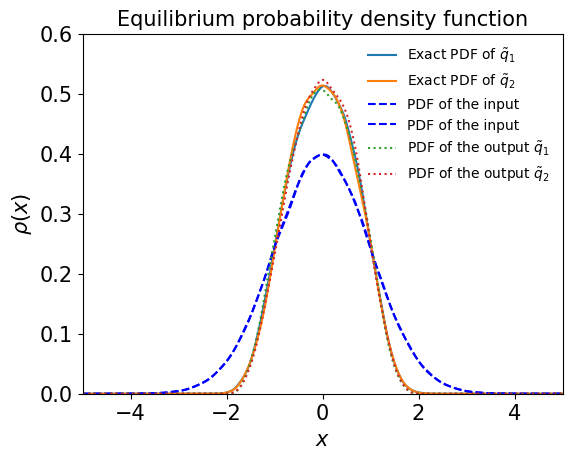

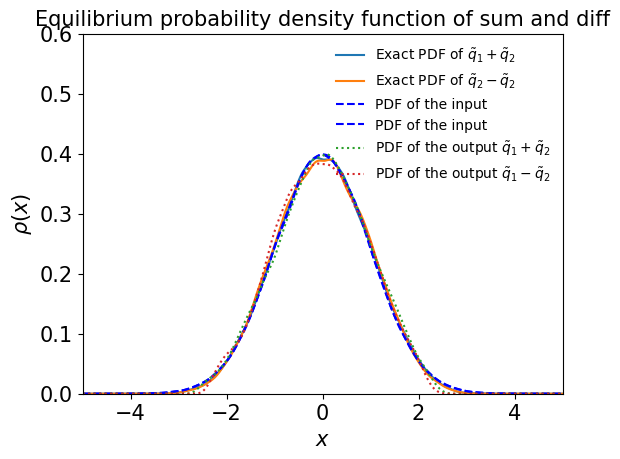

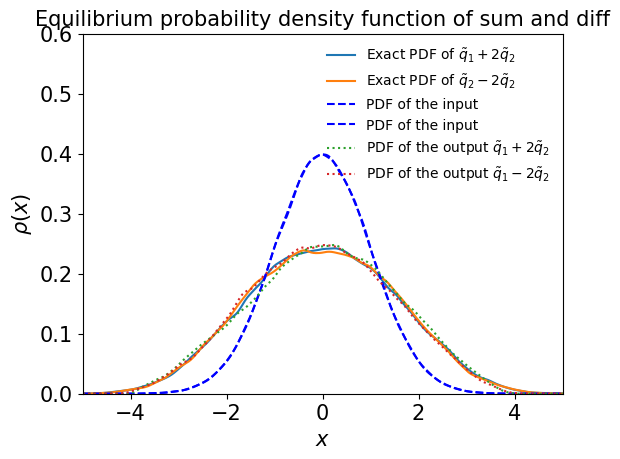

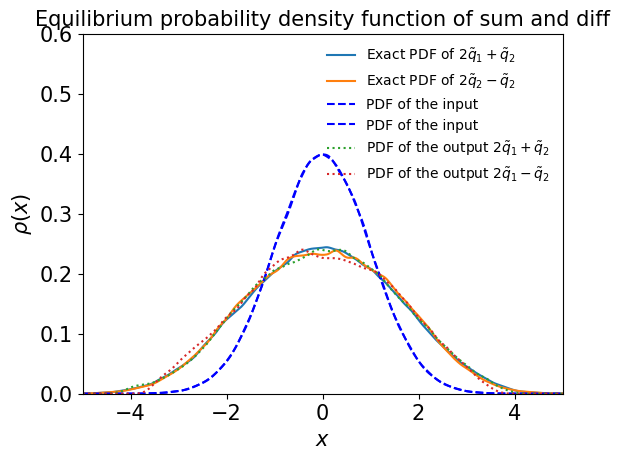

In [72]:
test3(model3)

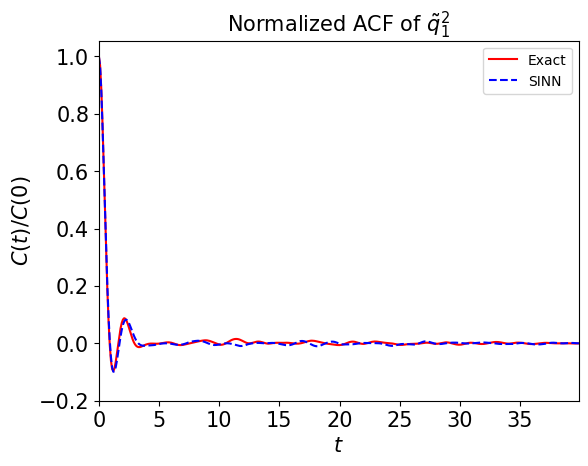

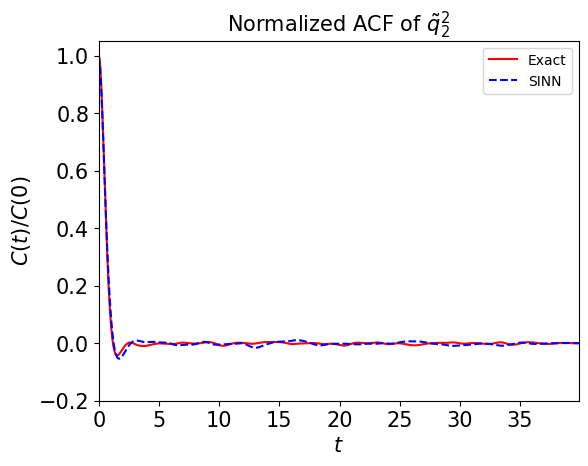

In [73]:
test4(model3)

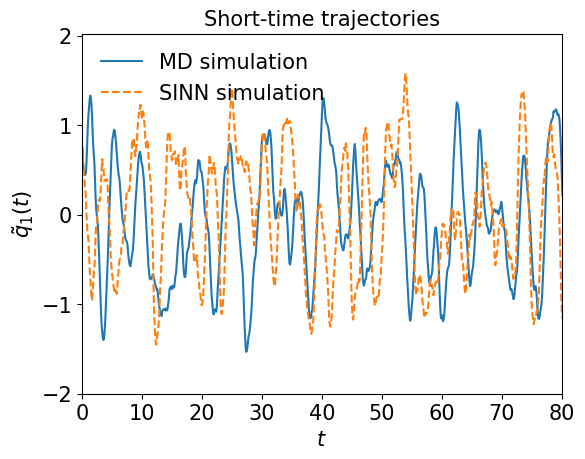

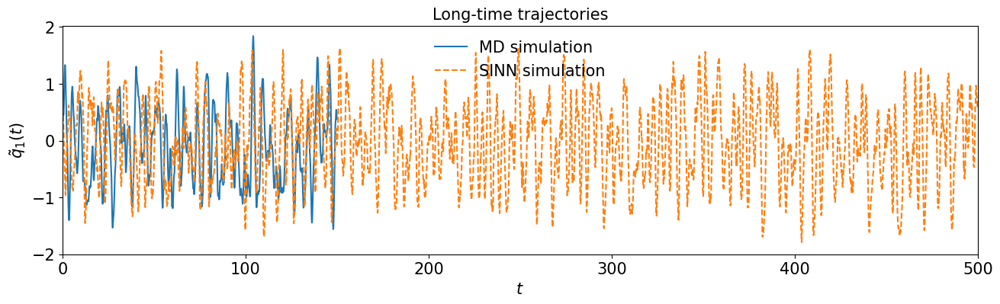

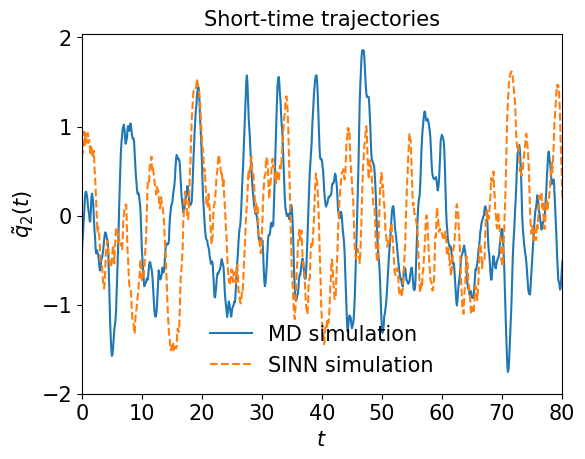

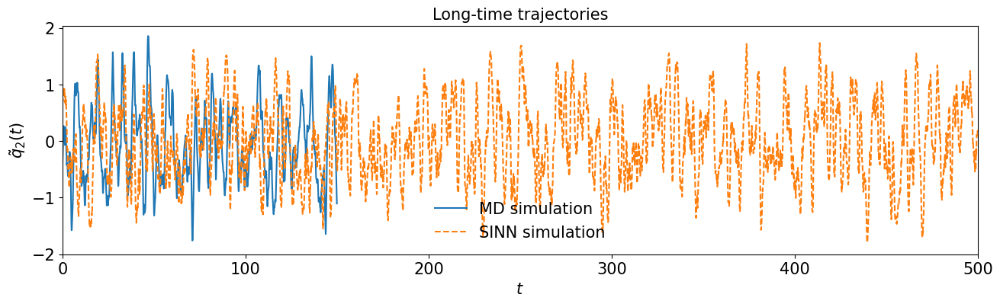

In [74]:
test5(model3)

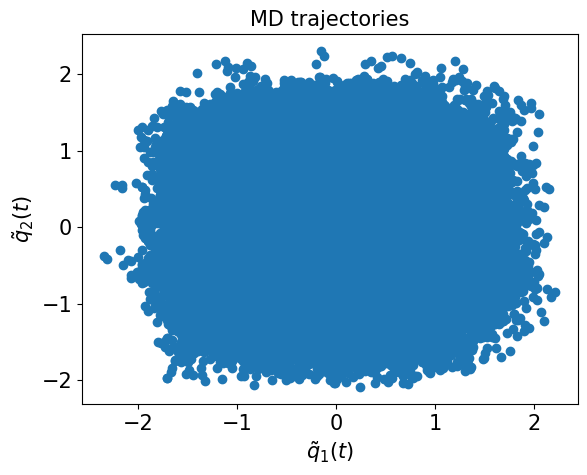

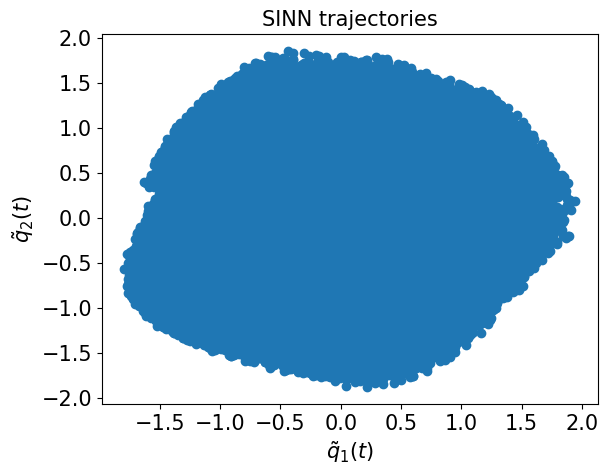

In [75]:
test6(model3)

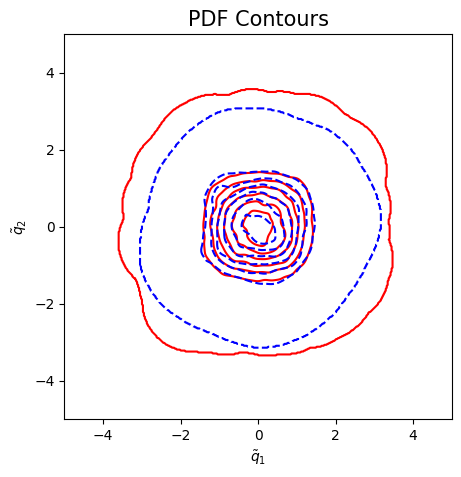

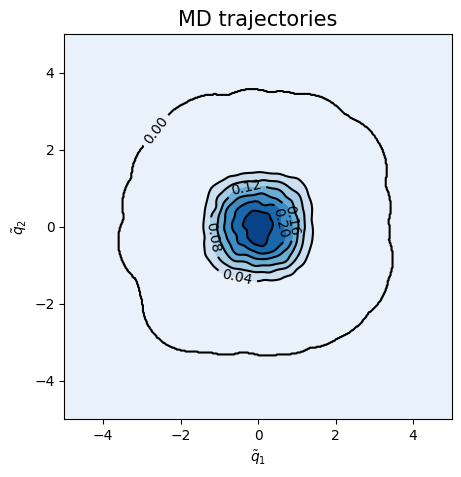

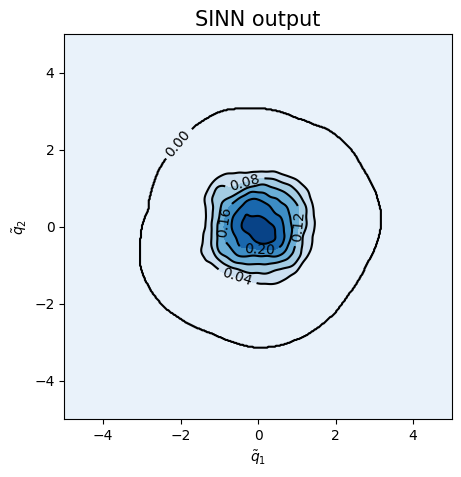

<Figure size 500x500 with 0 Axes>

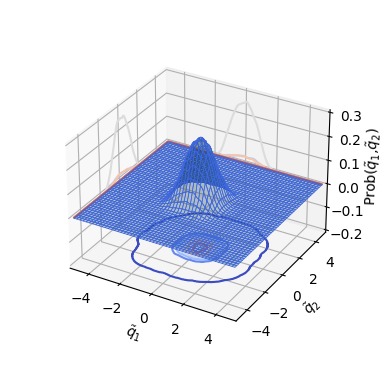

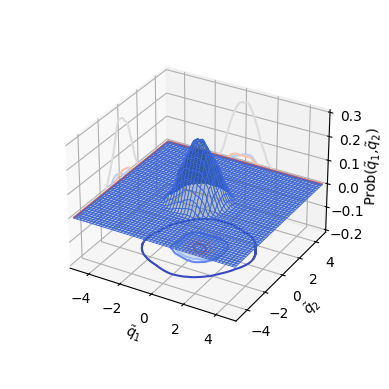

In [76]:
test7(model3)

In [77]:
### Defining SINN model
net4 = SINN(2, 10, 2, 2).to(device)

In [78]:
model4 = Model(net=net4)

In [79]:
model4.train()

[0]-th step loss: 0.5286, 0.5278, acf: 0.00835, ccf: 0.00367, pdf: 0.24537, pdf2: 0.26847, acf2: 0.00193
[50]-th step loss: 0.3093, 0.2973, acf: 0.00358, ccf: 0.00035, pdf: 0.17395, pdf2: 0.11867, acf2: 0.00074
[100]-th step loss: 0.0239, 0.0236, acf: 0.00269, ccf: 0.00272, pdf: 0.01034, pdf2: 0.00611, acf2: 0.00176
[150]-th step loss: 0.0088, 0.0087, acf: 0.00096, ccf: 0.00086, pdf: 0.00359, pdf2: 0.00276, acf2: 0.00049
[200]-th step loss: 0.0055, 0.0053, acf: 0.00064, ccf: 0.00040, pdf: 0.00208, pdf2: 0.00195, acf2: 0.00025
[250]-th step loss: 0.0040, 0.0039, acf: 0.00040, ccf: 0.00026, pdf: 0.00150, pdf2: 0.00156, acf2: 0.00021
[300]-th step loss: 0.0030, 0.0030, acf: 0.00025, ccf: 0.00020, pdf: 0.00110, pdf2: 0.00128, acf2: 0.00017
[350]-th step loss: 0.0023, 0.0023, acf: 0.00020, ccf: 0.00017, pdf: 0.00081, pdf2: 0.00098, acf2: 0.00016
[400]-th step loss: 0.0018, 0.0018, acf: 0.00018, ccf: 0.00014, pdf: 0.00058, pdf2: 0.00072, acf2: 0.00015
[450]-th step loss: 0.0013, 0.0013, acf:

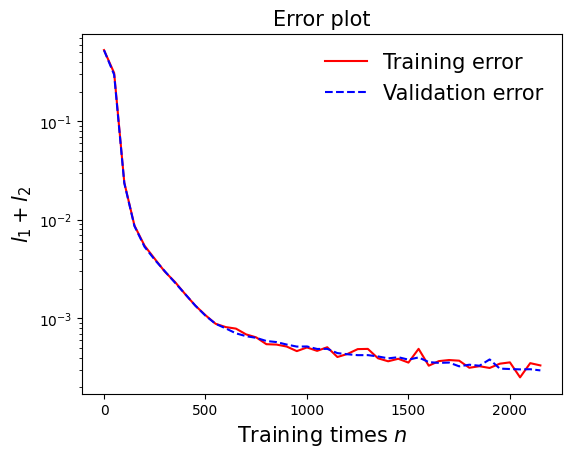

In [80]:
draw_loss(model4)

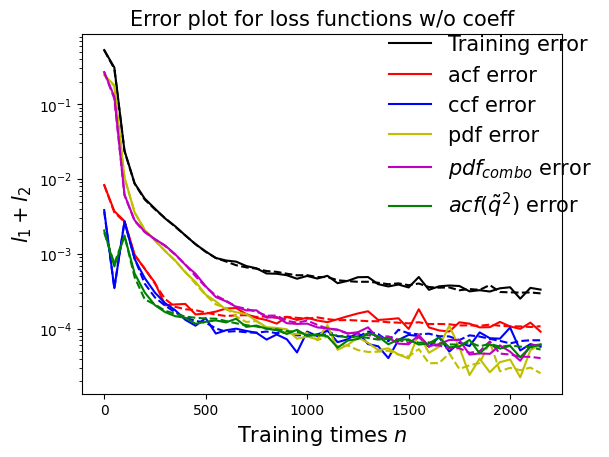

In [81]:
draw_errors(model4)

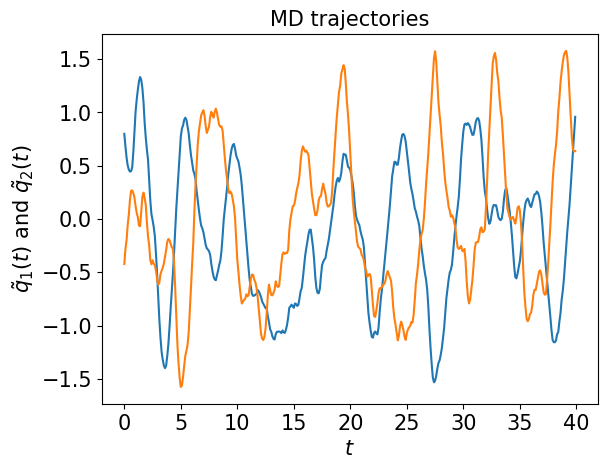

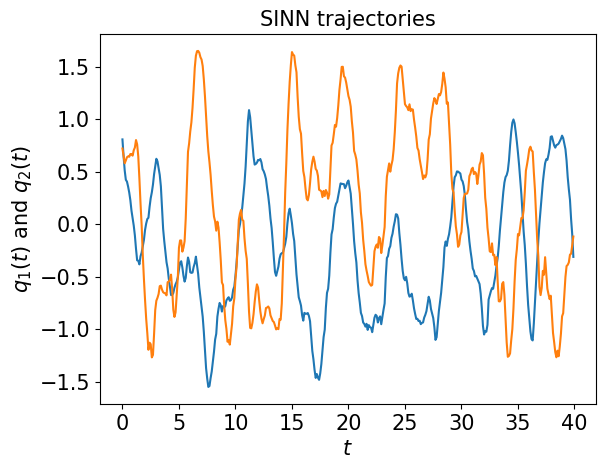

In [82]:
test1(model4)

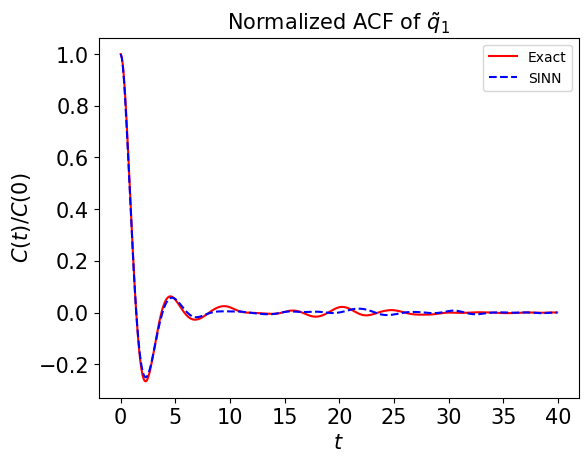

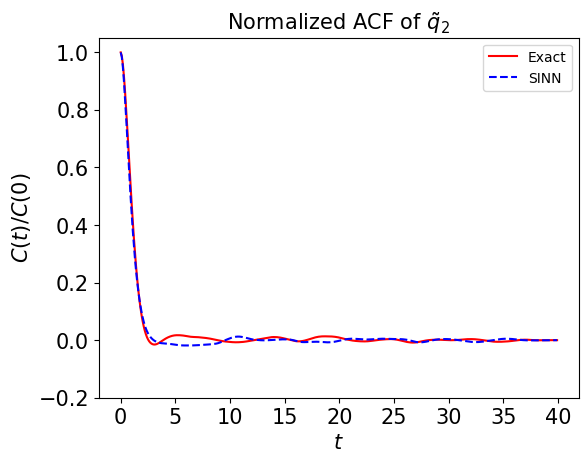

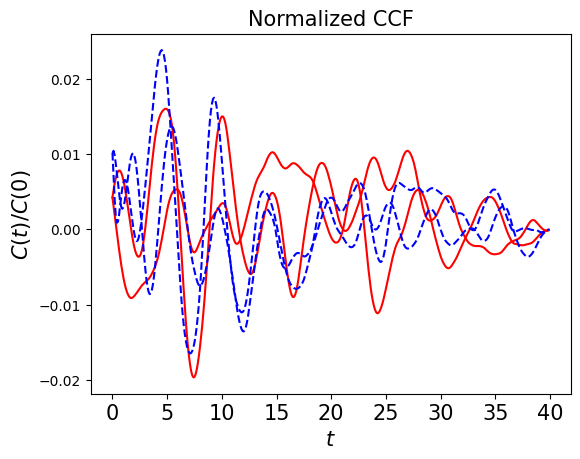

In [83]:
test2(model4)

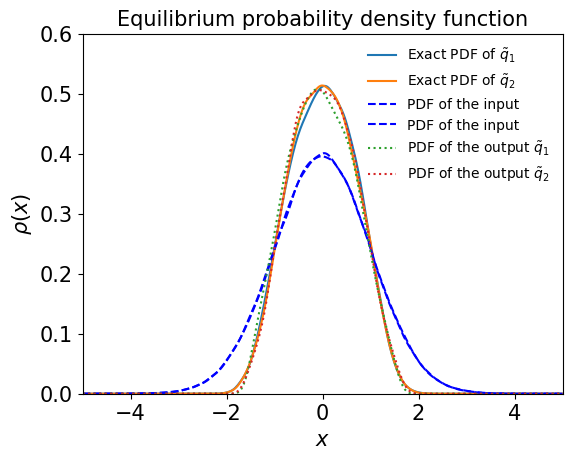

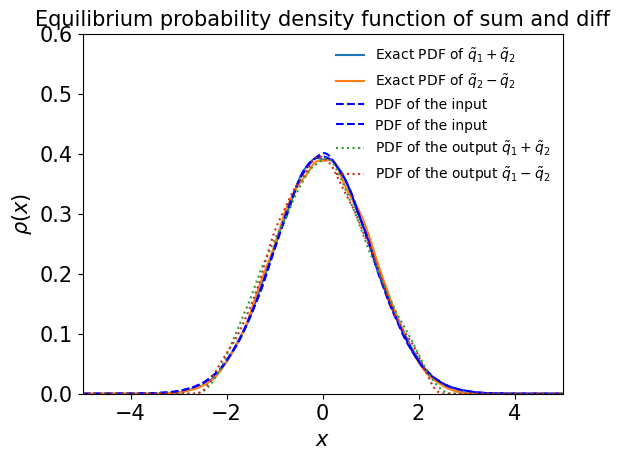

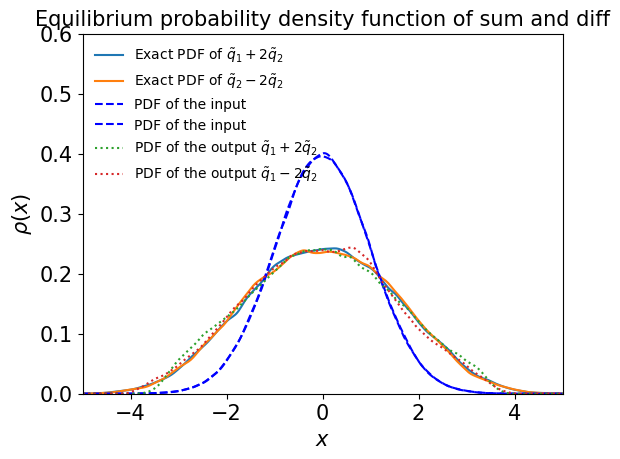

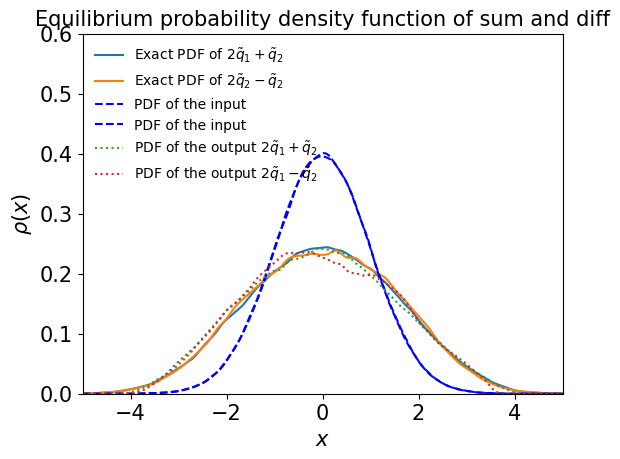

In [84]:
test3(model4)

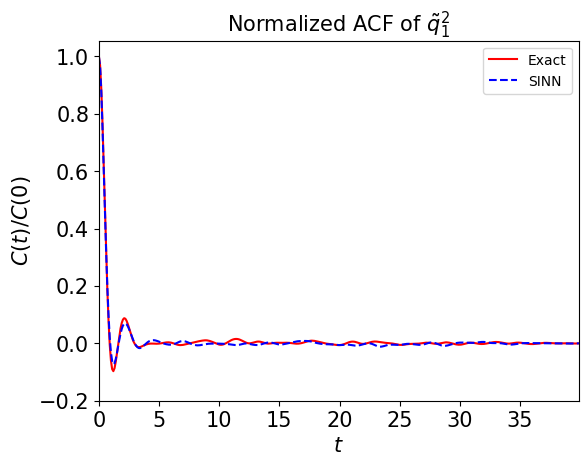

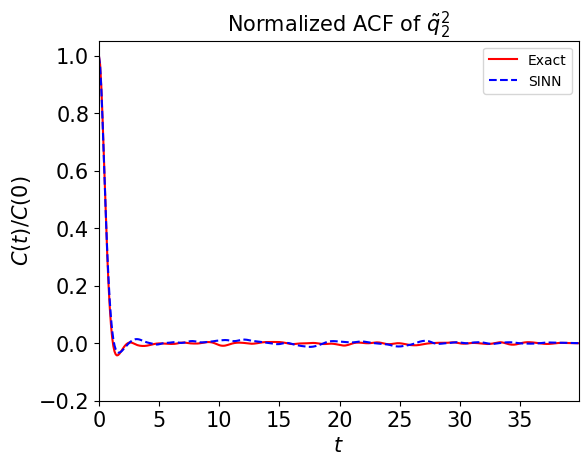

In [85]:
test4(model4)

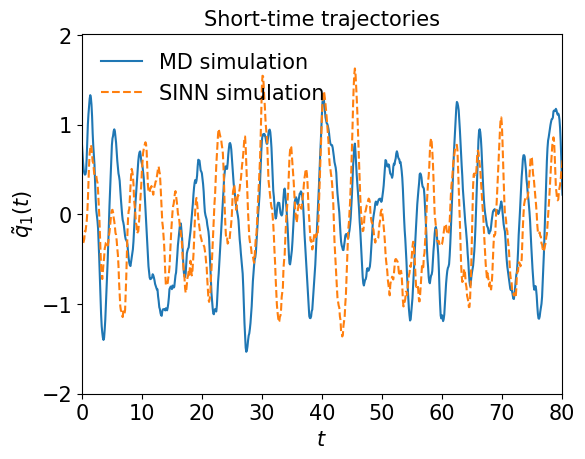

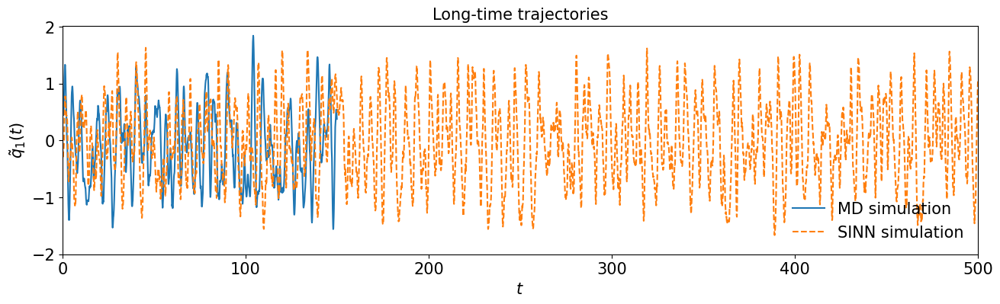

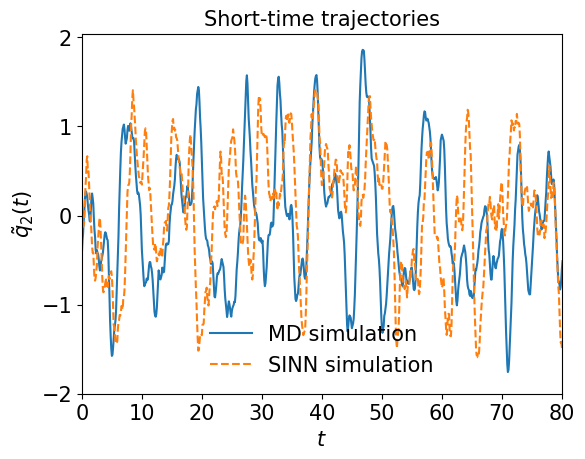

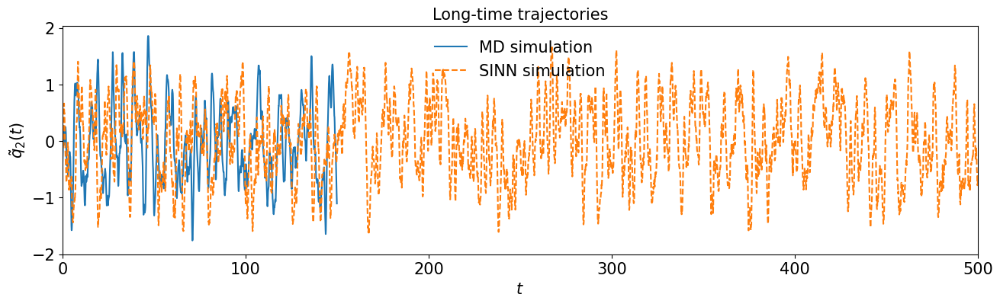

In [86]:
test5(model4)

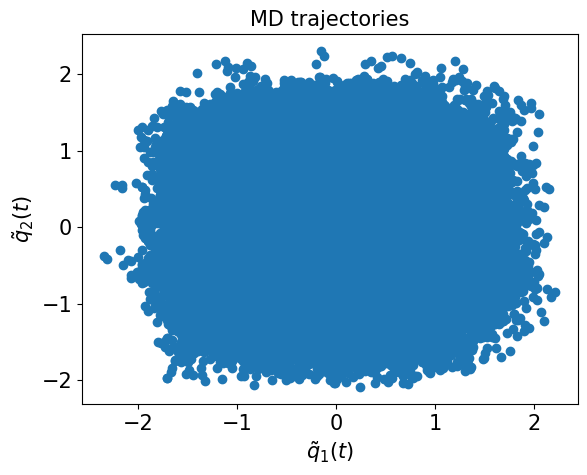

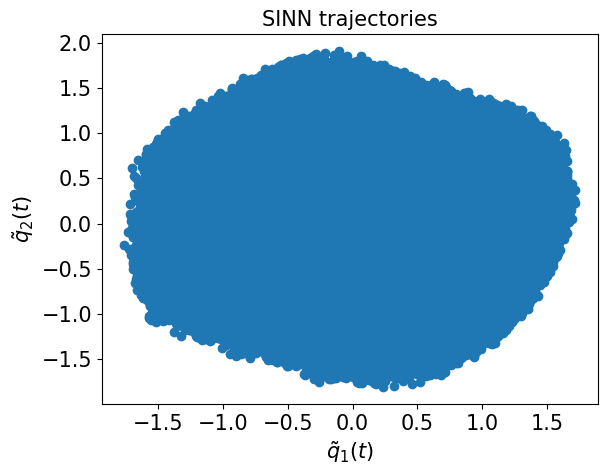

In [87]:
test6(model4)

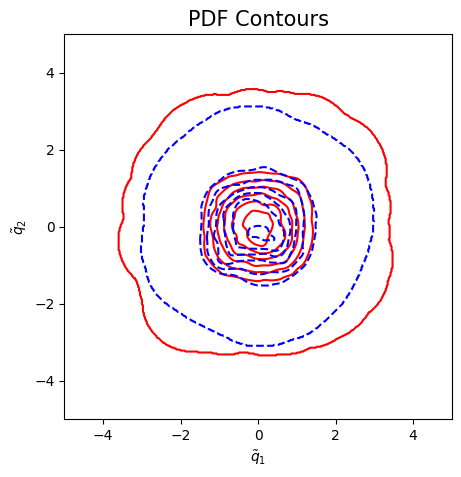

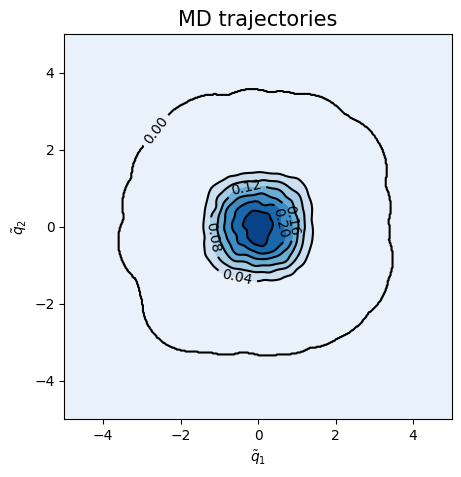

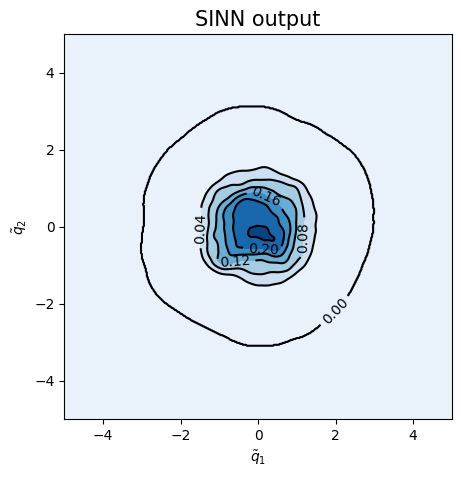

<Figure size 500x500 with 0 Axes>

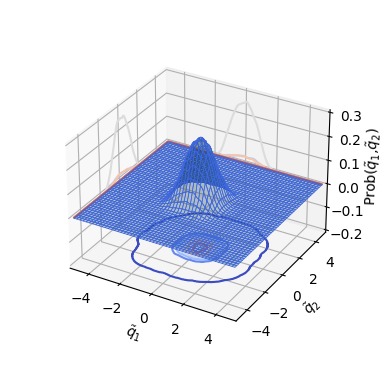

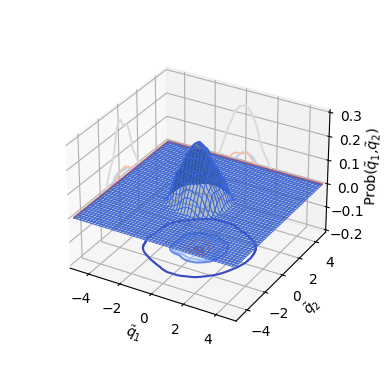

In [88]:
test7(model4)

In [89]:
### Defining SINN model
net5 = SINN(2, 10, 2, 2).to(device)

In [90]:
model5 = Model(net=net5)

In [91]:
model5.train()

[0]-th step loss: 0.5384, 0.5366, acf: 0.01131, ccf: 0.00165, pdf: 0.24750, pdf2: 0.27234, acf2: 0.00383
[50]-th step loss: 0.3869, 0.3788, acf: 0.00599, ccf: 0.00050, pdf: 0.20584, pdf2: 0.16472, acf2: 0.00176
[100]-th step loss: 0.1382, 0.1375, acf: 0.00299, ccf: 0.00033, pdf: 0.12131, pdf2: 0.01164, acf2: 0.00123
[150]-th step loss: 0.0215, 0.0210, acf: 0.00114, ccf: 0.00105, pdf: 0.01149, pdf2: 0.00574, acf2: 0.00153
[200]-th step loss: 0.0069, 0.0069, acf: 0.00084, ccf: 0.00148, pdf: 0.00221, pdf2: 0.00189, acf2: 0.00045
[250]-th step loss: 0.0045, 0.0046, acf: 0.00099, ccf: 0.00046, pdf: 0.00150, pdf2: 0.00129, acf2: 0.00040
[300]-th step loss: 0.0034, 0.0035, acf: 0.00091, ccf: 0.00019, pdf: 0.00105, pdf2: 0.00102, acf2: 0.00035
[350]-th step loss: 0.0026, 0.0027, acf: 0.00072, ccf: 0.00013, pdf: 0.00073, pdf2: 0.00081, acf2: 0.00029
[400]-th step loss: 0.0020, 0.0020, acf: 0.00048, ccf: 0.00012, pdf: 0.00050, pdf2: 0.00064, acf2: 0.00022
[450]-th step loss: 0.0014, 0.0014, acf:

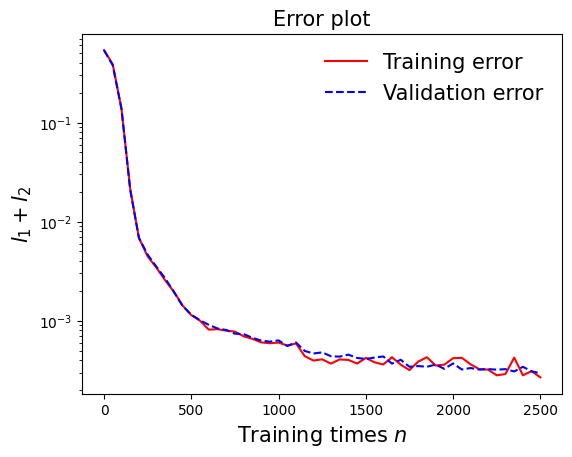

In [92]:
draw_loss(model5)

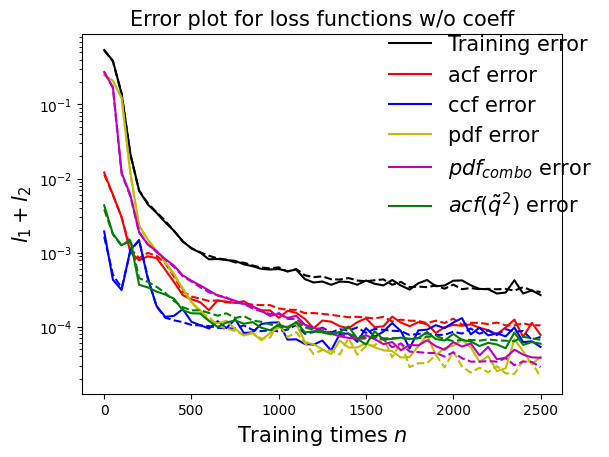

In [93]:
draw_errors(model5)

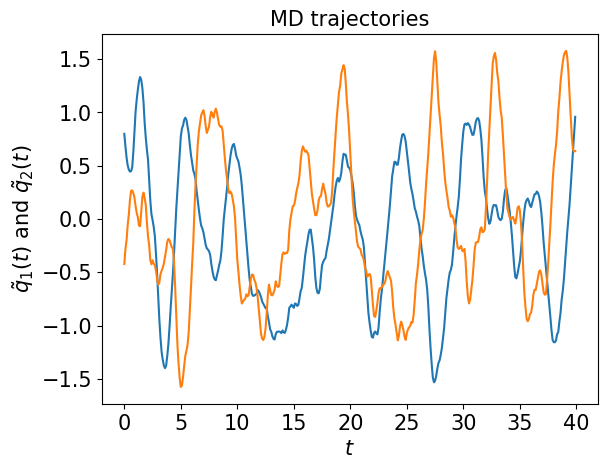

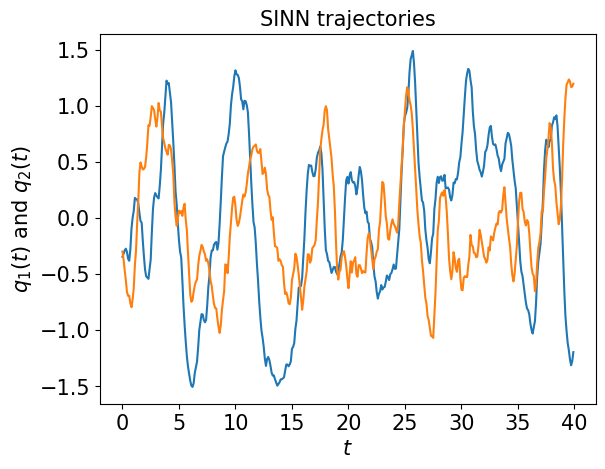

In [94]:
test1(model5)

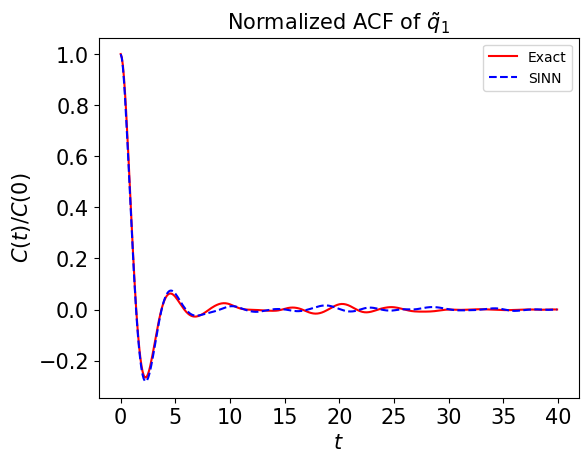

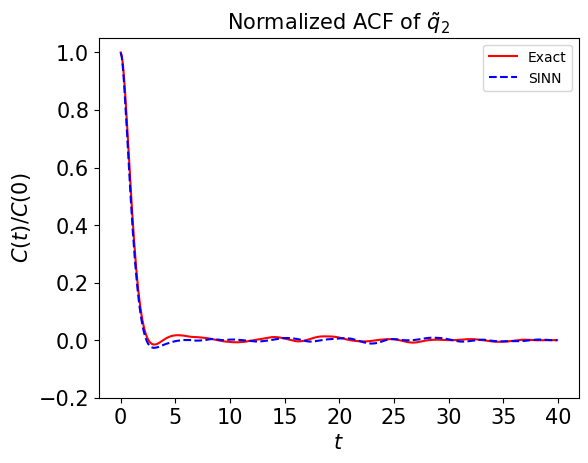

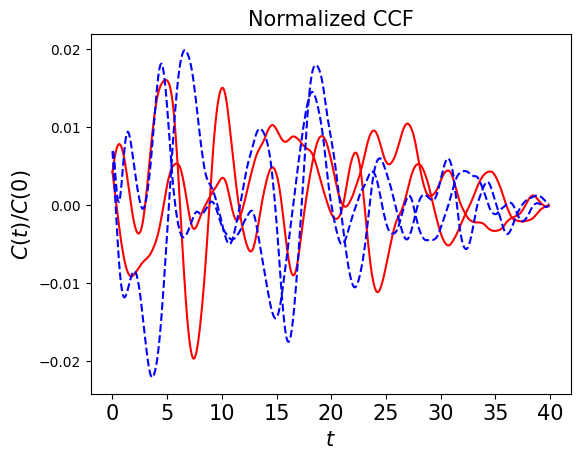

In [95]:
test2(model5)

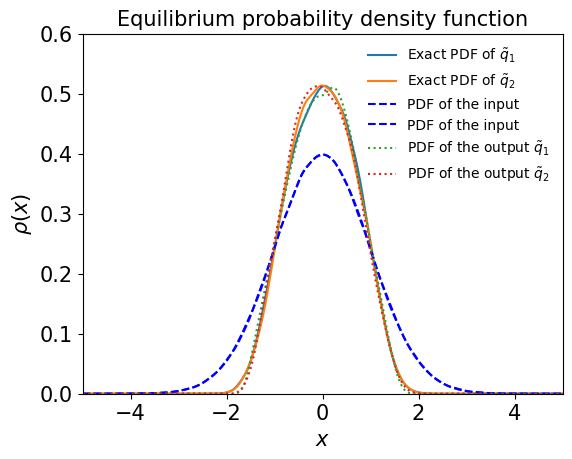

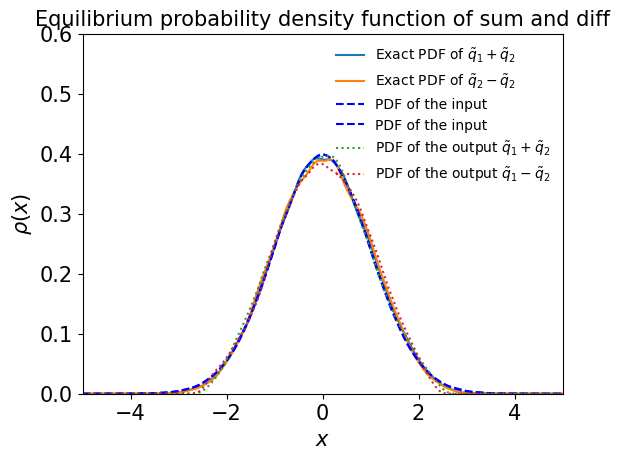

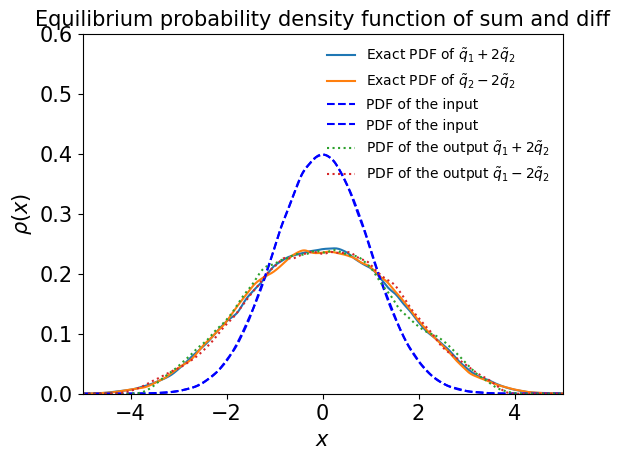

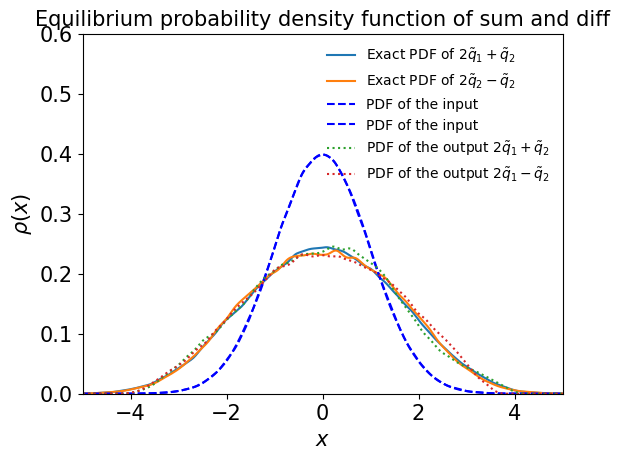

In [96]:
test3(model5)

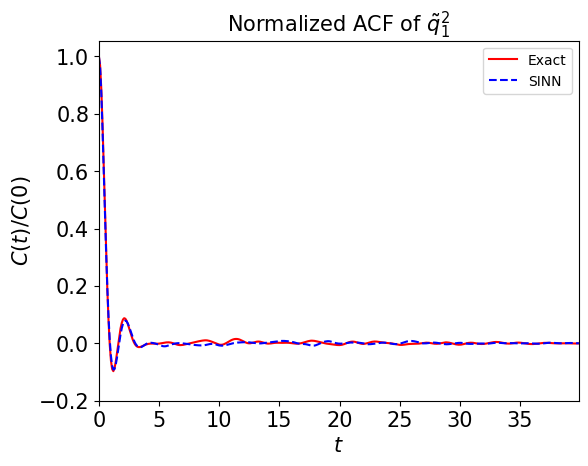

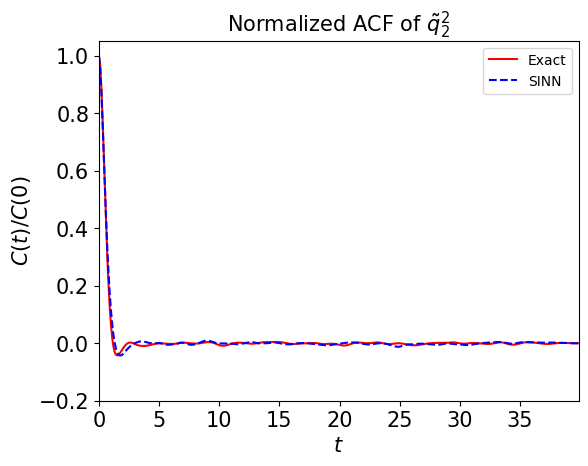

In [97]:
test4(model5)

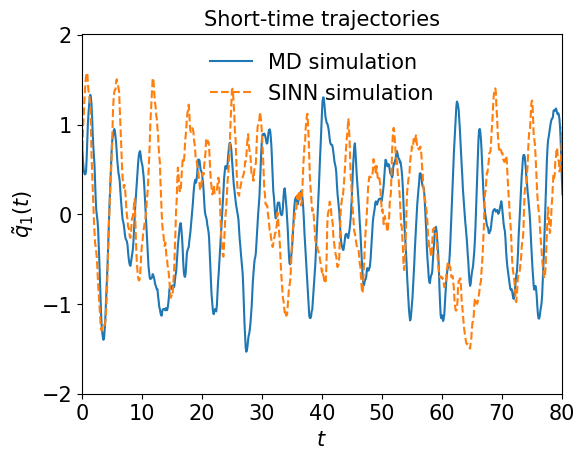

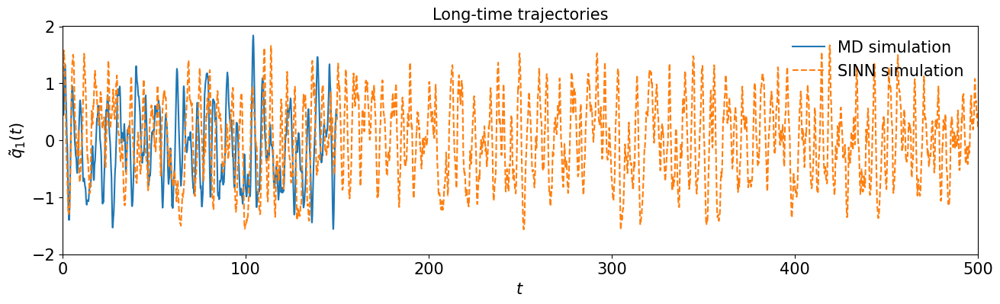

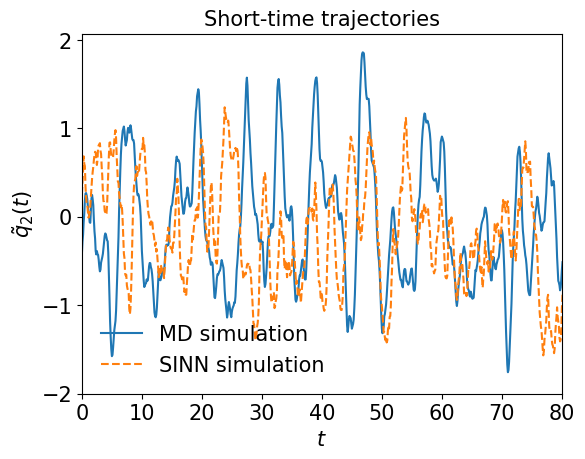

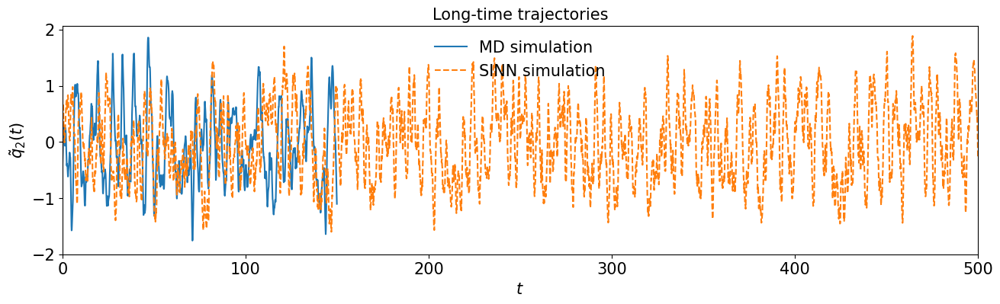

In [98]:
test5(model5)

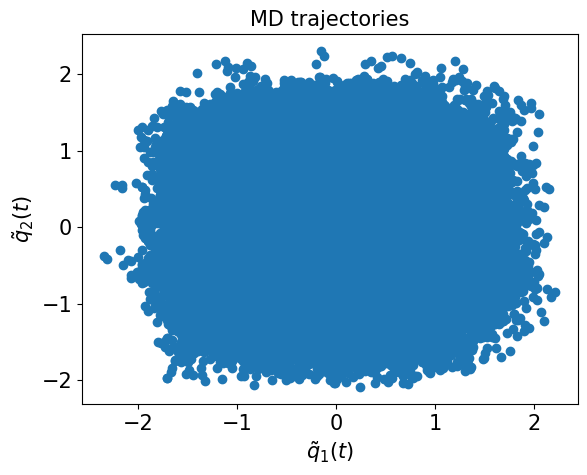

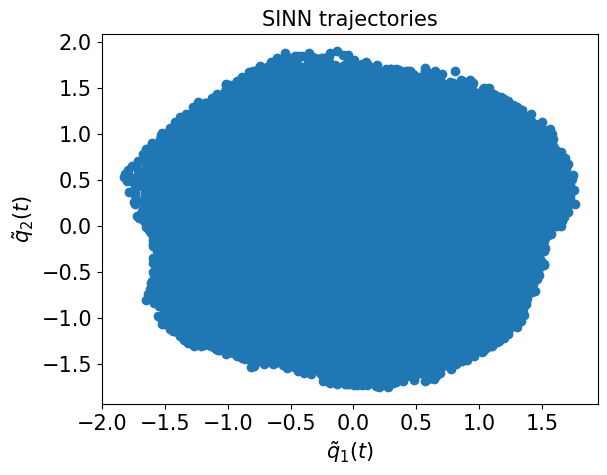

In [99]:
test6(model5)

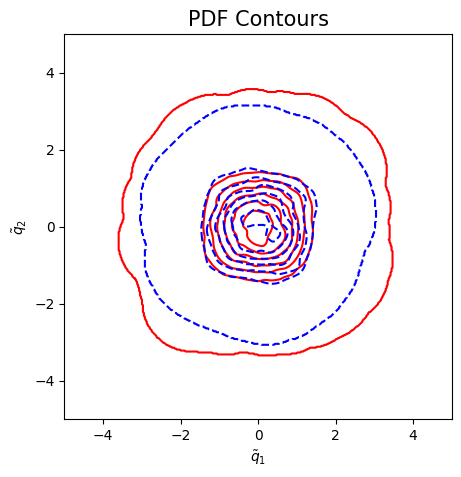

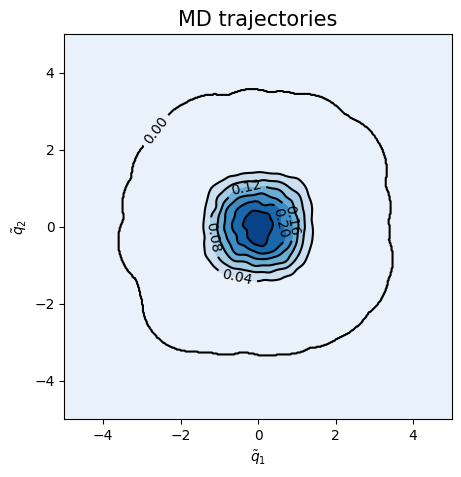

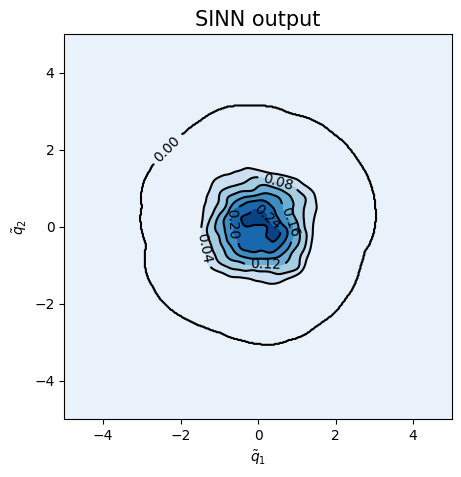

<Figure size 500x500 with 0 Axes>

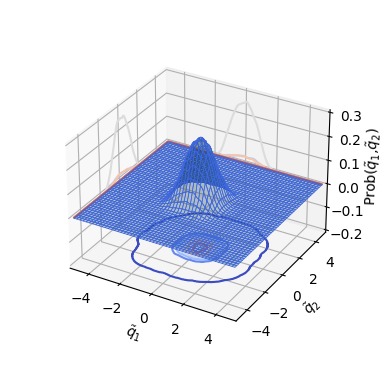

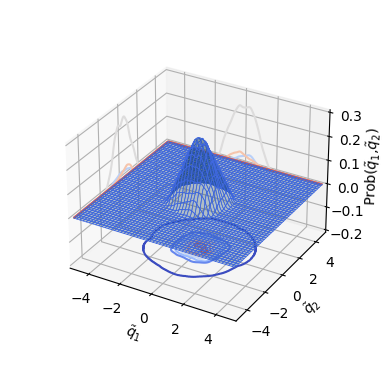

In [100]:
test7(model5)

In [101]:
### Defining SINN model
net6 = SINN(2, 10, 2, 2).to(device)

In [102]:
model6 = Model(net=net6)

In [103]:
model6.train()

[0]-th step loss: 0.5334, 0.5324, acf: 0.00778, ccf: 0.00451, pdf: 0.24855, pdf2: 0.26991, acf2: 0.00168
[50]-th step loss: 0.2823, 0.2695, acf: 0.00268, ccf: 0.00946, pdf: 0.14134, pdf2: 0.11518, acf2: 0.00085
[100]-th step loss: 0.0560, 0.0550, acf: 0.00242, ccf: 0.01245, pdf: 0.01864, pdf2: 0.01998, acf2: 0.00155
[150]-th step loss: 0.0165, 0.0161, acf: 0.00212, ccf: 0.00635, pdf: 0.00283, pdf2: 0.00442, acf2: 0.00036
[200]-th step loss: 0.0105, 0.0105, acf: 0.00244, ccf: 0.00292, pdf: 0.00172, pdf2: 0.00304, acf2: 0.00038
[250]-th step loss: 0.0069, 0.0071, acf: 0.00226, ccf: 0.00114, pdf: 0.00102, pdf2: 0.00226, acf2: 0.00039
[300]-th step loss: 0.0050, 0.0050, acf: 0.00194, ccf: 0.00036, pdf: 0.00064, pdf2: 0.00167, acf2: 0.00037
[350]-th step loss: 0.0039, 0.0039, acf: 0.00167, ccf: 0.00015, pdf: 0.00045, pdf2: 0.00125, acf2: 0.00037
[400]-th step loss: 0.0032, 0.0032, acf: 0.00148, ccf: 0.00008, pdf: 0.00031, pdf2: 0.00099, acf2: 0.00035
[450]-th step loss: 0.0027, 0.0027, acf:

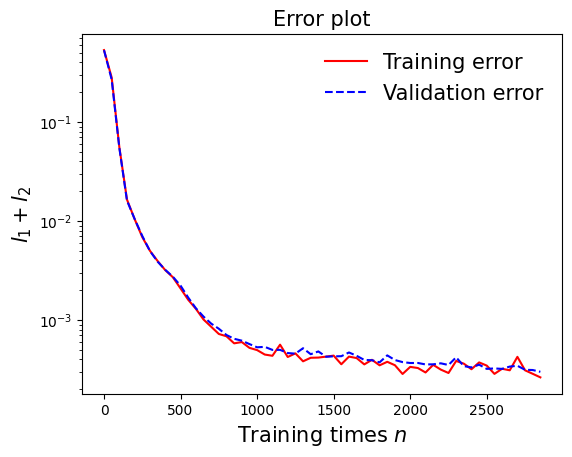

In [104]:
draw_loss(model6)

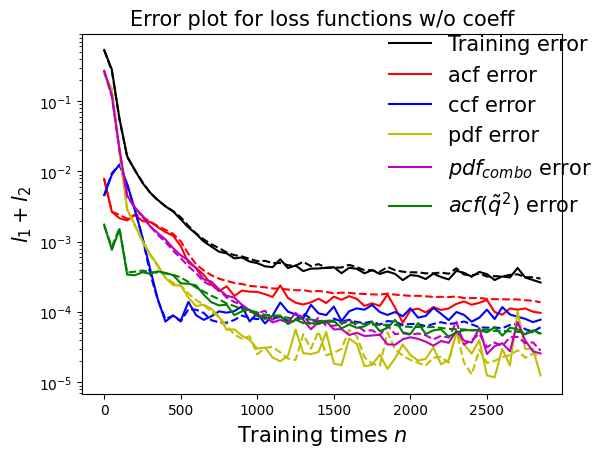

In [105]:
draw_errors(model6)

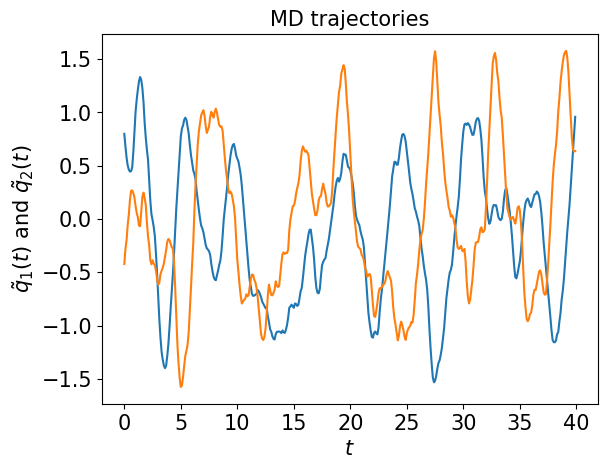

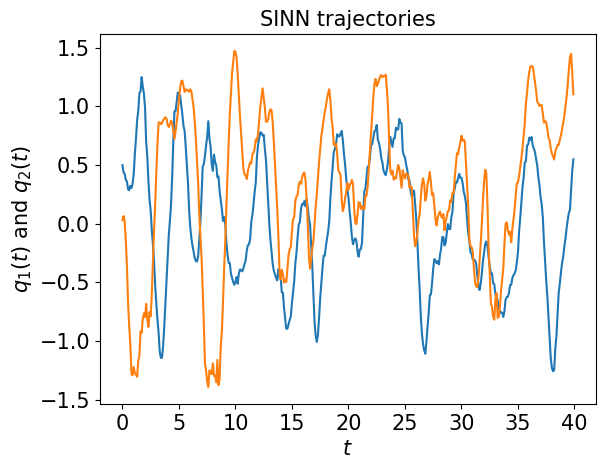

In [106]:
test1(model6)

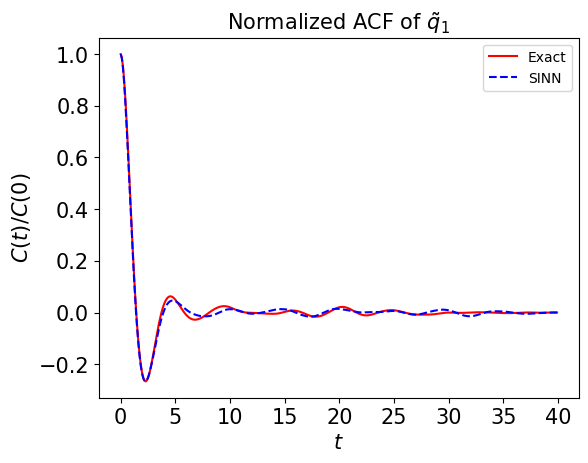

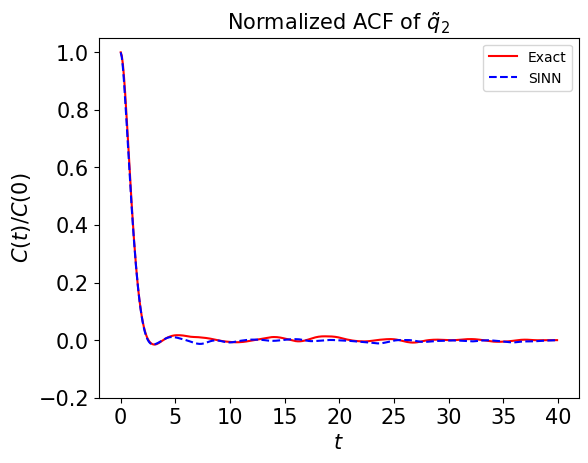

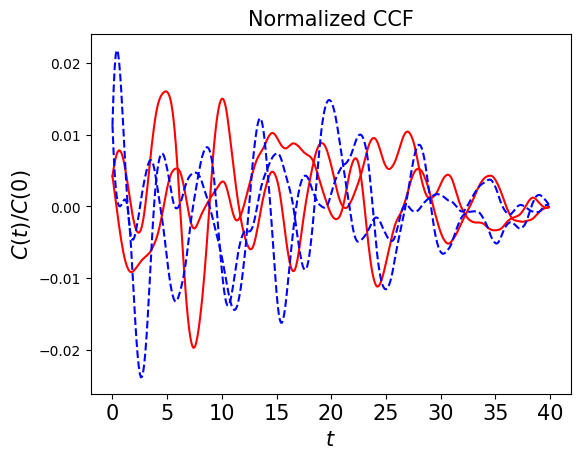

In [107]:
test2(model6)

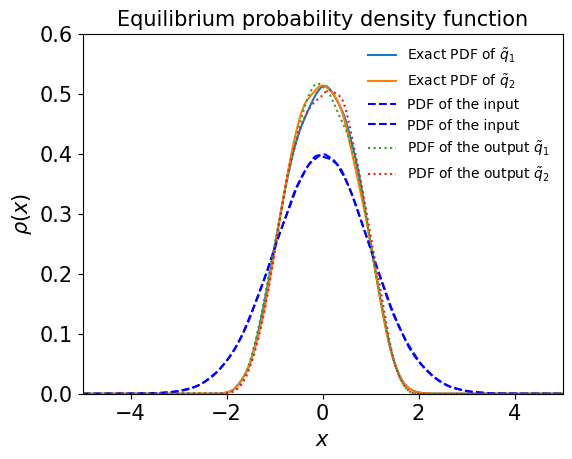

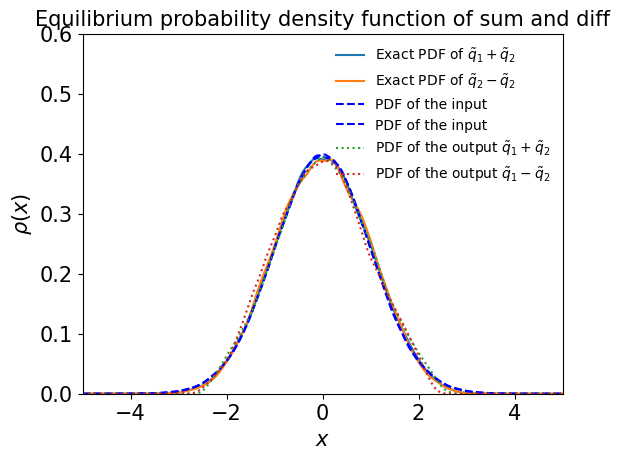

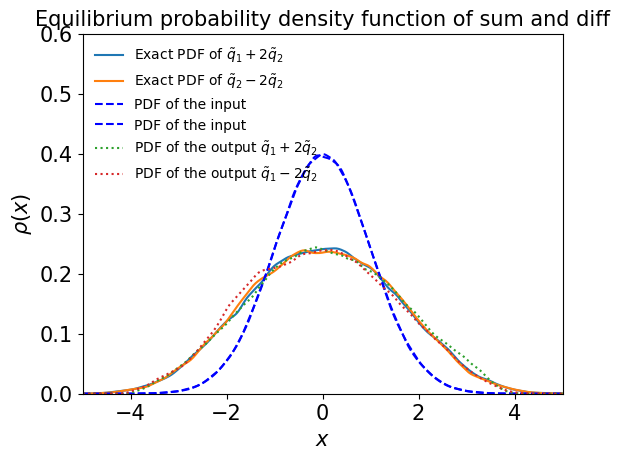

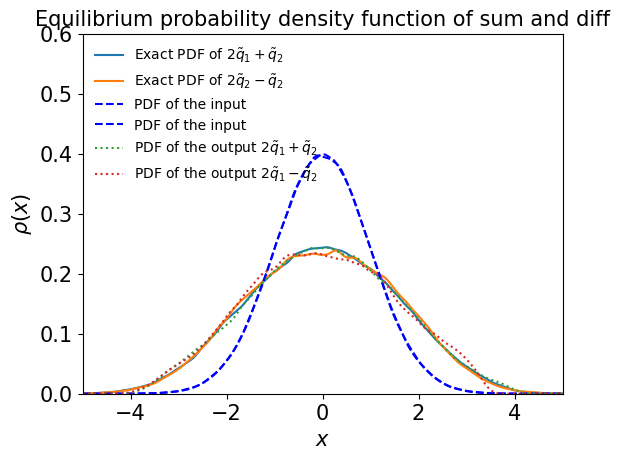

In [108]:
test3(model6)

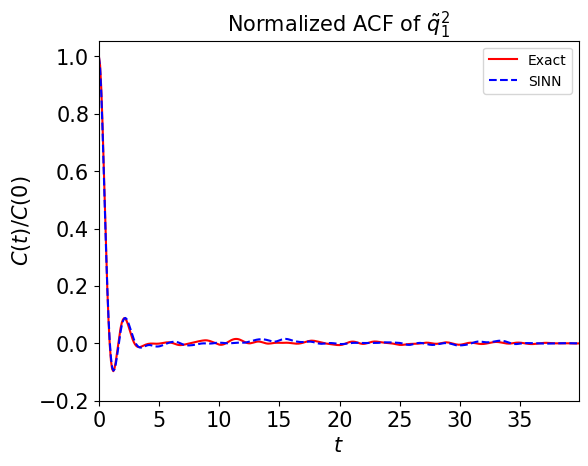

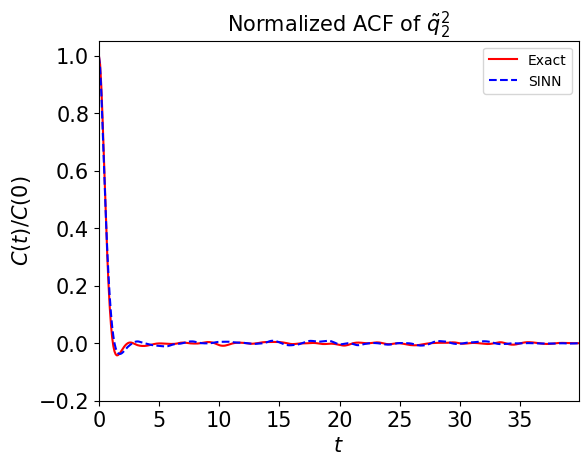

In [109]:
test4(model6)

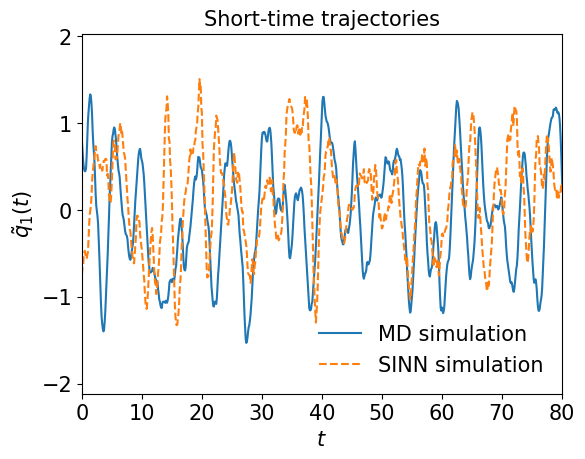

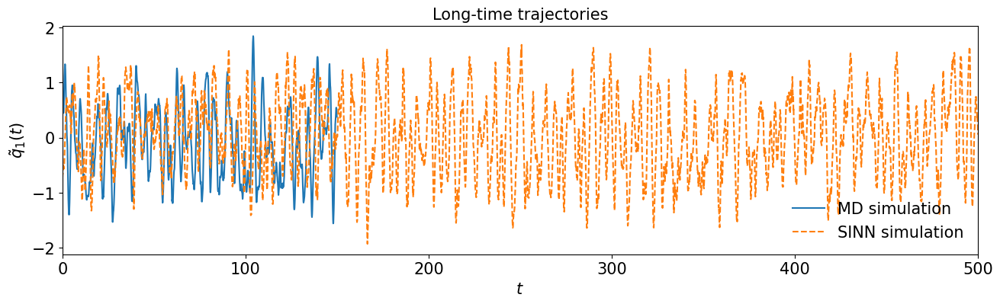

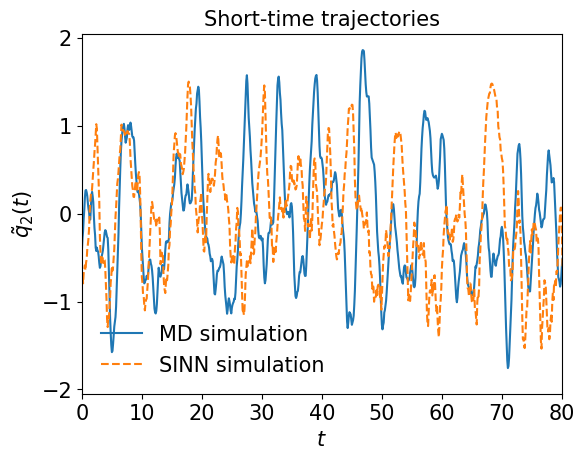

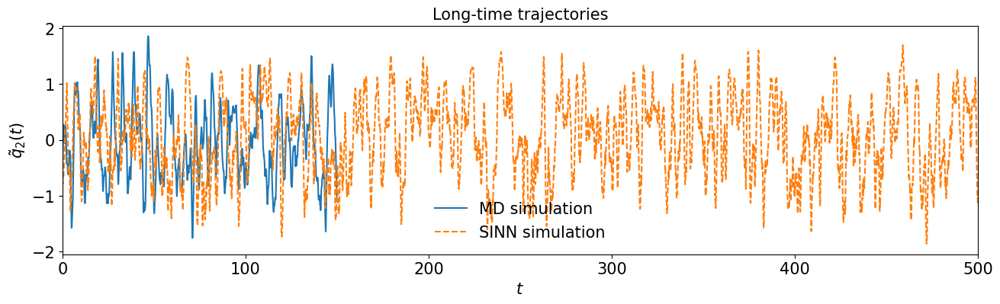

In [110]:
test5(model6)

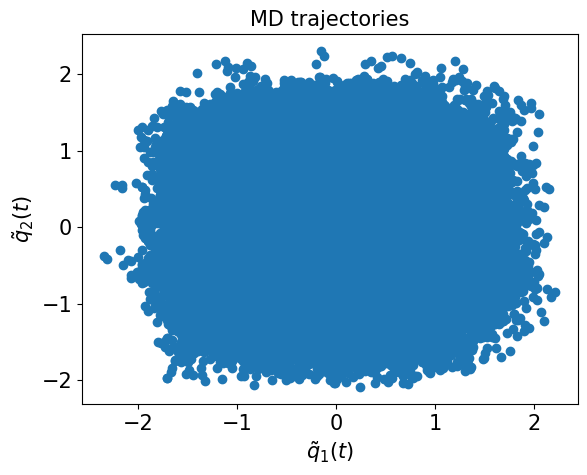

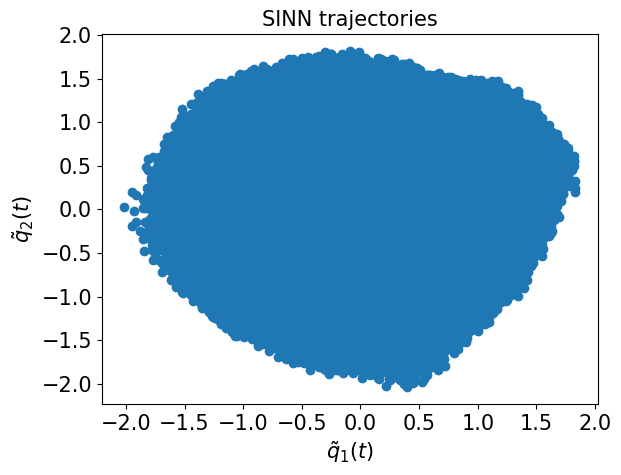

In [111]:
test6(model6)

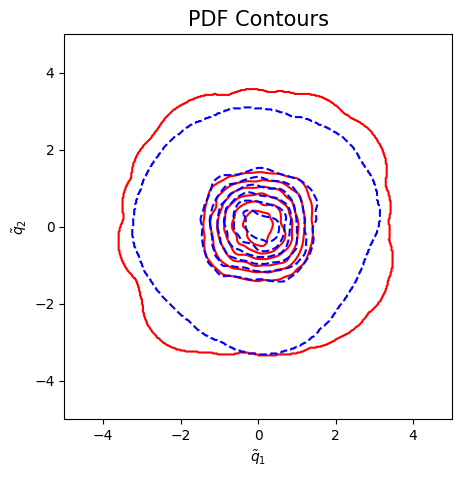

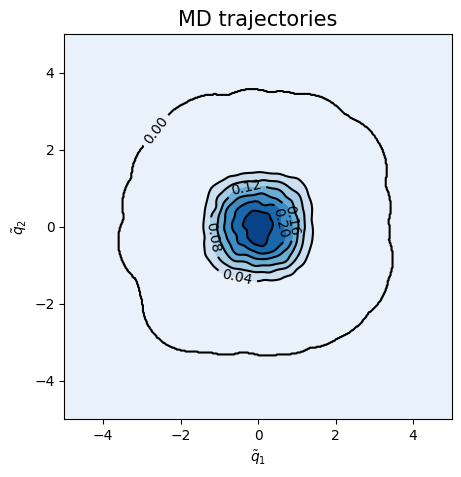

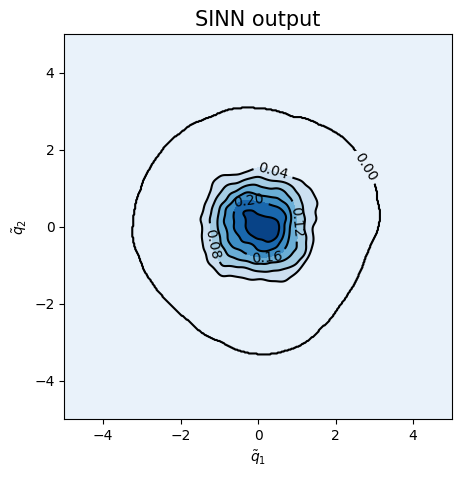

<Figure size 500x500 with 0 Axes>

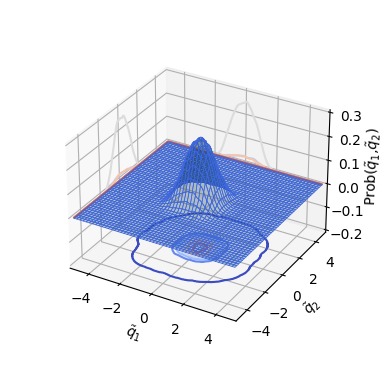

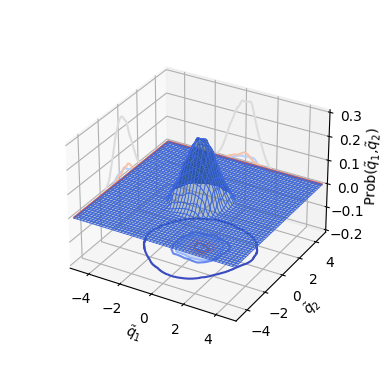

In [112]:
test7(model6)

In [113]:
### Defining SINN model
net7 = SINN(2, 10, 2, 2).to(device)

In [114]:
model7 = Model(net=net7)

In [115]:
model7.train()

[0]-th step loss: 0.5329, 0.5314, acf: 0.00805, ccf: 0.00177, pdf: 0.24894, pdf2: 0.27075, acf2: 0.00187
[50]-th step loss: 0.2488, 0.2395, acf: 0.00348, ccf: 0.00028, pdf: 0.15773, pdf2: 0.07698, acf2: 0.00106
[100]-th step loss: 0.0691, 0.0672, acf: 0.00565, ccf: 0.00054, pdf: 0.04057, pdf2: 0.01653, acf2: 0.00393
[150]-th step loss: 0.0203, 0.0199, acf: 0.00200, ccf: 0.00028, pdf: 0.00939, pdf2: 0.00652, acf2: 0.00175
[200]-th step loss: 0.0077, 0.0077, acf: 0.00126, ccf: 0.00031, pdf: 0.00282, pdf2: 0.00272, acf2: 0.00061
[250]-th step loss: 0.0050, 0.0051, acf: 0.00102, ccf: 0.00030, pdf: 0.00134, pdf2: 0.00200, acf2: 0.00044
[300]-th step loss: 0.0039, 0.0040, acf: 0.00093, ccf: 0.00025, pdf: 0.00078, pdf2: 0.00161, acf2: 0.00043
[350]-th step loss: 0.0032, 0.0033, acf: 0.00084, ccf: 0.00018, pdf: 0.00055, pdf2: 0.00133, acf2: 0.00041
[400]-th step loss: 0.0028, 0.0028, acf: 0.00072, ccf: 0.00018, pdf: 0.00048, pdf2: 0.00105, acf2: 0.00037
[450]-th step loss: 0.0024, 0.0024, acf:

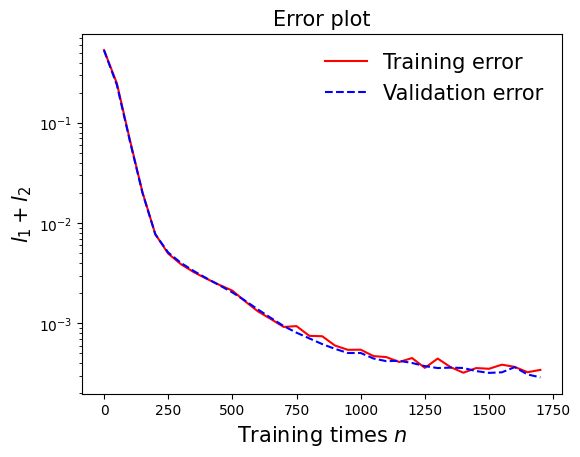

In [116]:
draw_loss(model7)

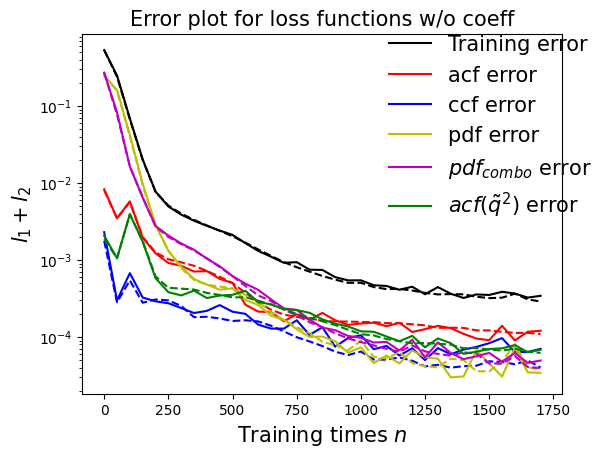

In [117]:
draw_errors(model7)

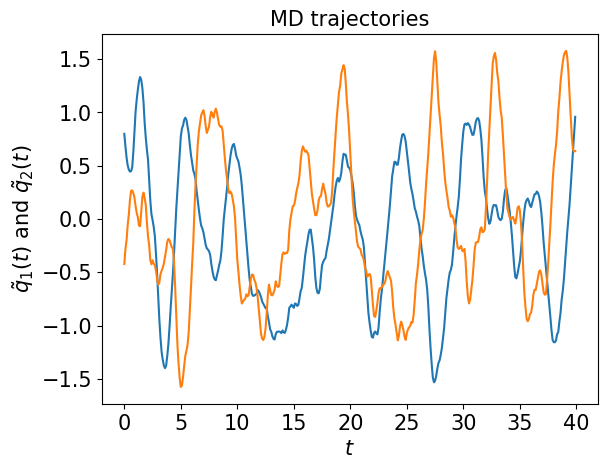

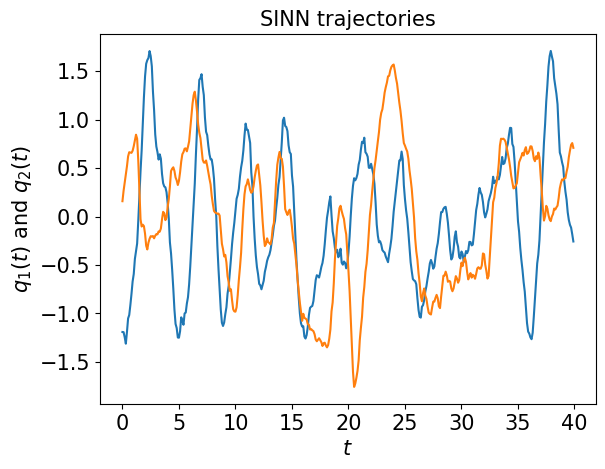

In [118]:
test1(model7)

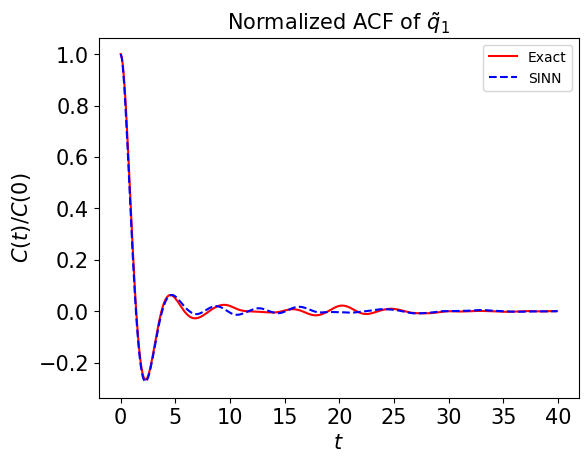

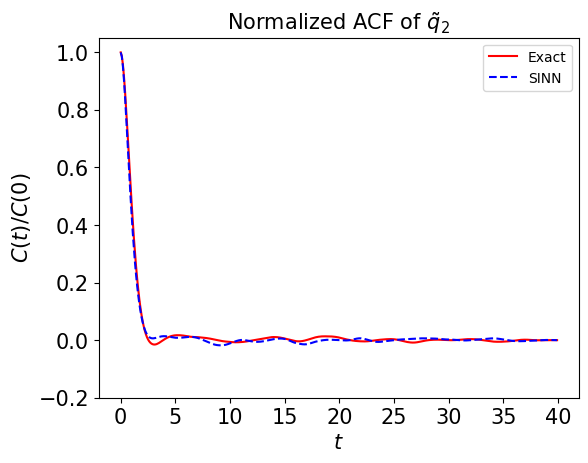

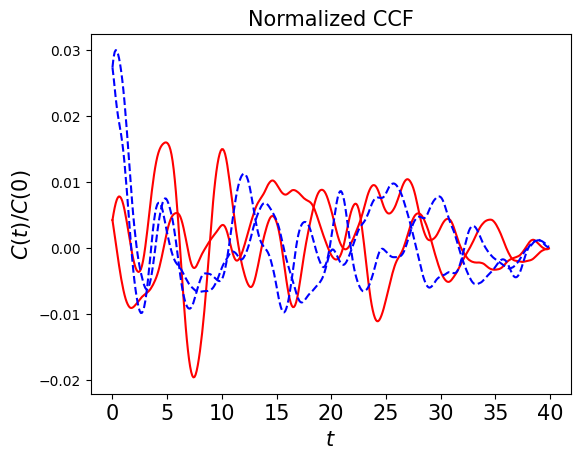

In [119]:
test2(model7)

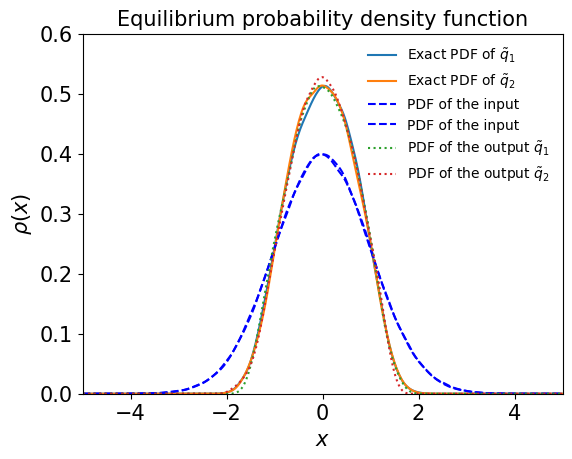

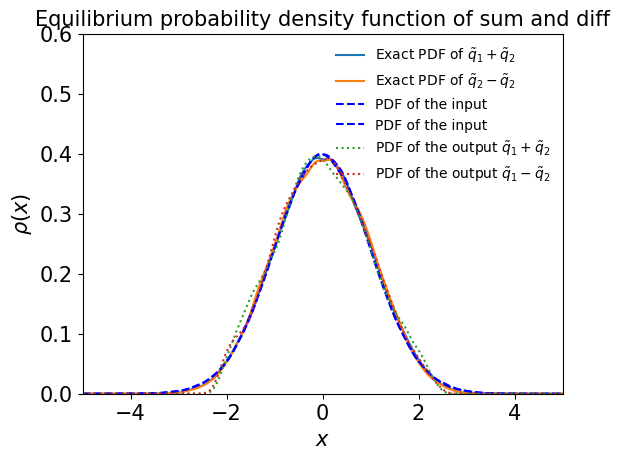

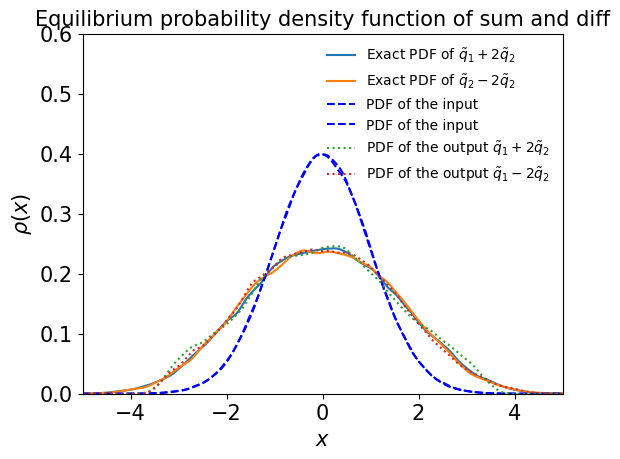

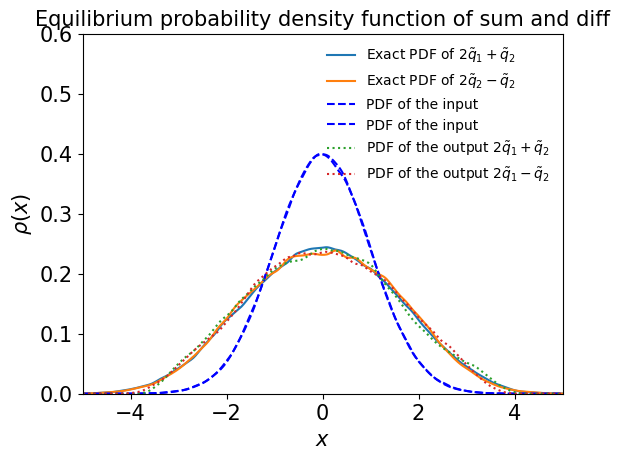

In [120]:
test3(model7)

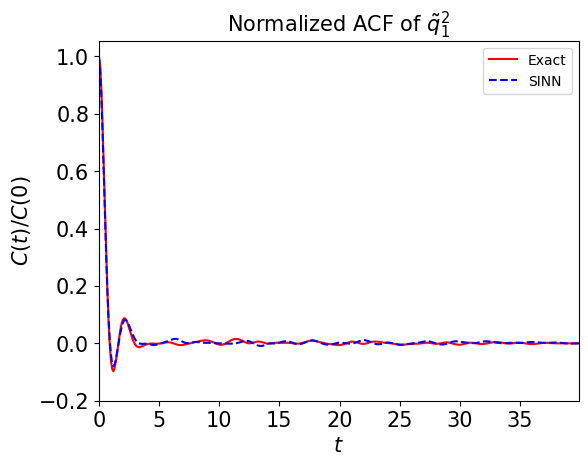

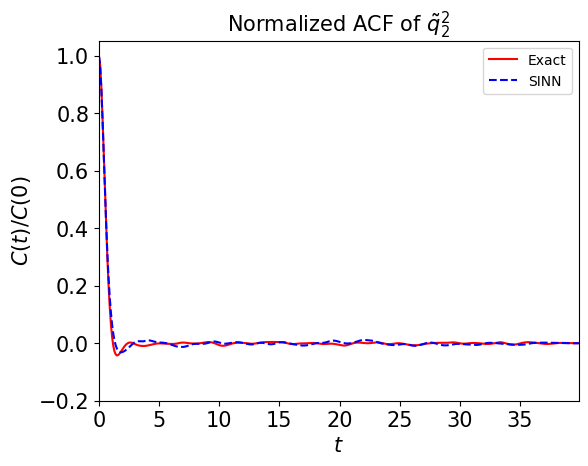

In [121]:
test4(model7)

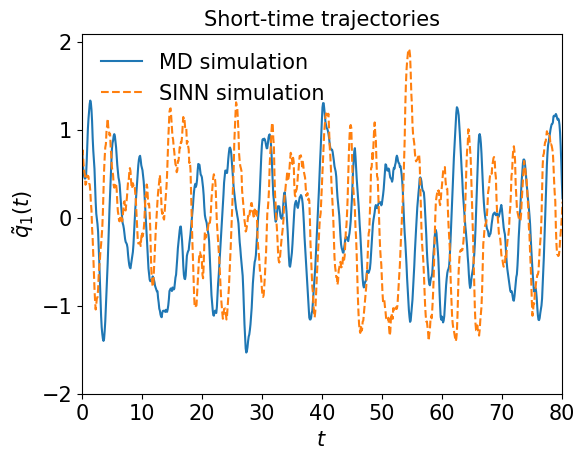

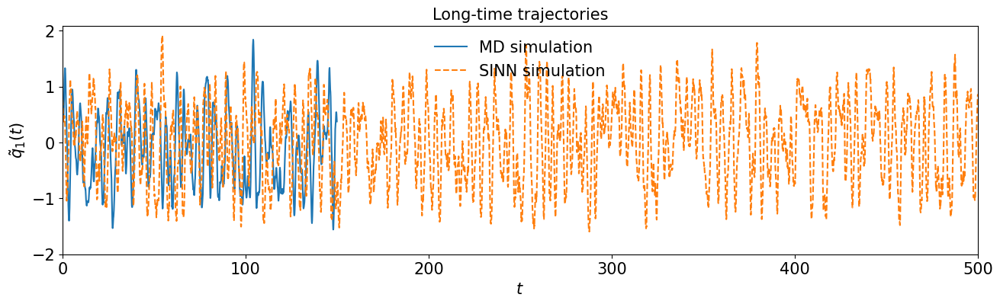

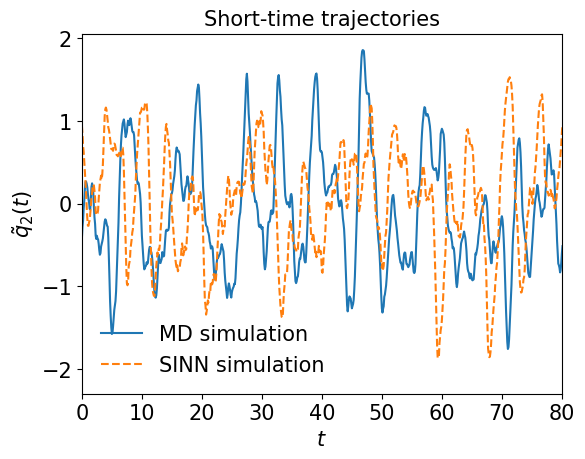

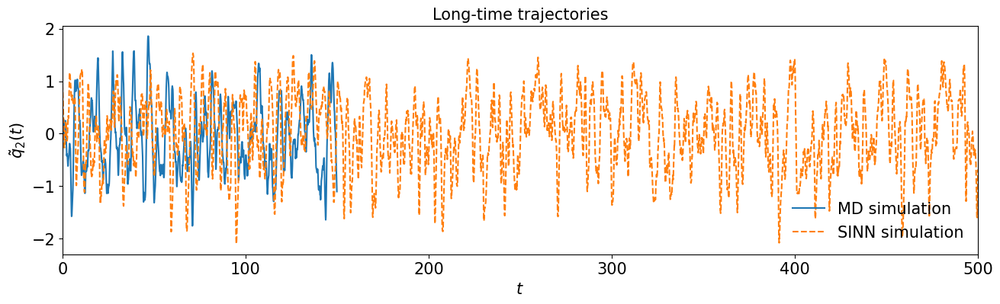

In [122]:
test5(model7)

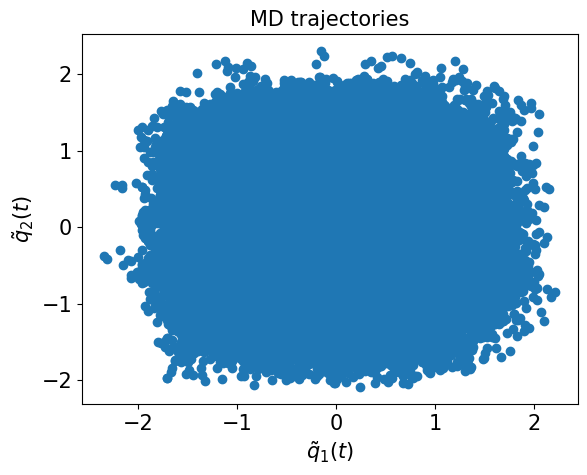

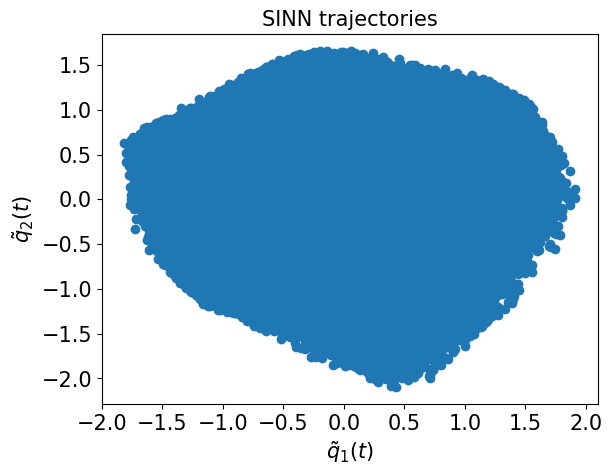

In [123]:
test6(model7)

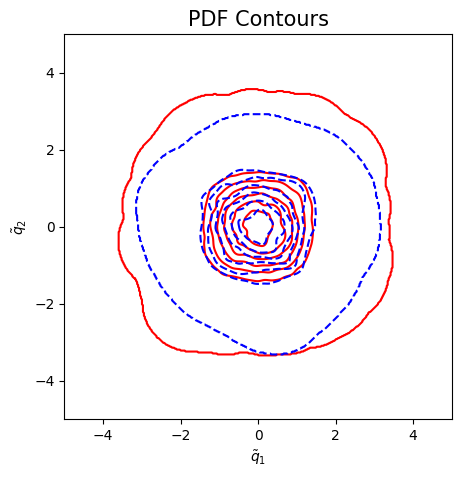

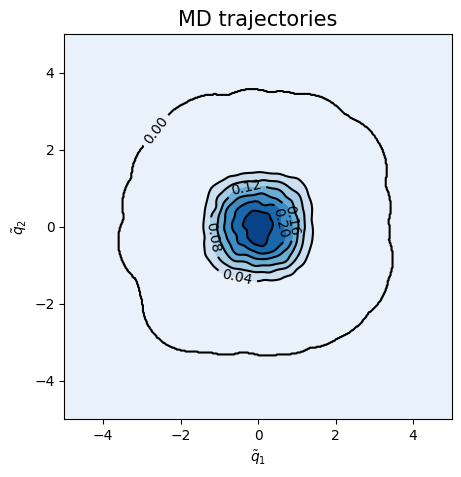

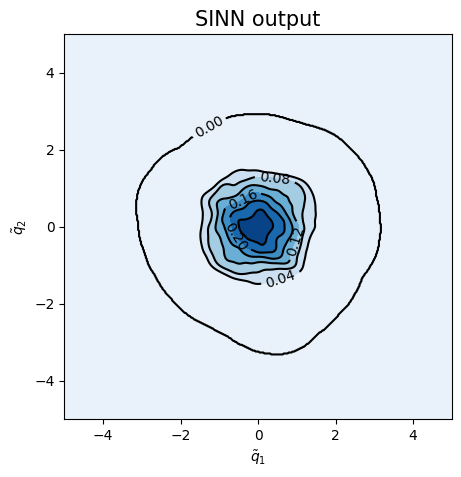

<Figure size 500x500 with 0 Axes>

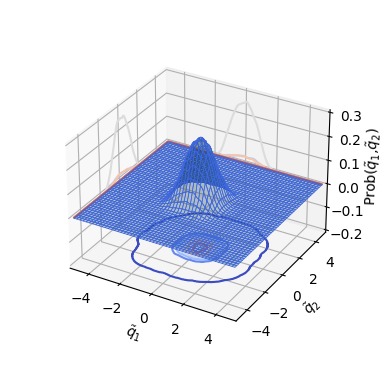

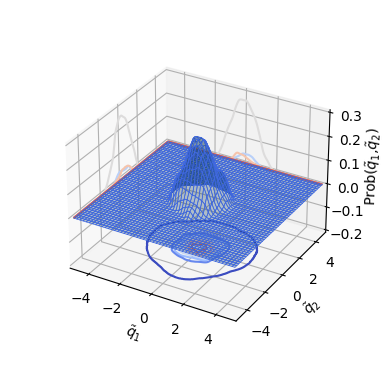

In [124]:
test7(model7)

In [125]:
### Defining SINN model
net8 = SINN(2, 10, 2, 2).to(device)

In [126]:
model8 = Model(net=net8)

In [127]:
model8.train()

[0]-th step loss: 0.5396, 0.5384, acf: 0.01300, ccf: 0.00068, pdf: 0.24744, pdf2: 0.27224, acf2: 0.00503
[50]-th step loss: 0.3854, 0.3733, acf: 0.00364, ccf: 0.00065, pdf: 0.20387, pdf2: 0.16463, acf2: 0.00050
[100]-th step loss: 0.0391, 0.0380, acf: 0.00105, ccf: 0.00672, pdf: 0.01909, pdf2: 0.00943, acf2: 0.00170
[150]-th step loss: 0.0209, 0.0205, acf: 0.00079, ccf: 0.00558, pdf: 0.00889, pdf2: 0.00429, acf2: 0.00092
[200]-th step loss: 0.0136, 0.0135, acf: 0.00132, ccf: 0.00337, pdf: 0.00541, pdf2: 0.00273, acf2: 0.00068
[250]-th step loss: 0.0099, 0.0098, acf: 0.00173, ccf: 0.00204, pdf: 0.00361, pdf2: 0.00199, acf2: 0.00043
[300]-th step loss: 0.0075, 0.0076, acf: 0.00179, ccf: 0.00144, pdf: 0.00249, pdf2: 0.00157, acf2: 0.00034
[350]-th step loss: 0.0060, 0.0061, acf: 0.00171, ccf: 0.00095, pdf: 0.00184, pdf2: 0.00123, acf2: 0.00036
[400]-th step loss: 0.0046, 0.0048, acf: 0.00159, ccf: 0.00052, pdf: 0.00129, pdf2: 0.00100, acf2: 0.00039
[450]-th step loss: 0.0034, 0.0036, acf:

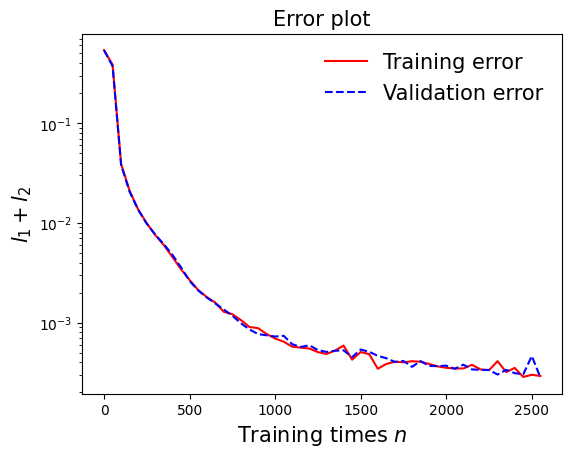

In [128]:
draw_loss(model8)

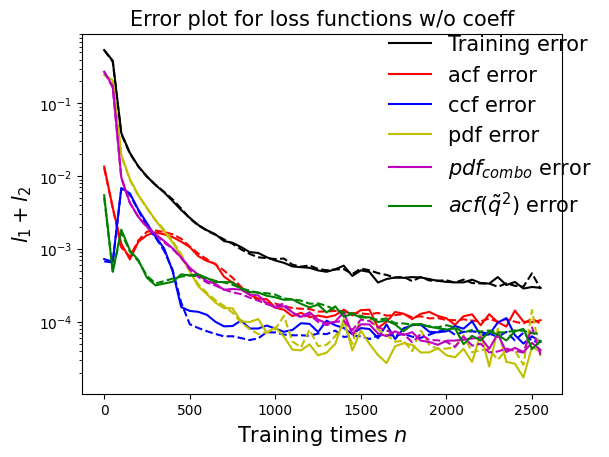

In [129]:
draw_errors(model8)

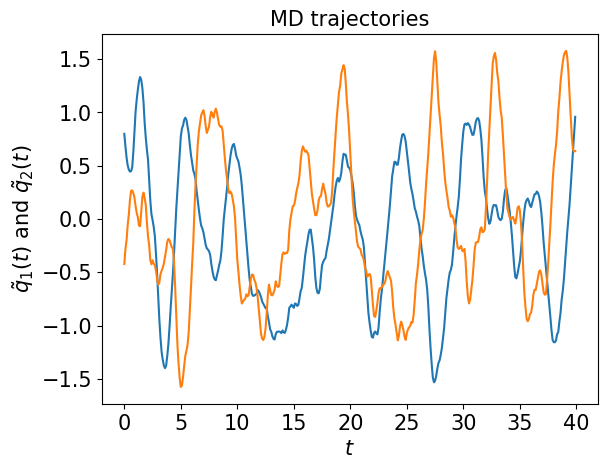

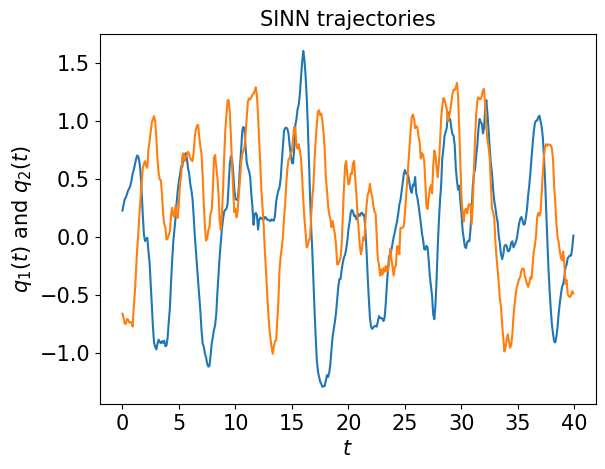

In [130]:
test1(model8)

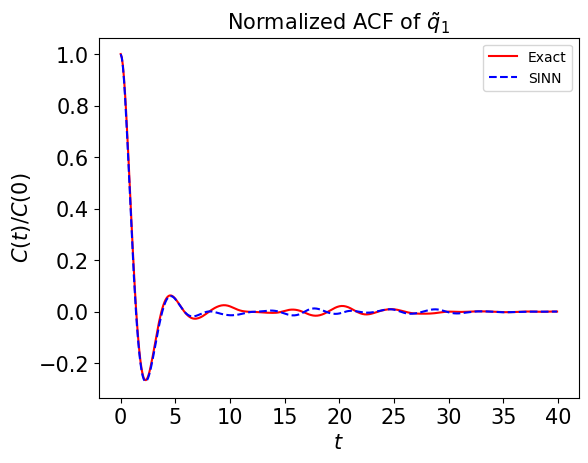

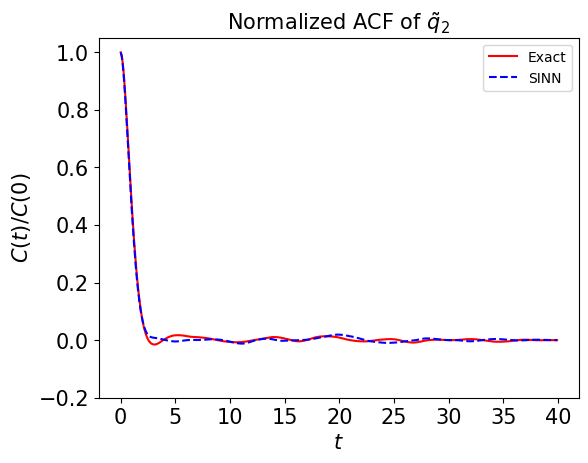

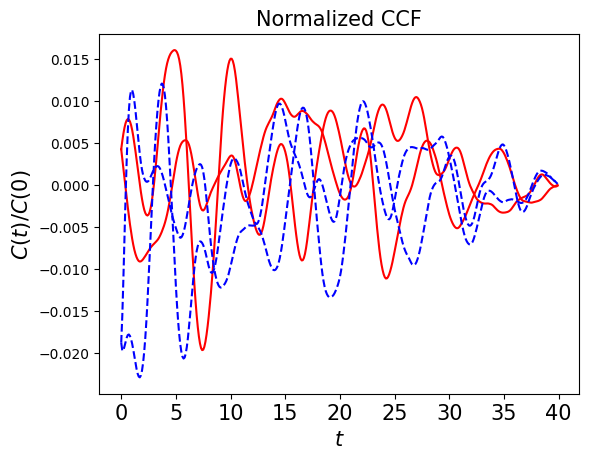

In [131]:
test2(model8)

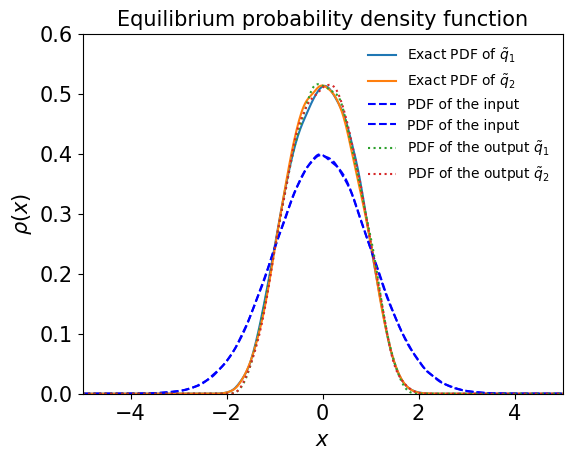

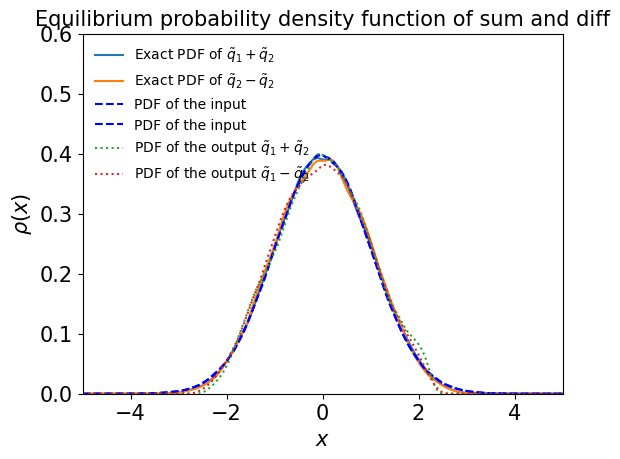

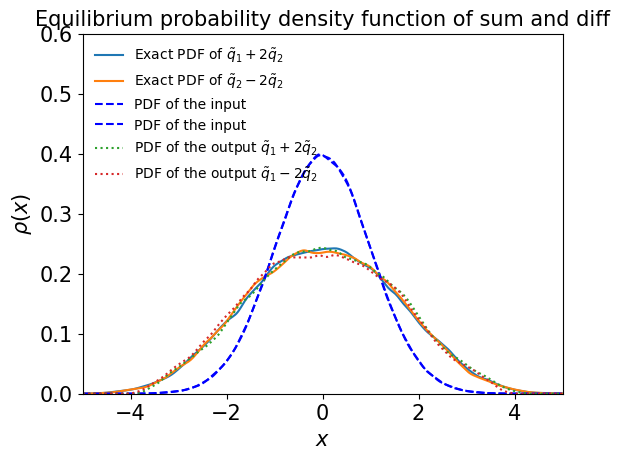

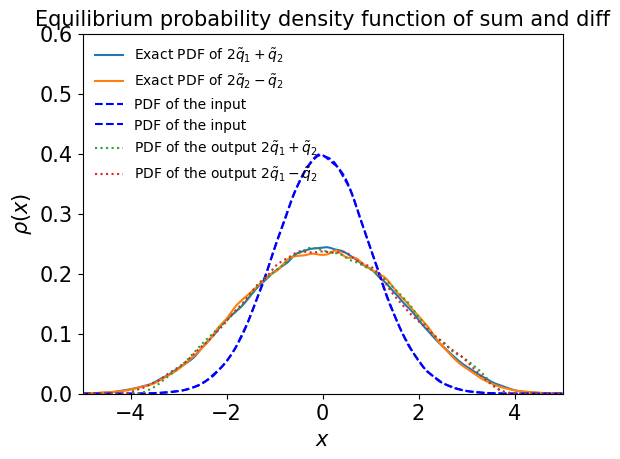

In [132]:
test3(model8)

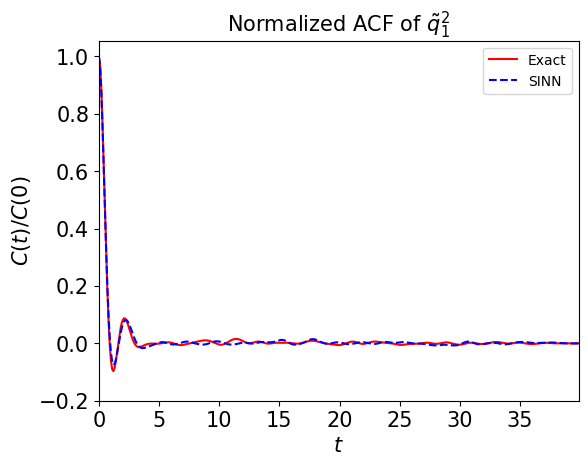

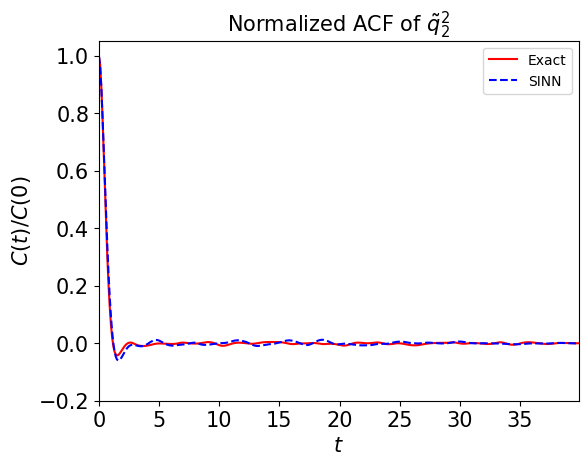

In [133]:
test4(model8)

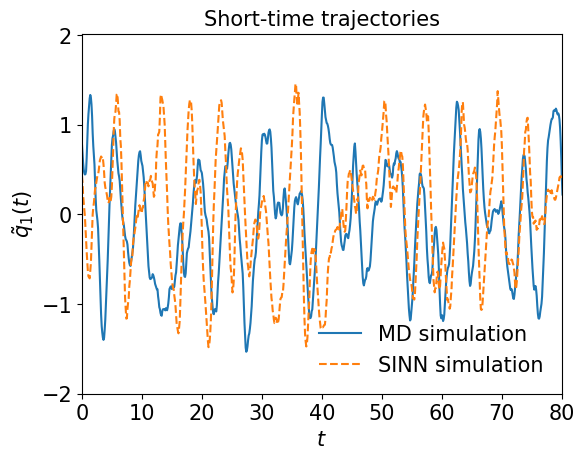

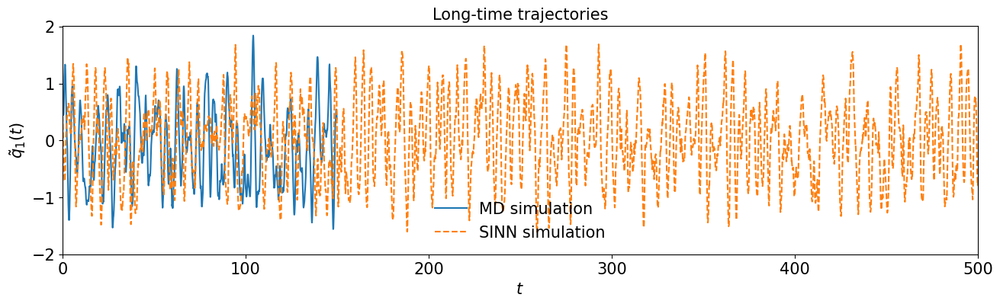

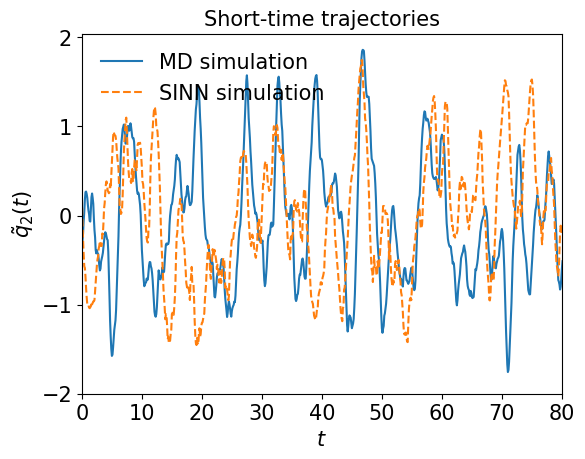

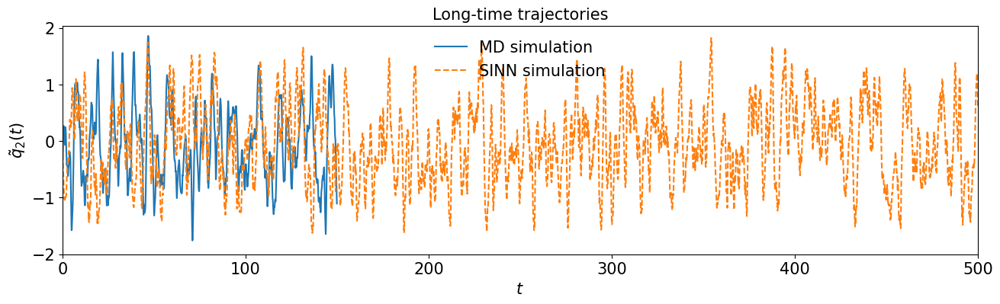

In [134]:
test5(model8)

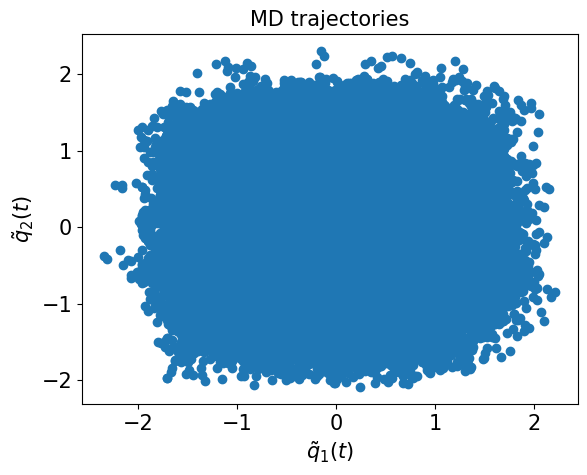

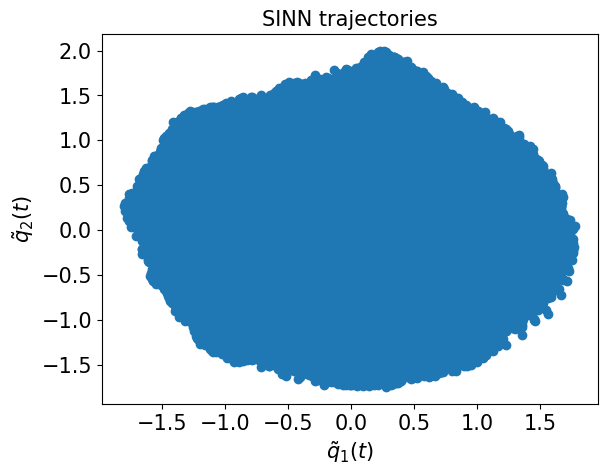

In [135]:
test6(model8)

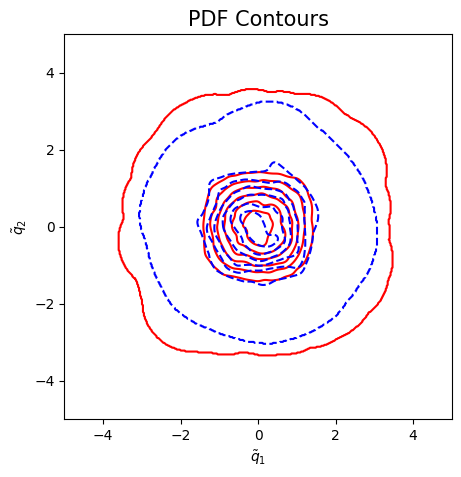

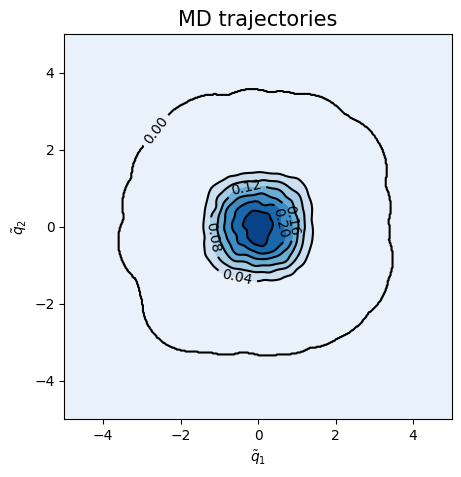

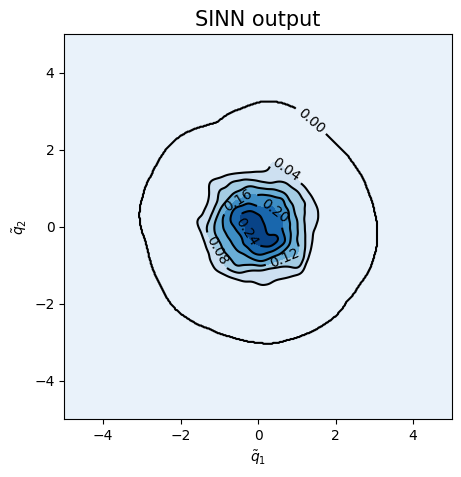

<Figure size 500x500 with 0 Axes>

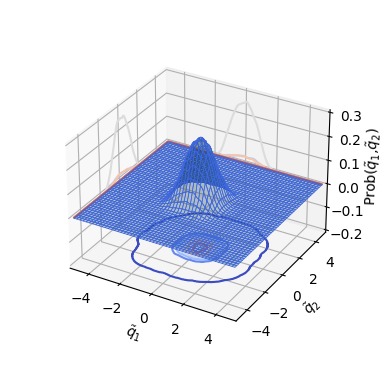

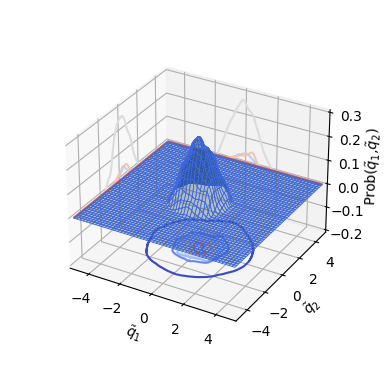

In [136]:
test7(model8)

In [137]:
### Defining SINN model
net9 = SINN(2, 10, 2, 2).to(device)

In [138]:
model9 = Model(net=net9)

In [139]:
model9.train()

[0]-th step loss: 0.5329, 0.5318, acf: 0.00934, ccf: 0.00334, pdf: 0.24802, pdf2: 0.26859, acf2: 0.00250
[50]-th step loss: 0.3002, 0.2898, acf: 0.00504, ccf: 0.00533, pdf: 0.15785, pdf2: 0.12101, acf2: 0.00056
[100]-th step loss: 0.0294, 0.0289, acf: 0.00186, ccf: 0.00928, pdf: 0.00707, pdf2: 0.00973, acf2: 0.00095
[150]-th step loss: 0.0076, 0.0075, acf: 0.00161, ccf: 0.00165, pdf: 0.00120, pdf2: 0.00267, acf2: 0.00041
[200]-th step loss: 0.0057, 0.0056, acf: 0.00161, ccf: 0.00074, pdf: 0.00082, pdf2: 0.00204, acf2: 0.00038
[250]-th step loss: 0.0042, 0.0042, acf: 0.00142, ccf: 0.00027, pdf: 0.00064, pdf2: 0.00154, acf2: 0.00034
[300]-th step loss: 0.0031, 0.0032, acf: 0.00121, ccf: 0.00011, pdf: 0.00050, pdf2: 0.00104, acf2: 0.00032
[350]-th step loss: 0.0023, 0.0024, acf: 0.00097, ccf: 0.00008, pdf: 0.00036, pdf2: 0.00068, acf2: 0.00032
[400]-th step loss: 0.0016, 0.0018, acf: 0.00069, ccf: 0.00008, pdf: 0.00029, pdf2: 0.00045, acf2: 0.00031
[450]-th step loss: 0.0011, 0.0013, acf:

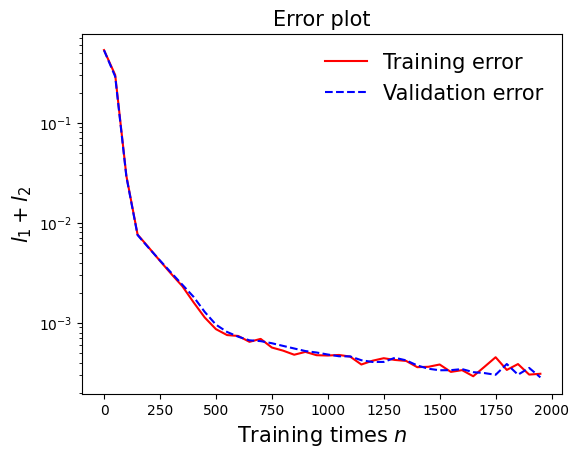

In [140]:
draw_loss(model9)

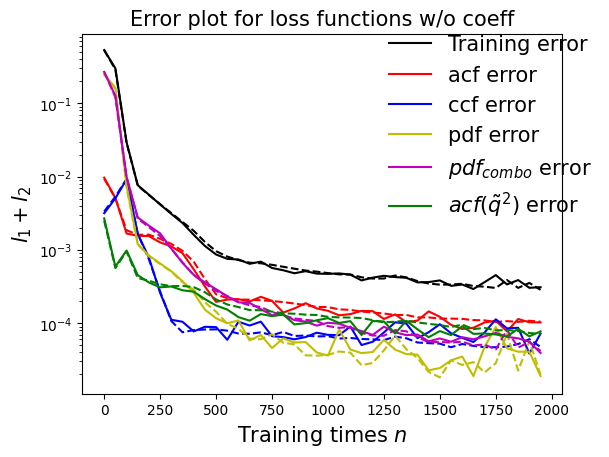

In [141]:
draw_errors(model9)

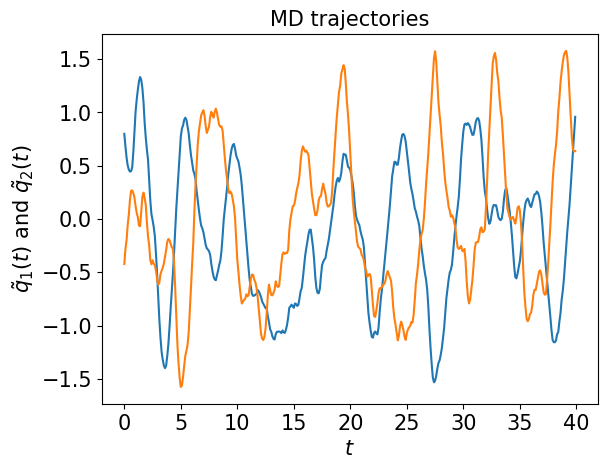

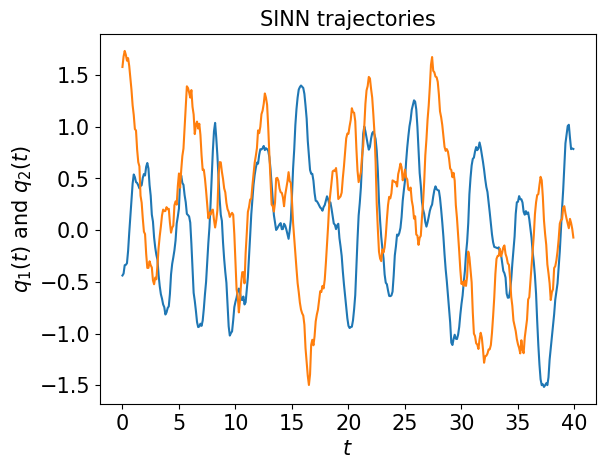

In [142]:
test1(model9)

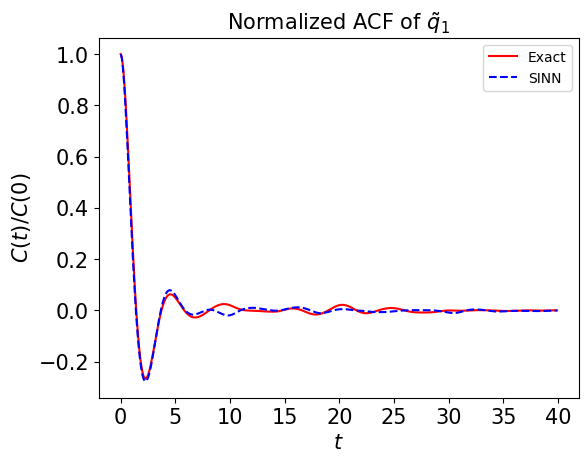

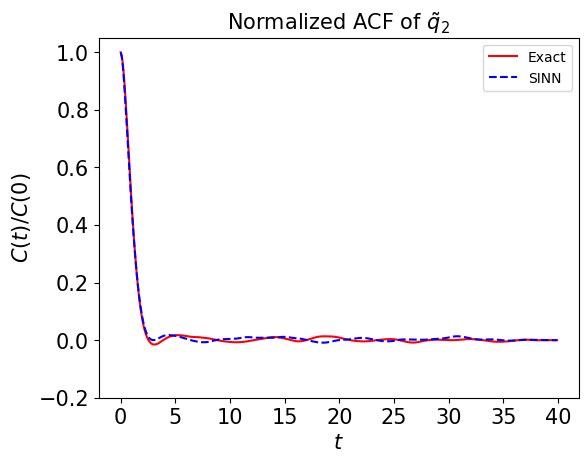

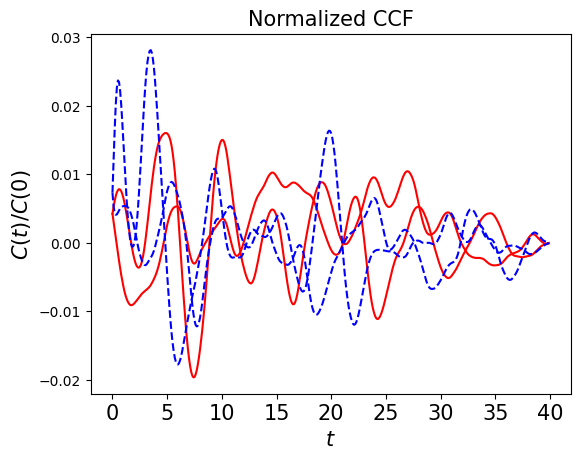

In [143]:
test2(model9)

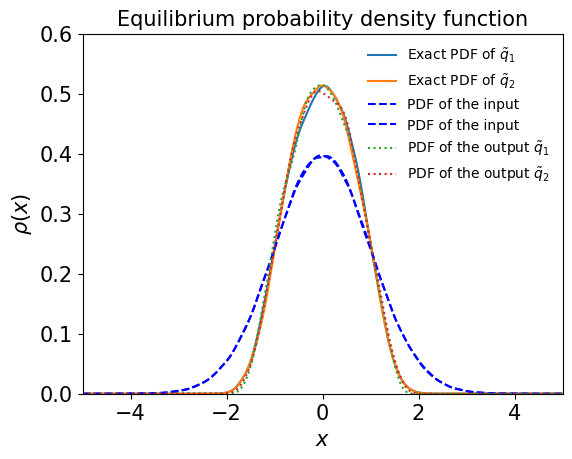

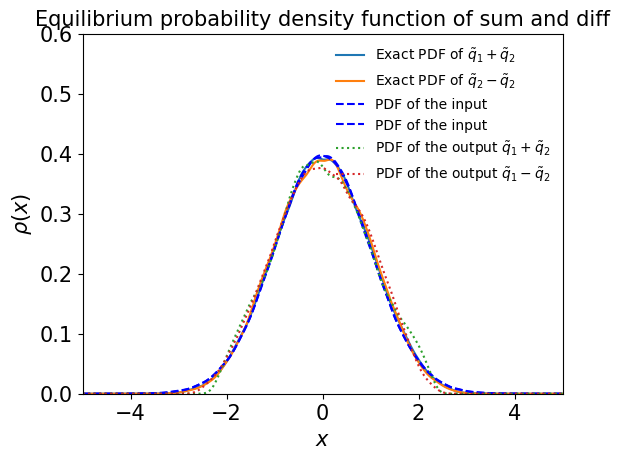

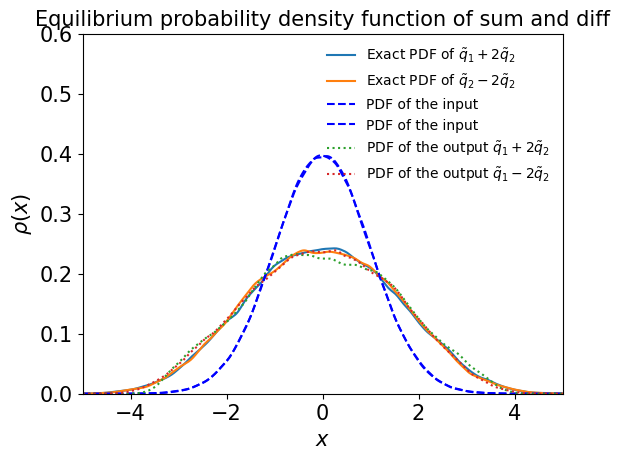

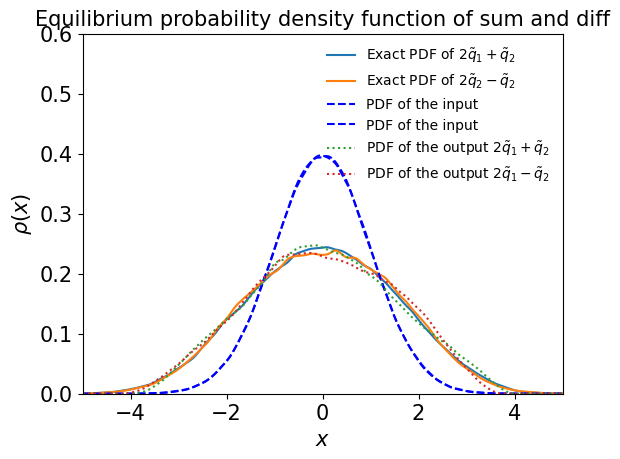

In [144]:
test3(model9)

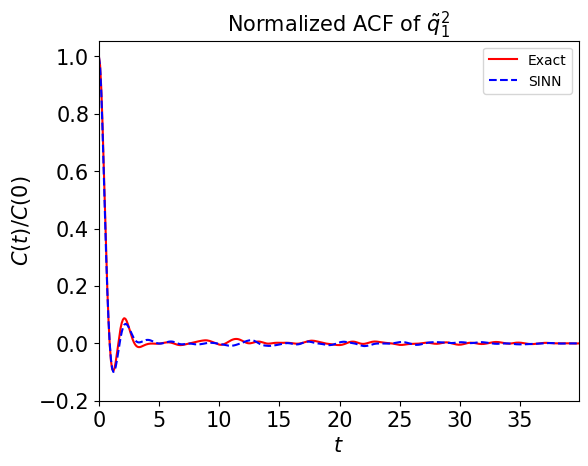

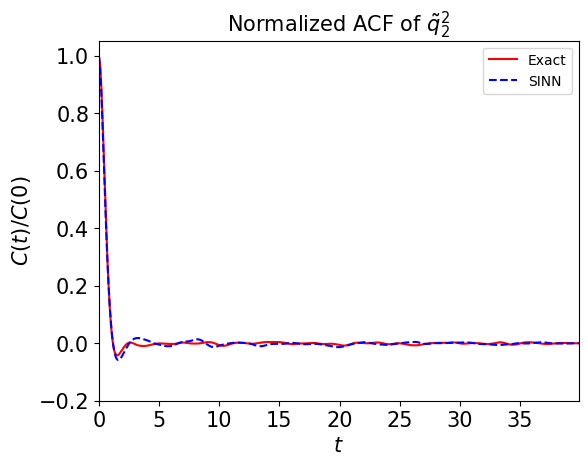

In [145]:
test4(model9)

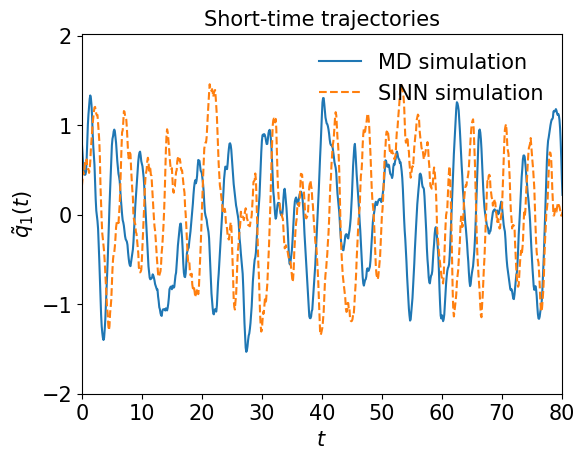

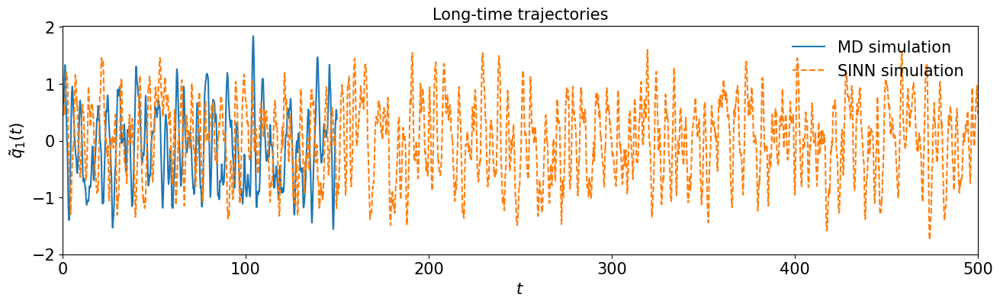

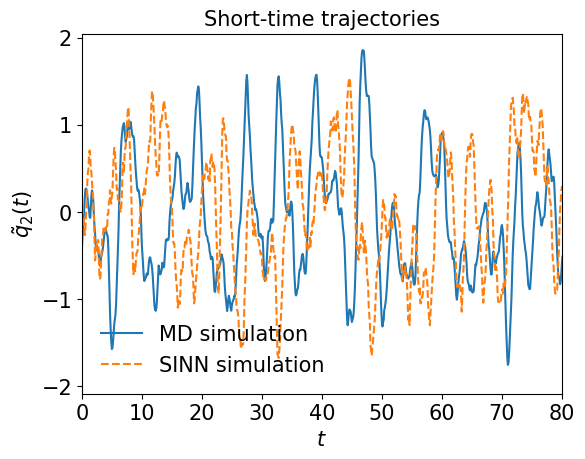

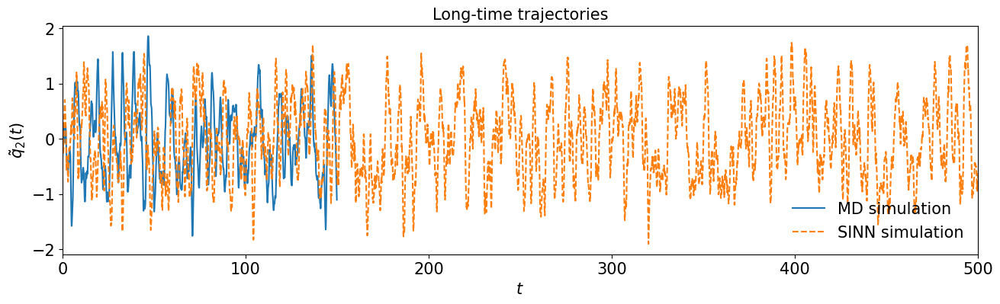

In [146]:
test5(model9)

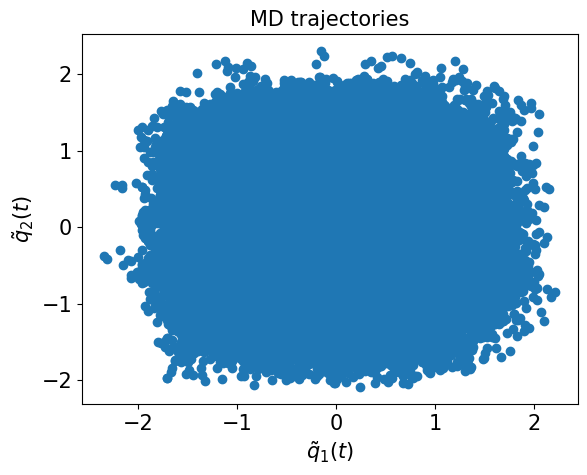

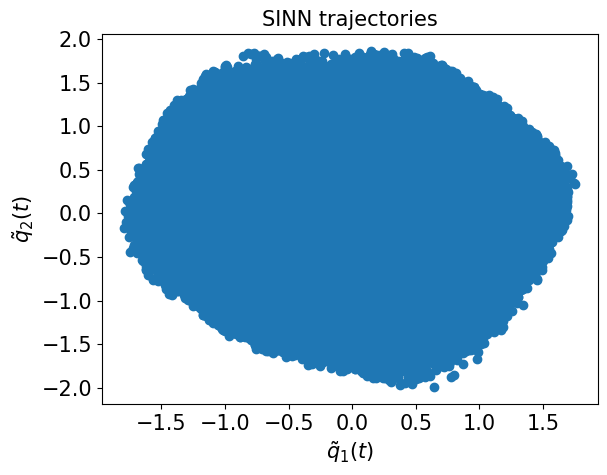

In [147]:
test6(model9)

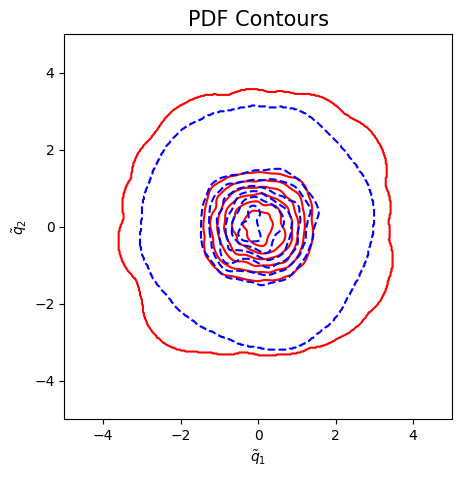

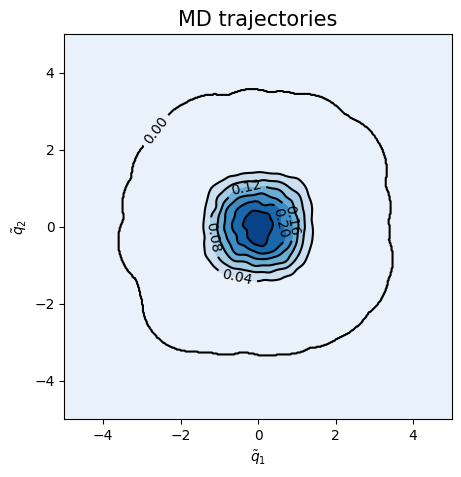

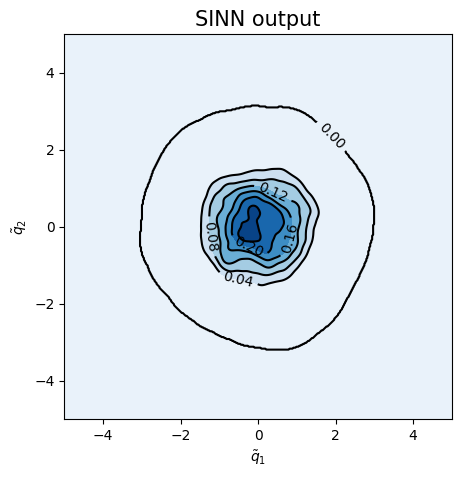

<Figure size 500x500 with 0 Axes>

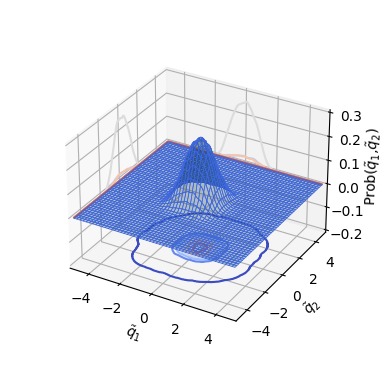

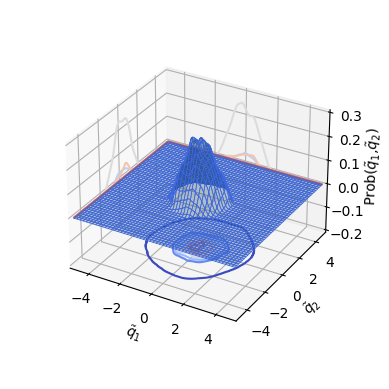

In [148]:
test7(model9)

In [149]:
### Defining SINN model
net10 = SINN(2, 10, 2, 2).to(device)

In [150]:
model10 = Model(net=net10)

In [151]:
model10.train()

[0]-th step loss: 0.5351, 0.5335, acf: 0.01138, ccf: 0.00126, pdf: 0.24830, pdf2: 0.26879, acf2: 0.00378
[50]-th step loss: 0.2329, 0.2219, acf: 0.00254, ccf: 0.00920, pdf: 0.12144, pdf2: 0.08815, acf2: 0.00059
[100]-th step loss: 0.0554, 0.0553, acf: 0.00260, ccf: 0.01724, pdf: 0.00898, pdf2: 0.02608, acf2: 0.00037
[150]-th step loss: 0.0367, 0.0364, acf: 0.00209, ccf: 0.01295, pdf: 0.00494, pdf2: 0.01610, acf2: 0.00036
[200]-th step loss: 0.0115, 0.0110, acf: 0.00353, ccf: 0.00177, pdf: 0.00262, pdf2: 0.00263, acf2: 0.00040
[250]-th step loss: 0.0059, 0.0060, acf: 0.00201, ccf: 0.00079, pdf: 0.00103, pdf2: 0.00193, acf2: 0.00028
[300]-th step loss: 0.0044, 0.0044, acf: 0.00152, ccf: 0.00045, pdf: 0.00068, pdf2: 0.00151, acf2: 0.00027
[350]-th step loss: 0.0036, 0.0035, acf: 0.00121, ccf: 0.00031, pdf: 0.00054, pdf2: 0.00119, acf2: 0.00027
[400]-th step loss: 0.0028, 0.0028, acf: 0.00093, ccf: 0.00026, pdf: 0.00043, pdf2: 0.00096, acf2: 0.00026
[450]-th step loss: 0.0022, 0.0023, acf:

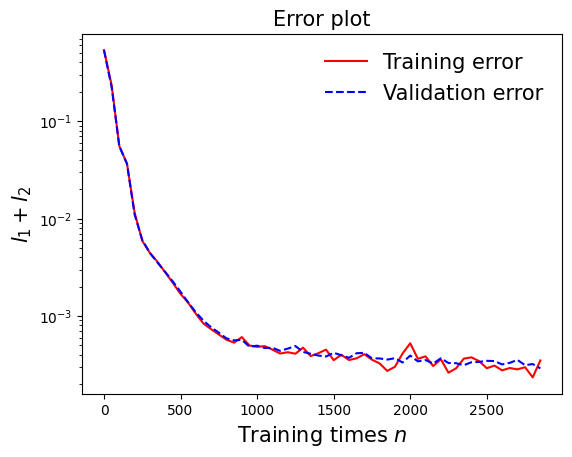

In [152]:
draw_loss(model10)

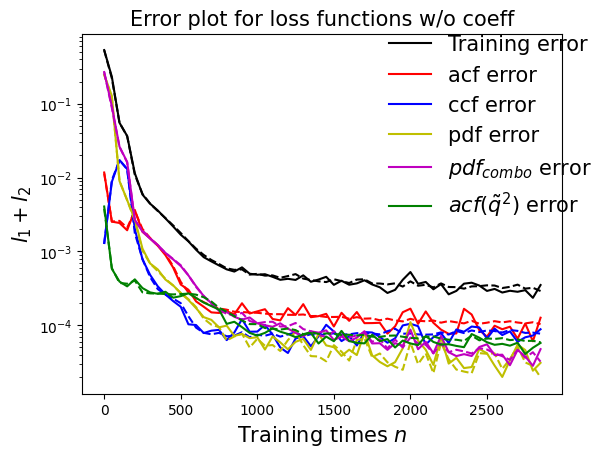

In [153]:
draw_errors(model10)

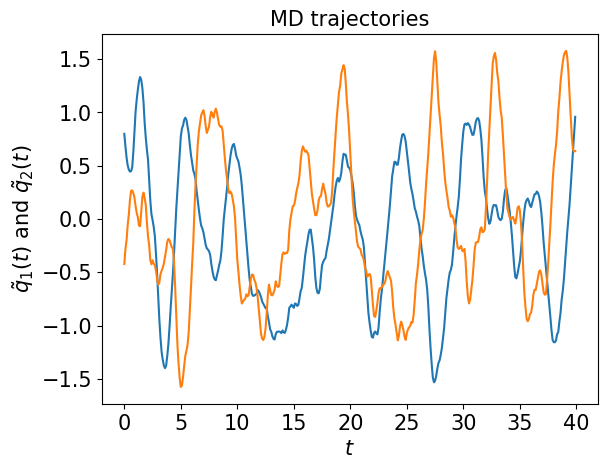

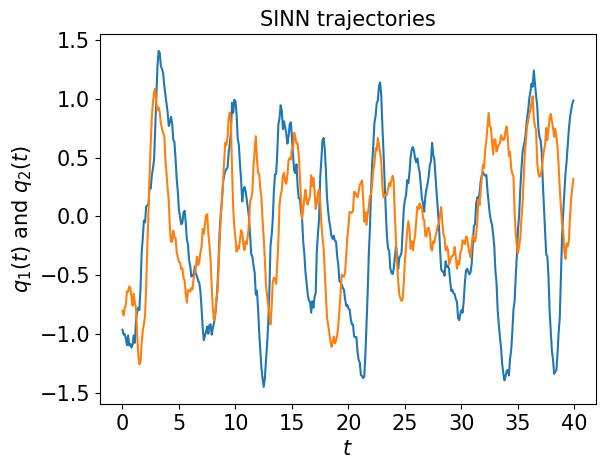

In [154]:
test1(model10)

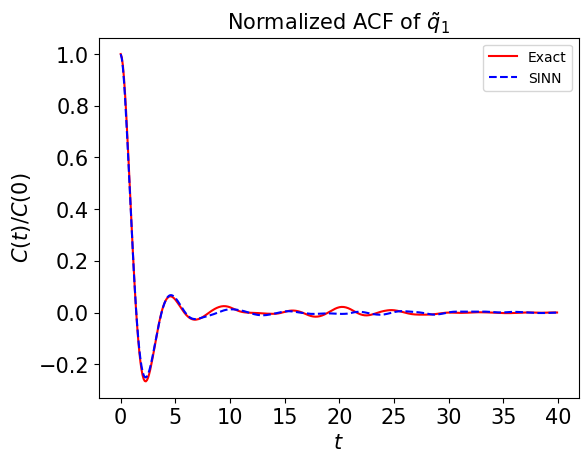

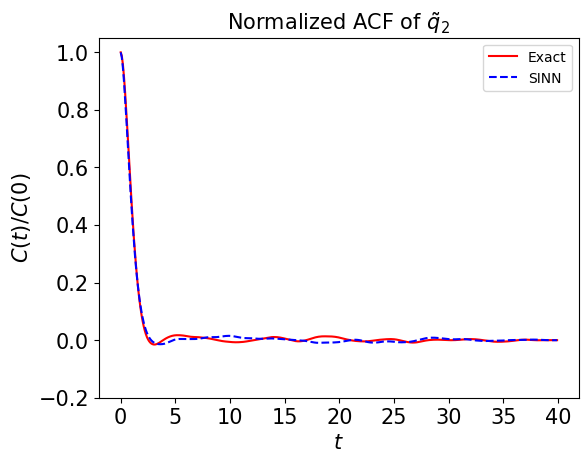

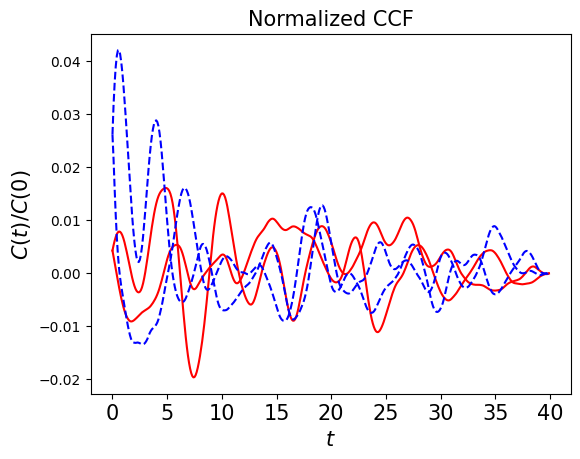

In [155]:
test2(model10)

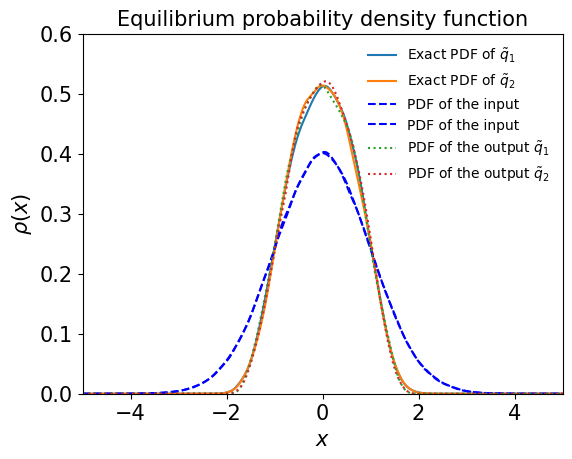

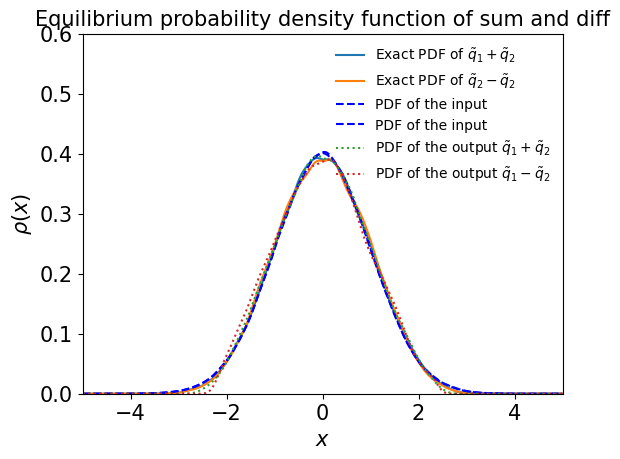

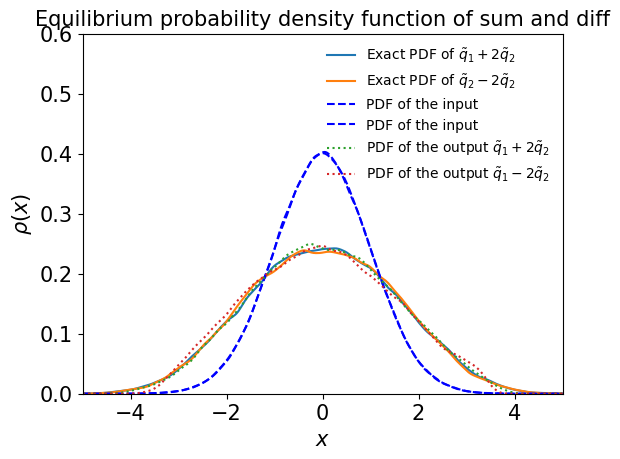

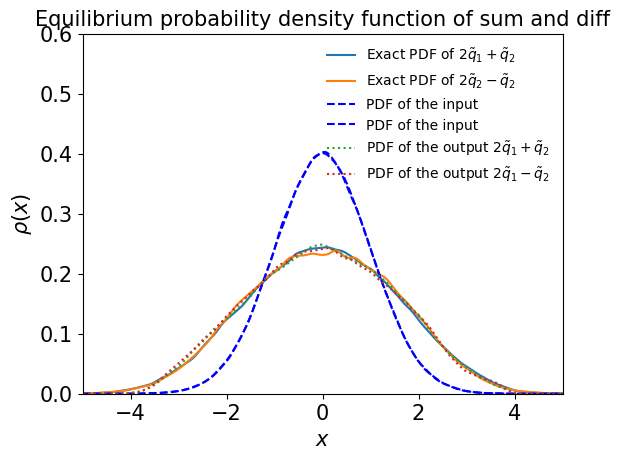

In [156]:
test3(model10)

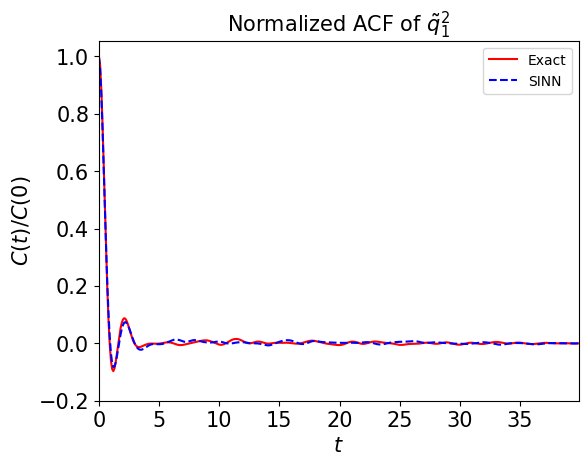

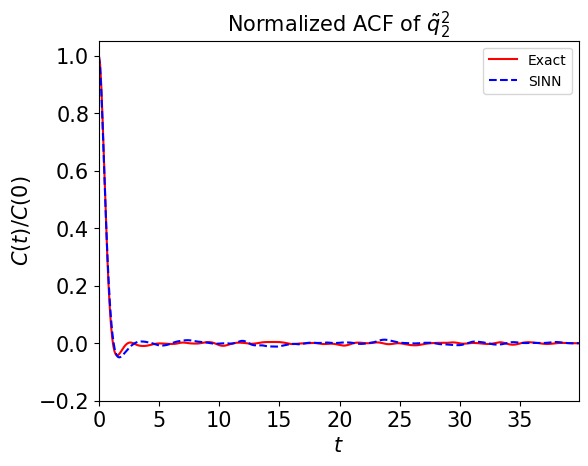

In [157]:
test4(model10)

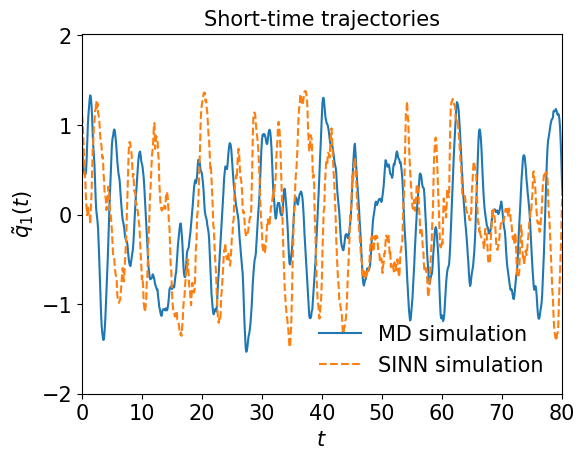

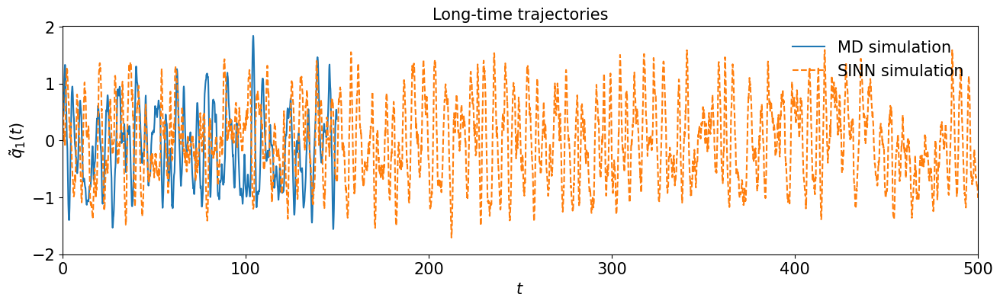

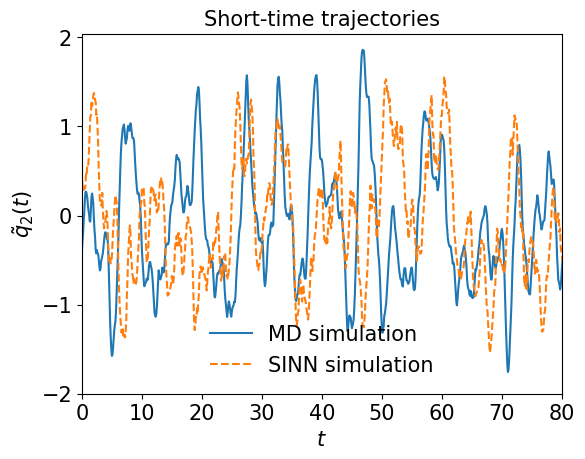

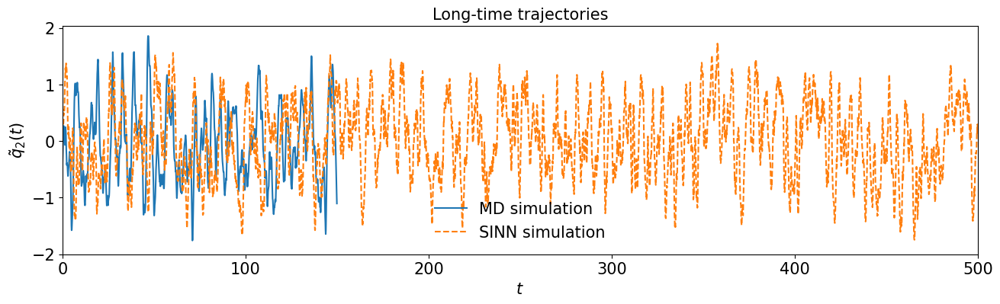

In [158]:
test5(model10)

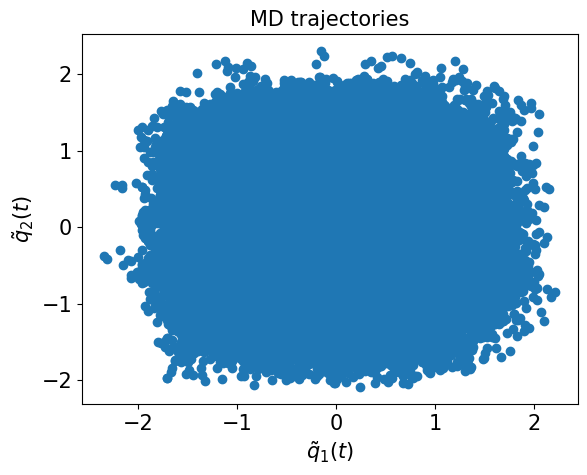

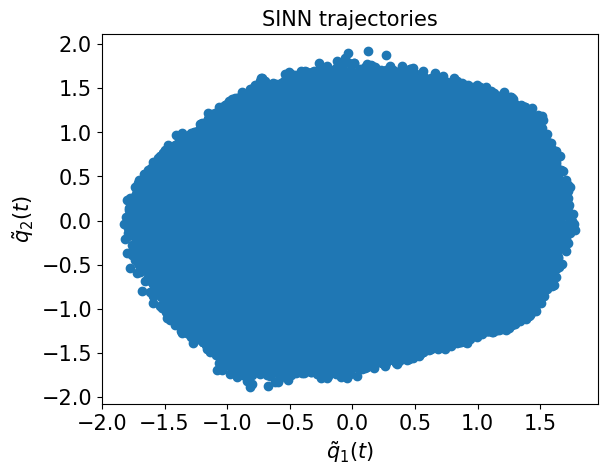

In [159]:
test6(model10)

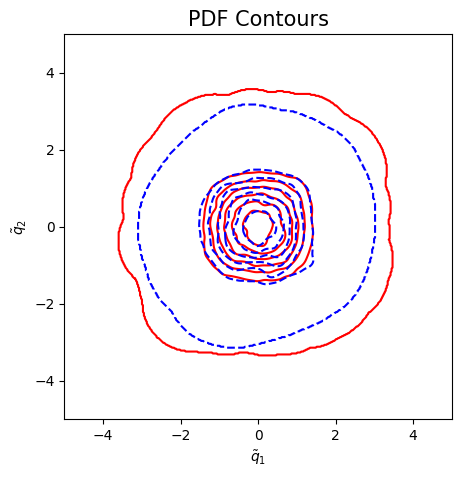

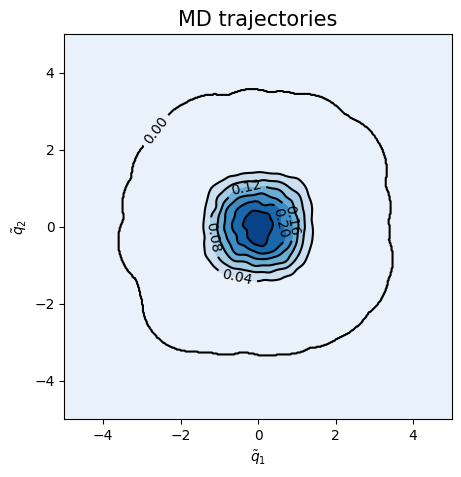

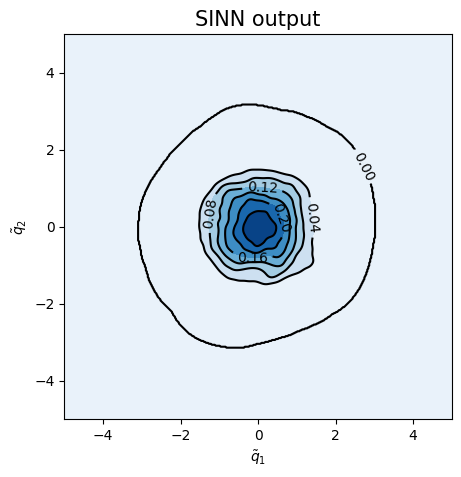

<Figure size 500x500 with 0 Axes>

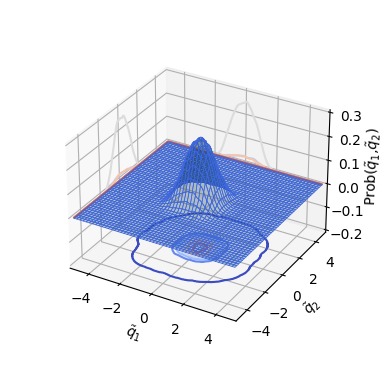

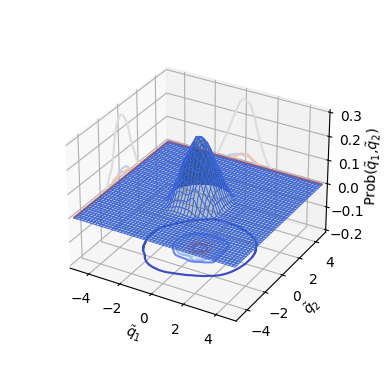

In [160]:
test7(model10)

In [161]:
### Defining SINN model
net11 = SINN(2, 10, 2, 2).to(device)
model11 = Model(net=net11)

In [162]:
model11.train()

[0]-th step loss: 0.5218, 0.5201, acf: 0.00603, ccf: 0.00254, pdf: 0.24523, pdf2: 0.26551, acf2: 0.00081
[50]-th step loss: 0.1865, 0.1784, acf: 0.00232, ccf: 0.00554, pdf: 0.10465, pdf2: 0.06522, acf2: 0.00068
[100]-th step loss: 0.0202, 0.0199, acf: 0.00246, ccf: 0.00197, pdf: 0.00912, pdf2: 0.00488, acf2: 0.00145
[150]-th step loss: 0.0086, 0.0085, acf: 0.00221, ccf: 0.00039, pdf: 0.00298, pdf2: 0.00242, acf2: 0.00052
[200]-th step loss: 0.0060, 0.0061, acf: 0.00187, ccf: 0.00022, pdf: 0.00165, pdf2: 0.00198, acf2: 0.00035
[250]-th step loss: 0.0052, 0.0050, acf: 0.00171, ccf: 0.00013, pdf: 0.00112, pdf2: 0.00169, acf2: 0.00030
[300]-th step loss: 0.0043, 0.0043, acf: 0.00164, ccf: 0.00010, pdf: 0.00082, pdf2: 0.00147, acf2: 0.00030
[350]-th step loss: 0.0038, 0.0039, acf: 0.00161, ccf: 0.00009, pdf: 0.00063, pdf2: 0.00129, acf2: 0.00030
[400]-th step loss: 0.0034, 0.0036, acf: 0.00160, ccf: 0.00009, pdf: 0.00048, pdf2: 0.00115, acf2: 0.00031
[450]-th step loss: 0.0033, 0.0034, acf:

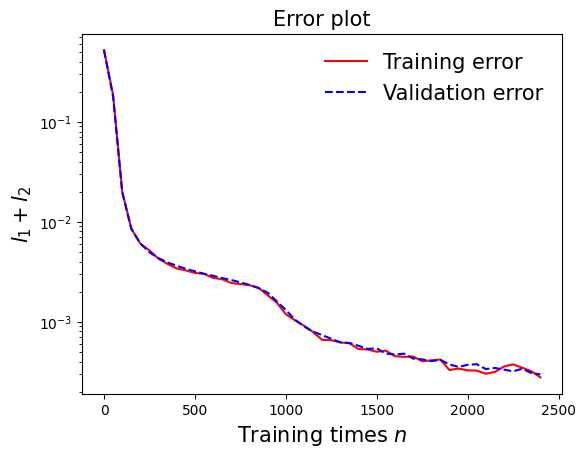

In [163]:
draw_loss(model11)

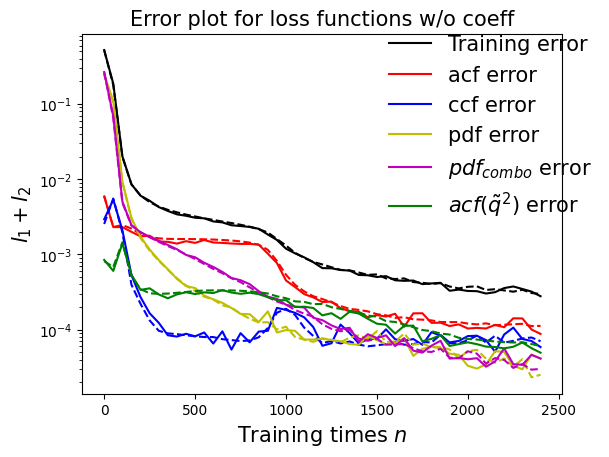

In [164]:
draw_errors(model11)

In [165]:
### Defining SINN model
net12 = SINN(2, 10, 2, 2).to(device)
model12 = Model(net=net12)
model12.train()

[0]-th step loss: 0.5379, 0.5368, acf: 0.01070, ccf: 0.00187, pdf: 0.24846, pdf2: 0.27246, acf2: 0.00328
[50]-th step loss: 0.2864, 0.2744, acf: 0.00255, ccf: 0.00824, pdf: 0.15025, pdf2: 0.11289, acf2: 0.00048
[100]-th step loss: 0.0508, 0.0497, acf: 0.00170, ccf: 0.01514, pdf: 0.01174, pdf2: 0.02062, acf2: 0.00045
[150]-th step loss: 0.0100, 0.0102, acf: 0.00192, ccf: 0.00186, pdf: 0.00234, pdf2: 0.00328, acf2: 0.00075
[200]-th step loss: 0.0057, 0.0057, acf: 0.00111, ccf: 0.00091, pdf: 0.00114, pdf2: 0.00219, acf2: 0.00037
[250]-th step loss: 0.0040, 0.0039, acf: 0.00071, ccf: 0.00060, pdf: 0.00078, pdf2: 0.00155, acf2: 0.00031
[300]-th step loss: 0.0027, 0.0026, acf: 0.00038, ccf: 0.00028, pdf: 0.00060, pdf2: 0.00108, acf2: 0.00026
[350]-th step loss: 0.0017, 0.0017, acf: 0.00017, ccf: 0.00012, pdf: 0.00047, pdf2: 0.00069, acf2: 0.00020
[400]-th step loss: 0.0013, 0.0013, acf: 0.00015, ccf: 0.00012, pdf: 0.00036, pdf2: 0.00054, acf2: 0.00016
[450]-th step loss: 0.0012, 0.0011, acf:

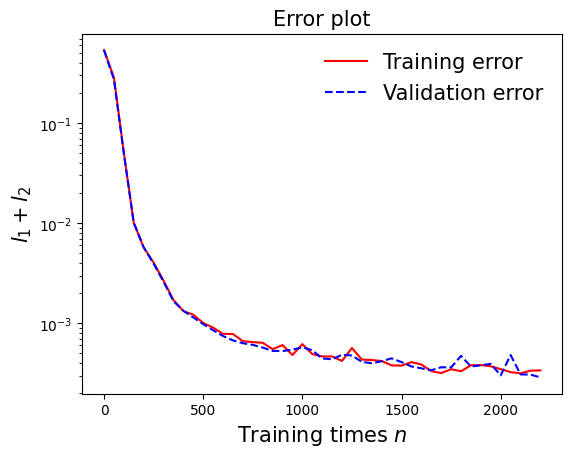

In [166]:
draw_loss(model12)

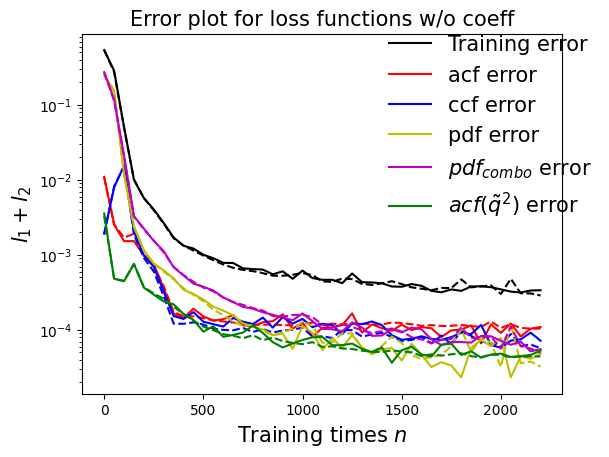

In [167]:
draw_errors(model12)

In [168]:
### Defining SINN model
net13 = SINN(2, 10, 2, 2).to(device)
model13 = Model(net=net13)
model13.train()

[0]-th step loss: 0.5303, 0.5288, acf: 0.01123, ccf: 0.00409, pdf: 0.24570, pdf2: 0.26409, acf2: 0.00366
[50]-th step loss: 0.2350, 0.2228, acf: 0.00495, ccf: 0.00759, pdf: 0.12561, pdf2: 0.08296, acf2: 0.00165
[100]-th step loss: 0.0558, 0.0548, acf: 0.00382, ccf: 0.01125, pdf: 0.01959, pdf2: 0.01850, acf2: 0.00166
[150]-th step loss: 0.0263, 0.0261, acf: 0.00507, ccf: 0.00679, pdf: 0.00444, pdf2: 0.00876, acf2: 0.00102
[200]-th step loss: 0.0194, 0.0191, acf: 0.00416, ccf: 0.00754, pdf: 0.00170, pdf2: 0.00475, acf2: 0.00099
[250]-th step loss: 0.0167, 0.0167, acf: 0.00405, ccf: 0.00770, pdf: 0.00136, pdf2: 0.00288, acf2: 0.00074
[300]-th step loss: 0.0146, 0.0145, acf: 0.00381, ccf: 0.00650, pdf: 0.00096, pdf2: 0.00243, acf2: 0.00077
[350]-th step loss: 0.0092, 0.0090, acf: 0.00212, ccf: 0.00338, pdf: 0.00127, pdf2: 0.00169, acf2: 0.00049
[400]-th step loss: 0.0057, 0.0058, acf: 0.00177, ccf: 0.00163, pdf: 0.00073, pdf2: 0.00123, acf2: 0.00040
[450]-th step loss: 0.0041, 0.0042, acf:

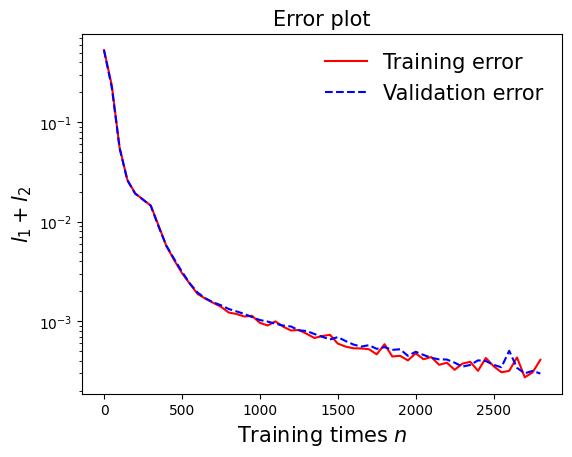

In [169]:
draw_loss(model13)

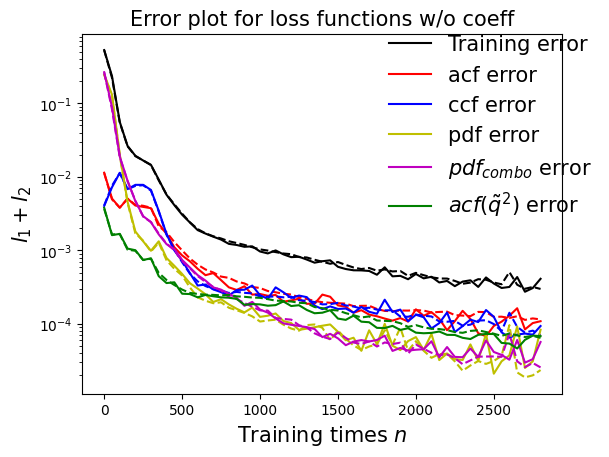

In [170]:
draw_errors(model13)

In [171]:
### Defining SINN model
net14 = SINN(2, 10, 2, 2).to(device)
model14 = Model(net=net14)
model14.train()

[0]-th step loss: 0.5289, 0.5271, acf: 0.00916, ccf: 0.00465, pdf: 0.24487, pdf2: 0.26603, acf2: 0.00236
[50]-th step loss: 0.1730, 0.1647, acf: 0.00229, ccf: 0.01302, pdf: 0.06471, pdf2: 0.08401, acf2: 0.00064
[100]-th step loss: 0.0580, 0.0576, acf: 0.00230, ccf: 0.01605, pdf: 0.00883, pdf2: 0.02994, acf2: 0.00049
[150]-th step loss: 0.0420, 0.0417, acf: 0.00301, ccf: 0.01236, pdf: 0.00416, pdf2: 0.02139, acf2: 0.00077
[200]-th step loss: 0.0309, 0.0304, acf: 0.00417, ccf: 0.01233, pdf: 0.00250, pdf2: 0.01072, acf2: 0.00068
[250]-th step loss: 0.0245, 0.0243, acf: 0.00257, ccf: 0.01120, pdf: 0.00218, pdf2: 0.00789, acf2: 0.00048
[300]-th step loss: 0.0194, 0.0194, acf: 0.00169, ccf: 0.00985, pdf: 0.00171, pdf2: 0.00548, acf2: 0.00068
[350]-th step loss: 0.0166, 0.0166, acf: 0.00223, ccf: 0.00861, pdf: 0.00118, pdf2: 0.00382, acf2: 0.00077
[400]-th step loss: 0.0152, 0.0152, acf: 0.00249, ccf: 0.00803, pdf: 0.00108, pdf2: 0.00291, acf2: 0.00072
[450]-th step loss: 0.0136, 0.0132, acf:

[3850]-th step loss: 0.0005, 0.0005, acf: 0.00014, ccf: 0.00012, pdf: 0.00004, pdf2: 0.00008, acf2: 0.00014
[3900]-th step loss: 0.0005, 0.0005, acf: 0.00014, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00008, acf2: 0.00013
[3950]-th step loss: 0.0005, 0.0005, acf: 0.00014, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00008, acf2: 0.00014
[4000]-th step loss: 0.0004, 0.0005, acf: 0.00014, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00007, acf2: 0.00013
[4050]-th step loss: 0.0004, 0.0005, acf: 0.00015, ccf: 0.00012, pdf: 0.00004, pdf2: 0.00007, acf2: 0.00013
[4100]-th step loss: 0.0005, 0.0005, acf: 0.00014, ccf: 0.00012, pdf: 0.00005, pdf2: 0.00007, acf2: 0.00012
[4150]-th step loss: 0.0005, 0.0005, acf: 0.00013, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00006, acf2: 0.00013
[4200]-th step loss: 0.0005, 0.0005, acf: 0.00013, ccf: 0.00012, pdf: 0.00004, pdf2: 0.00006, acf2: 0.00013
[4250]-th step loss: 0.0005, 0.0005, acf: 0.00014, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00006, acf2: 0.00014
[4300]-th step loss: 0.0005,

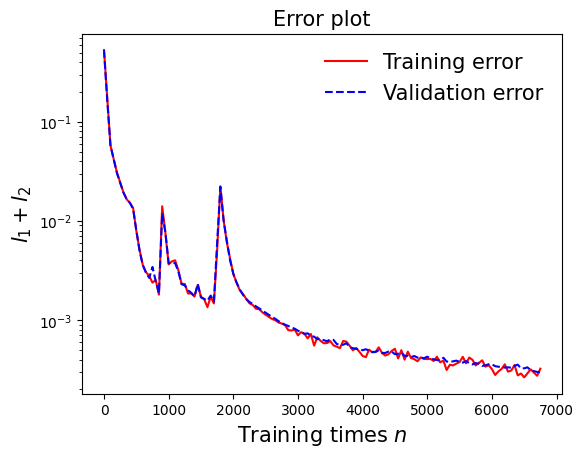

In [172]:
draw_loss(model14)

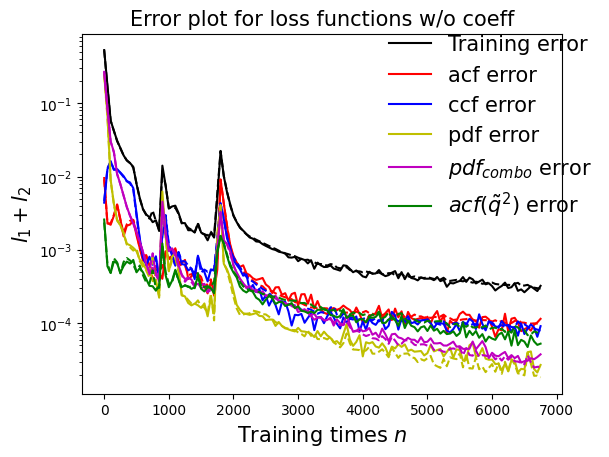

In [173]:
draw_errors(model14)

In [174]:
overhead = np.array([model.time, model1.time, model2.time, model3.time, model4.time, model5.time, model6.time, model7.time, model8.time, model9.time, model10.time, model11.time, model12.time, model13.time, model14.time])
iteration = np.array([model.iter, model1.iter, model2.iter, model3.iter, model4.iter, model5.iter, model6.iter, model7.iter, model8.iter, model9.iter, model10.iter, model11.iter, model12.iter, model13.iter, model14.iter])
np.savetxt('overhead_pair2_uncorr_baseline.txt', overhead, fmt='%1.2f')
np.savetxt('iter_pair2_uncorr_baseline.txt', iteration, fmt='%d')